In [1]:
from sklearn.externals import joblib
# joblib.dump(clf, 'model.pkl')



# Upload train_data
from google.colab import files
api_token = files.upload()

/usr/local/lib/python3.7/dist-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


Saving train.csv to train.csv


In [2]:
from google.colab import files


# Upload test_data

api_token = files.upload()

Saving test.csv to test.csv


In [3]:
# Upload tokenization.py

from google.colab import files
api_token = files.upload()

Saving tokenization.py to tokenization.py


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import pandas as pd

data=pd.read_csv('/content/train.csv')
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping
0,"Was walking along crowded street, holding mums...",0,0,1
1,This incident took place in the evening.I was ...,0,1,0
2,I WAS WAITING FOR THE BUS. A MAN CAME ON A BIK...,1,0,0
3,Incident happened inside the train,0,0,0
4,I witnessed an incident when a chain was bruta...,0,0,0
...,...,...,...,...
7196,There was this person near a construction site...,0,1,0
7197,He threatened me by making inappropriate conve...,1,0,0
7198,happened during morning at university metro st...,1,0,0
7199,one day my aunt was returniec frm office .. sh...,0,0,0


In [6]:
import pandas as pd

data_test=pd.read_csv('/content/test.csv')
data_test

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping
0,"During morning, a woman was walking by and thi...",1,1,0
1,A man tried to brush his penis off of a woman'...,0,0,1
2,This happened to a fellow passenger of mine tr...,0,1,0
3,ogling,0,1,0
4,When I was returning my home after finishing m...,0,0,1
...,...,...,...,...
1696,obscene comments and staring,1,0,0
1697,I was going with my friend In metro in morning...,1,0,1
1698,A person tried to grab me when I was walkng in...,0,0,1
1699,few bad people touched my private parts in Ran...,0,0,1


Drop duplicates

In [7]:
import pandas as pd

data.drop_duplicates(inplace = True)

In [8]:
import pandas as pd

data_test.drop_duplicates(inplace = True)

Reset the index in dataframe 

In [9]:
data.reset_index(drop=True)

data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping
0,"Was walking along crowded street, holding mums...",0,0,1
1,This incident took place in the evening.I was ...,0,1,0
2,I WAS WAITING FOR THE BUS. A MAN CAME ON A BIK...,1,0,0
3,Incident happened inside the train,0,0,0
4,I witnessed an incident when a chain was bruta...,0,0,0
...,...,...,...,...
7196,There was this person near a construction site...,0,1,0
7197,He threatened me by making inappropriate conve...,1,0,0
7198,happened during morning at university metro st...,1,0,0
7199,one day my aunt was returniec frm office .. sh...,0,0,0


In [10]:
data_test.reset_index(drop=True)

data_test

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping
0,"During morning, a woman was walking by and thi...",1,1,0
1,A man tried to brush his penis off of a woman'...,0,0,1
2,This happened to a fellow passenger of mine tr...,0,1,0
3,ogling,0,1,0
4,When I was returning my home after finishing m...,0,0,1
...,...,...,...,...
1696,obscene comments and staring,1,0,0
1697,I was going with my friend In metro in morning...,1,0,1
1698,A person tried to grab me when I was walkng in...,0,0,1
1699,few bad people touched my private parts in Ran...,0,0,1


Correct the spelling by using autocorrect

In [11]:
!pip install autocorrect
from autocorrect import Speller

spell = Speller(lang='en')



data['Description']=data['Description'].apply(spell)



     |████████████████████████████████| 622 kB 12.7 MB/s 
  Created wheel for autocorrect: filename=autocorrect-2.5.0-py3-none-any.whl size=621851 sha256=ab5d693ba5b094d20293268840bcc9540410c58267bd89eff5ff41499406945d
  Stored in directory: /root/.cache/pip/wheels/3d/8e/bd/f6fd900a056a031bf710a00bca338d86f43b83f0c25ab5242f
Successfully built autocorrect


In [12]:
x='sddff'
type(x)

str

In [13]:
!pip install autocorrect
from autocorrect import Speller

spell = Speller(lang='en')



data_test['Description']=data_test['Description'].apply(spell)



Preprocessing

In [14]:
import re
def decontractions(phrase):
    """decontracted takes text and convert contractions into natural form.
     ref: https://stackoverflow.com/questions/19790188/expanding-english-language-contractions-in-python/47091490#47091490"""
    # specific
    phrase = re.sub(r"won\'t", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)
    phrase = re.sub(r"won\’t", "will not", phrase)
    phrase = re.sub(r"can\’t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)

    phrase = re.sub(r"n\’t", " not", phrase)
    phrase = re.sub(r"\’re", " are", phrase)
    phrase = re.sub(r"\’s", " is", phrase)
    phrase = re.sub(r"\’d", " would", phrase)
    phrase = re.sub(r"\’ll", " will", phrase)
    phrase = re.sub(r"\’t", " not", phrase)
    phrase = re.sub(r"\’ve", " have", phrase)
    phrase = re.sub(r"\’m", " am", phrase)
   

    return phrase

def preprocess(text):
    # convert all the text into lower letters
    # use this function to remove the contractions: https://gist.github.com/anandborad/d410a49a493b56dace4f814ab5325bbd
    # remove all the spacial characters: except space ' '
    text = text.lower()
    text = decontractions(text)
    text = re.sub('[^A-Za-z ]+', ' ', text)
    
    return text




data['Description'] = data['Description'].apply(preprocess)
data_test['Description'] = data_test['Description'].apply(preprocess)


In [15]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping
0,was walking along crowded street holding sums...,0,0,1
1,this incident took place in the evening i was ...,0,1,0
2,i as waiting or the us a an cam of a be and a...,1,0,0
3,incident happened inside the train,0,0,0
4,i witnessed an incident when a chain was bruta...,0,0,0
...,...,...,...,...
7196,there was this person near a construction site...,0,1,0
7197,he threatened me by making inappropriate conve...,1,0,0
7198,happened during morning at university metro st...,1,0,0
7199,one day my aunt was returned frm office haun...,0,0,0


Remove stop words and lower them 

In [16]:
import nltk
nltk.download('stopwords')

from nltk.corpus import stopwords
stop = stopwords.words('english')

data["Removed_stop_words"] = data["Description"].str.lower().str.split()

data['Removed_stop_words']=data['Removed_stop_words'].apply(lambda x: [item for item in x if item not in stop])





data_test["Removed_stop_words"] = data_test["Description"].str.lower().str.split()

data_test['Removed_stop_words']=data_test['Removed_stop_words'].apply(lambda x: [item for item in x if item not in stop])

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [17]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum..."
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g..."
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]"
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]"
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche..."
...,...,...,...,...,...
7196,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l..."
7197,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati..."
7198,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station..."
7199,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,..."


Stemming the text data

In [18]:
from nltk.stem.snowball import SnowballStemmer

# Use English stemmer.
stemmer = SnowballStemmer("english")


data['stemed']=data['Removed_stop_words'].apply(lambda x: [stemmer.stem(y) for y in x]) 

data_test['stemed']=data_test['Removed_stop_words'].apply(lambda x: [stemmer.stem(y) for y in x]) 

# data['stemed']=data['Removed_stop_words']

In [19]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...","[walk, along, crowd, street, hold, sum, hand, ..."
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...","[incid, took, place, even, metro, two, guy, st..."
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]","[wait, us, cam, offer, liftvto, young, irl]"
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]","[incid, happen, insid, train]"
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...","[wit, incid, chain, brutal, snatch, elder, lad..."
...,...,...,...,...,...,...
7196,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...","[person, near, construct, site, probabl, labor..."
7197,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...","[threaten, make, inappropri, convers, threaten..."
7198,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...","[happen, morn, univers, metro, station, guy, c..."
7199,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...","[one, day, aunt, return, frm, offic, haunt, e,..."


Lemmatization

In [20]:
import nltk
nltk.download('wordnet')


w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
lemmatizer = nltk.stem.WordNetLemmatizer()

def lemmatize_text(text):
    return [lemmatizer.lemmatize(w) for w in text]

data['text_lemmatized'] = data['Removed_stop_words'].apply(lemmatize_text)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


In [21]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed,text_lemmatized
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...","[walk, along, crowd, street, hold, sum, hand, ...","[walking, along, crowded, street, holding, sum..."
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...","[incid, took, place, even, metro, two, guy, st...","[incident, took, place, evening, metro, two, g..."
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]","[wait, us, cam, offer, liftvto, young, irl]","[waiting, u, cam, offering, liftvto, young, irl]"
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]","[incid, happen, insid, train]","[incident, happened, inside, train]"
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...","[wit, incid, chain, brutal, snatch, elder, lad...","[witnessed, incident, chain, brutally, snatche..."
...,...,...,...,...,...,...,...
7196,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...","[person, near, construct, site, probabl, labor...","[person, near, construction, site, probably, l..."
7197,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...","[threaten, make, inappropri, convers, threaten...","[threatened, making, inappropriate, conversati..."
7198,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...","[happen, morn, univers, metro, station, guy, c...","[happened, morning, university, metro, station..."
7199,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...","[one, day, aunt, return, frm, offic, haunt, e,...","[one, day, aunt, returned, frm, office, haunt,..."


In [22]:
data['Description'][0]

'was walking along crowded street  holding sums hand  when an elderly man grouped butt  i turned to look at h m and he looked away  and did it again after a while i was   yrs old then '

In [23]:
data_test

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed
0,during morning a woman was walking by and thi...,1,1,0,"[morning, woman, walking, thin, guy, came, aro...","[morn, woman, walk, thin, guy, came, around, c..."
1,a man tried to brush his penis off of a woman ...,0,0,1,"[man, tried, brush, penis, woman, shoulder, bus]","[man, tri, brush, peni, woman, shoulder, bus]"
2,this happened to a fellow passenger of mine tr...,0,1,0,"[happened, fellow, passenger, mine, travelling...","[happen, fellow, passeng, mine, travel, metro,..."
3,online,0,1,0,[online],[onlin]
4,when i was returning my home after finishing m...,0,0,1,"[returning, home, finishing, class, queue, get...","[return, home, finish, class, queue, get, micr..."
...,...,...,...,...,...,...
1696,obscene comments and staring,1,0,0,"[obscene, comments, staring]","[obscen, comment, stare]"
1697,i was going with my friend in metro in morning...,1,0,1,"[going, friend, metro, morning, group, boys, s...","[go, friend, metro, morn, group, boy, start, c..."
1698,a person tried to grab me when i was walking i...,0,0,1,"[person, tried, grab, walking, railway, statio...","[person, tri, grab, walk, railway, station, st..."
1699,few bad people touched my private parts in ran...,0,0,1,"[bad, people, touched, private, parts, ranchib...","[bad, peopl, touch, privat, part, ranchibhagal..."


Joining the text and removing the digiths

In [24]:
data['stemed']=data['stemed'].apply(' '.join)
data['stemed'].str.replace('\d+', '')


data_test['stemed']=data_test['stemed'].apply(' '.join)
data_test['stemed'].str.replace('\d+', '')



0       morn woman walk thin guy came around call name...
1                   man tri brush peni woman shoulder bus
2       happen fellow passeng mine travel metro kick m...
3                                                   onlin
4       return home finish class queue get micro bus g...
                              ...                        
1696                                 obscen comment stare
1697    go friend metro morn group boy start comment t...
1698    person tri grab walk railway station station m...
1699    bad peopl touch privat part ranchibhagalpur ex...
1700                age yearstyp harass catcal leh market
Name: stemed, Length: 1640, dtype: object

Wordcloud for Stemed column

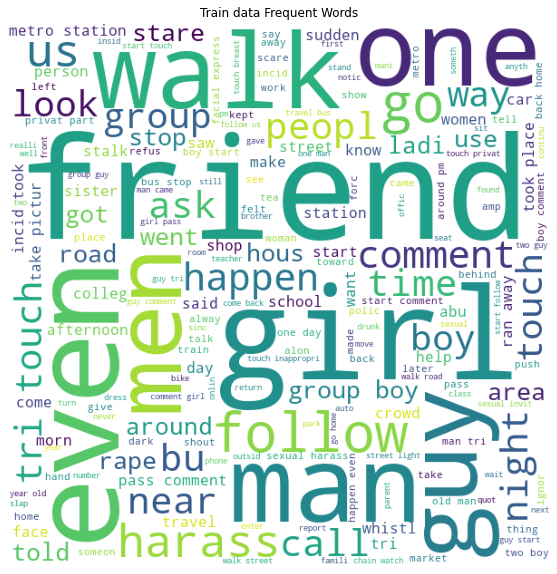

In [25]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (10, 10))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate(" ".join(data['stemed']))
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [26]:
data.stemed

0       walk along crowd street hold sum hand elder ma...
1         incid took place even metro two guy start stare
2                     wait us cam offer liftvto young irl
3                                incid happen insid train
4       wit incid chain brutal snatch elder ladi incid...
                              ...                        
7196    person near construct site probabl labor make ...
7197    threaten make inappropri convers threaten one ...
7198    happen morn univers metro station guy comment ...
7199    one day aunt return frm offic haunt e found on...
7200                             victim sexual assault ap
Name: stemed, Length: 6773, dtype: object

In [27]:
import nltk
from nltk.collocations import BigramAssocMeasures, BigramCollocationFinder,TrigramCollocationFinder, TrigramAssocMeasures
from operator import itemgetter 
# Allocate the weight of the tri-grams. I choose to use trigrams because in this case it generates more insights than bi-grams, simply replace "Tri" with "Bi" if you want to play with bi-grams.finder = TrigramCollocationFinder.from_words(text_content)

finder = TrigramCollocationFinder.from_words(data.stemed)

Trigram_measures = TrigramAssocMeasures()
scored = finder.score_ngrams(Trigram_measures.raw_freq)
 
# Sort it based on weights
scoredList = sorted(scored, key=itemgetter(1), reverse=True)
 
#Initiate a list of tri-grams with their weight
 
word_dict = {}
 
listLen = len(scoredList)
 
# Assign values in to the word_dict
for i in range(listLen):
    word_dict['_'.join(scoredList[i][0])] = scoredList[i][1]
 
 
# Set the parameters of the wordcloud image
WC_height = 500
WC_width = 1000
WC_max_words = 100
 
wordCloud = WordCloud(max_words=WC_max_words, height=WC_height, width=WC_width)
 
wordCloud.generate_from_frequencies(word_dict)

In [28]:
badreview = ''
for x in data.stemed:
        badreview= badreview+x



In [29]:
from nltk.util import ngrams
import collections

n = 2
sentence = badreview
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi=collections.Counter(a)

   
  


In [30]:
import more_itertools

counter_bi={k: v for k, v in sorted(counter_bi.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi.items())
print(len(first_n))
print(first_n)


200
[('tri_touch', 221), ('took_place', 160), ('group_boy', 159), ('pass_comment', 128), ('metro_station', 126), ('take_pictur', 96), ('privat_part', 96), ('back_home', 91), ('boy_start', 90), ('bus_stop', 77), ('two_boy', 76), ('old_man', 74), ('start_comment', 73), ('touch_privat', 72), ('start_touch', 70), ('facial_express', 69), ('around_pm', 69), ('ran_away', 65), ('start_follow', 65), ('man_tri', 63), ('sexual_harass', 61), ('man_came', 60), ('comment_girl', 60), ('guy_start', 59), ('boy_comment', 59), ('boy_came', 56), ('touch_breast', 55), ('touch_inappropri', 54), ('one_man', 54), ('follow_us', 51), ('guy_tri', 50), ('start_whistl', 50), ('guy_came', 49), ('girl_pass', 48), ('two_guy', 47), ('one_boy', 47), ('year_old', 47), ('one_day', 46), ('pass_lead', 44), ('street_light', 44), ('snatch_chain', 43), ('age_man', 43), ('boy_pass', 42), ('start_call', 41), ('home_school', 40), ('guy_comment', 40), ('group_guy', 40), ('touch_girl', 40), ('day_time', 40), ('whistl_comment', 40)

Word_cloud  Bi_gram 

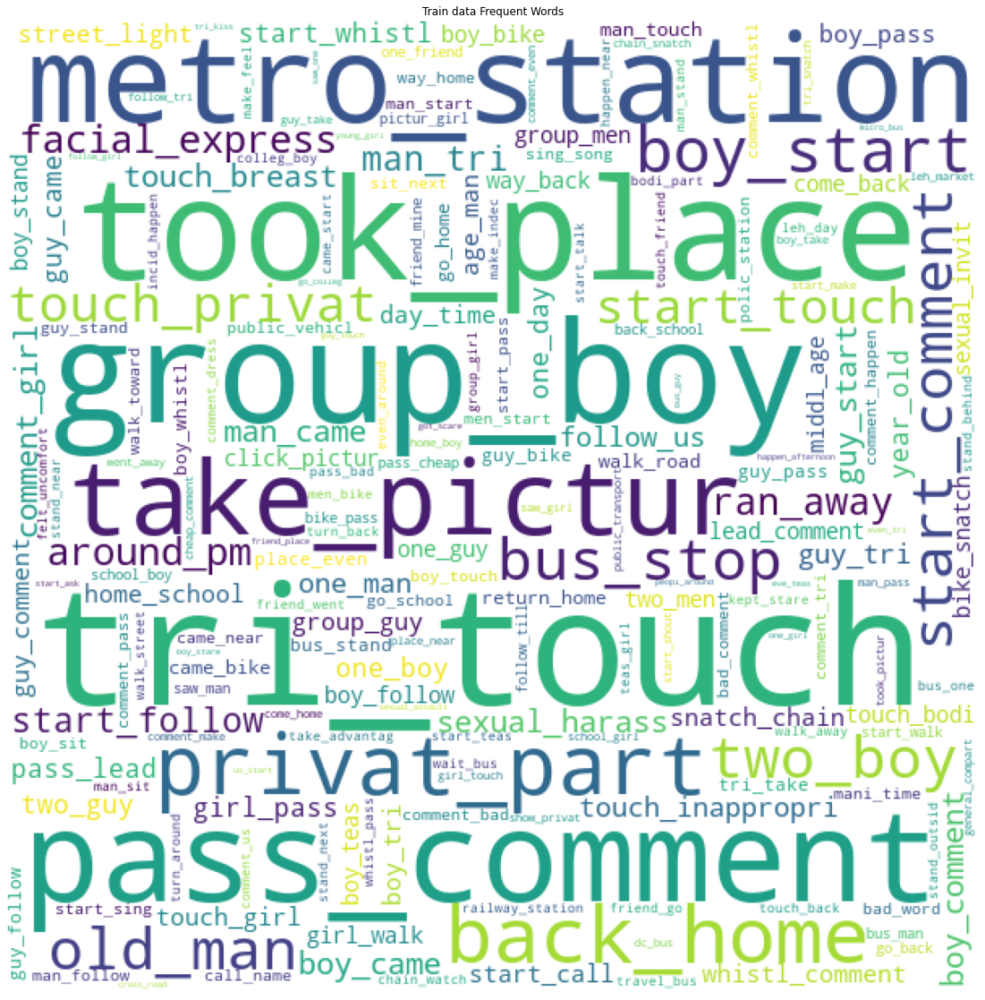

In [31]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_bi)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [32]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri=collections.Counter(a)

  
print(len(counter_tri))    
counter_tri={k: v for k, v in sorted(counter_tri.items(), key=lambda item: item[1],reverse=True)}



counter_tri={k: v for k, v in sorted(counter_tri.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_tri.items())
print(len(first_n))
print(first_n)


70539
200
[('touch_privat_part', 44), ('pass_lead_comment', 30), ('guy_tri_touch', 28), ('middl_age_man', 27), ('man_tri_touch', 26), ('group_boy_start', 25), ('took_place_even', 24), ('tri_touch_privat', 20), ('take_pictur_girl', 17), ('two_boy_bike', 17), ('way_back_home', 16), ('start_follow_us', 16), ('boy_tri_touch', 15), ('boy_start_follow', 15), ('pass_cheap_comment', 14), ('boy_start_comment', 14), ('came_bike_snatch', 14), ('pass_bad_comment', 14), ('go_back_home', 14), ('incid_took_place', 13), ('bike_snatch_chain', 13), ('start_sing_song', 13), ('boy_pass_comment', 12), ('tri_touch_bodi', 12), ('comment_girl_pass', 12), ('took_place_around', 12), ('took_place_near', 12), ('group_boy_teas', 12), ('took_place_th', 11), ('expos_privat_part', 11), ('guy_take_pictur', 11), ('guy_start_follow', 11), ('leh_day_time', 11), ('took_place_afternoon', 11), ('tri_touch_girl', 11), ('boy_take_pictur', 10), ('come_back_school', 10), ('leh_market_day', 10), ('market_day_time', 10), ('make_f

Word_cloud Tri_gram

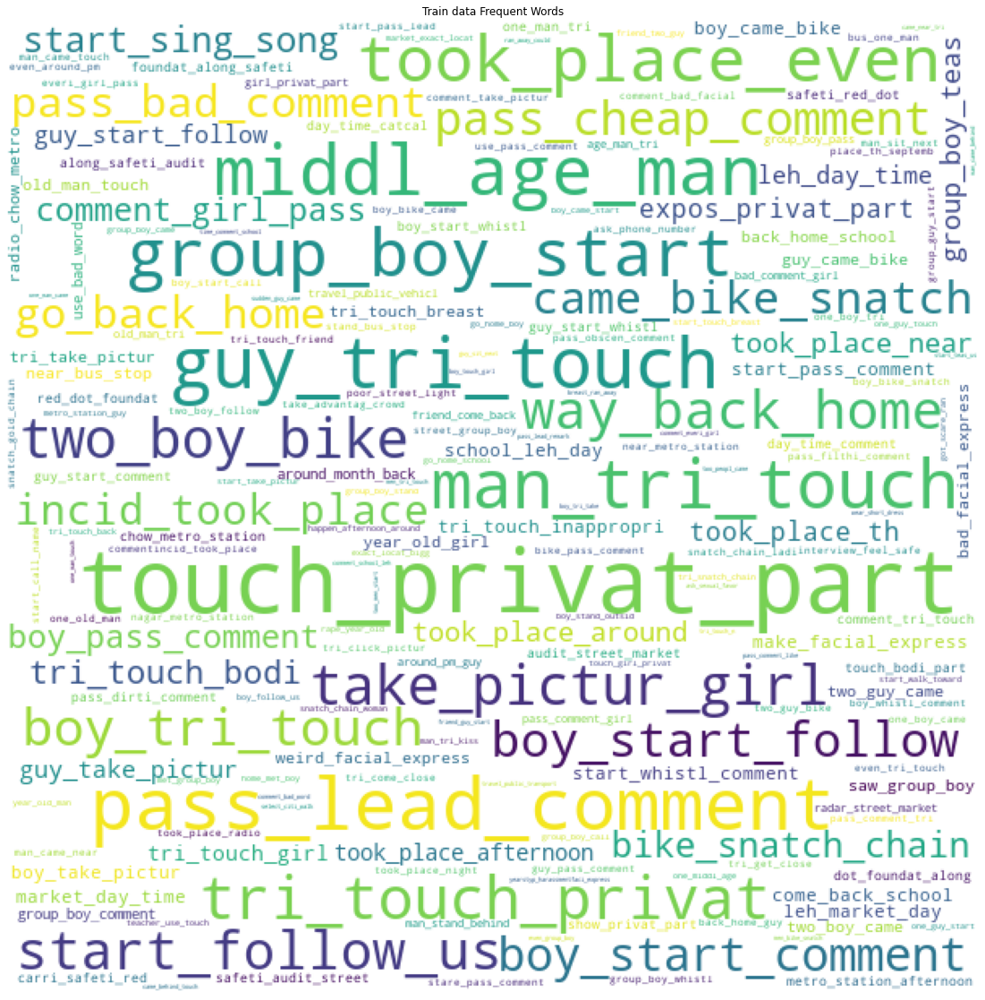

In [33]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_tri)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [34]:
l=[]
for i in data.stemed:
  l.append(len(i.split(' ')))



lc=l.copy()

Plot for stemed *length*

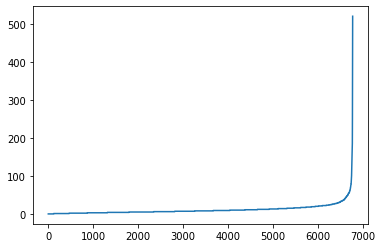

In [35]:
lc.sort()
plt.plot(lc)

99th percentile value for stemed length data

In [36]:
import numpy as np
per=np.percentile(lc, 99)
per

60.279999999999745

In [37]:
data_commenting=data[data.Commenting==1]
data_staring=data[data['Ogling/Facial Expressions/Staring']==1]
data_grouping=data[data['Touching /Groping']==1]

Wordcloud for Stemed column for class COMMENTING

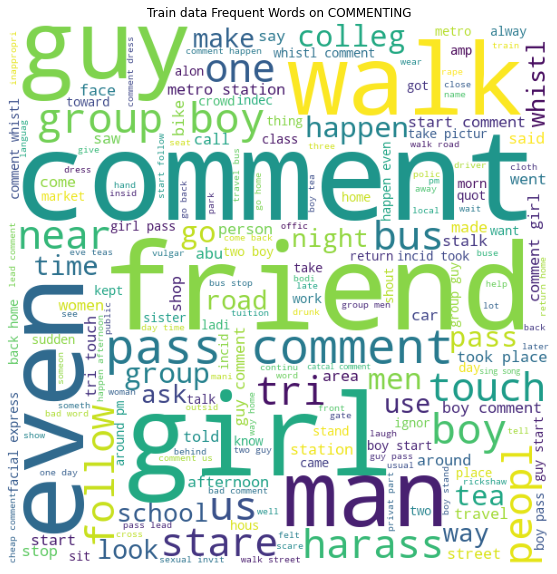

In [38]:
fig, (ax1) = plt.subplots(1, figsize = (10, 10))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate(" ".join(data_commenting['stemed']))
ax1.set_title('{} data Frequent Words on COMMENTING'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

Wordcloud for Stemed column for class STARING

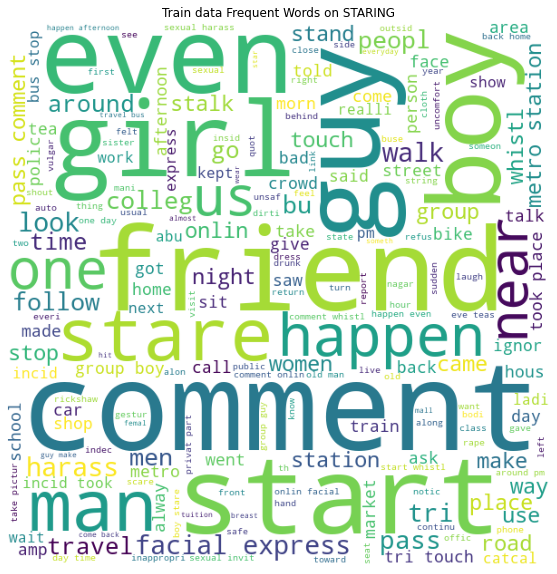

In [39]:
fig, (ax1) = plt.subplots(1, figsize = (10, 10))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate(" ".join(data_staring['stemed']))
ax1.set_title('{} data Frequent Words on STARING'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

Wordcloud for Stemed column for class GROUPING

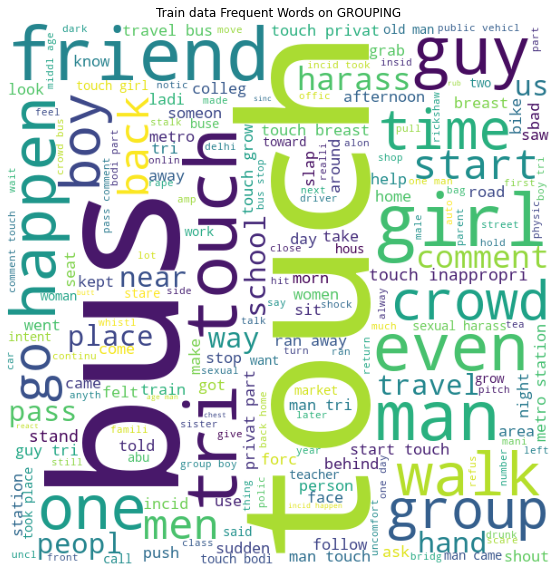

In [40]:
fig, (ax1) = plt.subplots(1, figsize = (10, 10))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate(" ".join(data_grouping['stemed']))
ax1.set_title('{} data Frequent Words on GROUPING'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

Plot for stemed *length* and 99th percentile for commenting class

99 percentile is  57.0600000000004


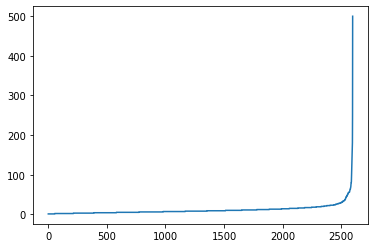

In [41]:
l=[]
for i in data_commenting.stemed:
  l.append(len(i.split(' ')))

lc=l.copy()

lc.sort()
plt.plot(lc)

print('99 percentile is ',np.percentile(lc, 99))

Plot for stemed *length* and 99th percentile for grouping class

99 percentile is  63.63999999999987


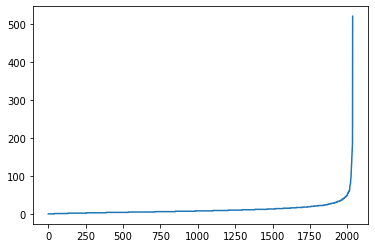

In [42]:
l=[]
for i in data_grouping.stemed:
  l.append(len(i.split(' ')))

lc=l.copy()

lc.sort()
plt.plot(lc)

print('99 percentile is ',np.percentile(lc, 99))

Plot for stemed *length* and 99th percentile for staring class

99 percentile is  69.01999999999998


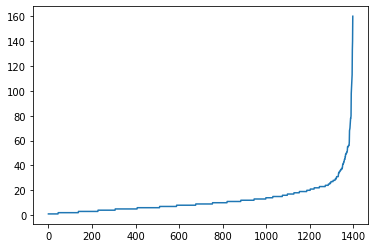

In [43]:
l=[]
for i in data_staring.stemed:
  l.append(len(i.split(' ')))

lc=l.copy()

lc.sort()
plt.plot(lc)

print('99 percentile is ',np.percentile(lc, 99))

In [44]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed,text_lemmatized
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...",walk along crowd street hold sum hand elder ma...,"[walking, along, crowded, street, holding, sum..."
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...",incid took place even metro two guy start stare,"[incident, took, place, evening, metro, two, g..."
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]",wait us cam offer liftvto young irl,"[waiting, u, cam, offering, liftvto, young, irl]"
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]",incid happen insid train,"[incident, happened, inside, train]"
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...",wit incid chain brutal snatch elder ladi incid...,"[witnessed, incident, chain, brutally, snatche..."
...,...,...,...,...,...,...,...
7196,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...",person near construct site probabl labor make ...,"[person, near, construction, site, probably, l..."
7197,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...",threaten make inappropri convers threaten one ...,"[threatened, making, inappropriate, conversati..."
7198,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...",happen morn univers metro station guy comment ...,"[happened, morning, university, metro, station..."
7199,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...",one day aunt return frm offic haunt e found on...,"[one, day, aunt, returned, frm, office, haunt,..."


Removing rows bases 99 percentile values

In [45]:
data=data[data['stemed'].str.split(' ').map(len) < per].reset_index(drop=True)
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed,text_lemmatized
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...",walk along crowd street hold sum hand elder ma...,"[walking, along, crowded, street, holding, sum..."
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...",incid took place even metro two guy start stare,"[incident, took, place, evening, metro, two, g..."
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]",wait us cam offer liftvto young irl,"[waiting, u, cam, offering, liftvto, young, irl]"
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]",incid happen insid train,"[incident, happened, inside, train]"
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...",wit incid chain brutal snatch elder ladi incid...,"[witnessed, incident, chain, brutally, snatche..."
...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...",person near construct site probabl labor make ...,"[person, near, construction, site, probably, l..."
6701,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...",threaten make inappropri convers threaten one ...,"[threatened, making, inappropriate, conversati..."
6702,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...",happen morn univers metro station guy comment ...,"[happened, morning, university, metro, station..."
6703,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...",one day aunt return frm offic haunt e found on...,"[one, day, aunt, returned, frm, office, haunt,..."


Convert multiple lable into single lable

In [46]:
data['single_lable']=data['Commenting'].astype(str)+'_'+data['Ogling/Facial Expressions/Staring'].astype(str)+'_'+data['Touching /Groping'].astype(str)

data_test['single_lable']=data_test['Commenting'].astype(str)+'_'+data_test['Ogling/Facial Expressions/Staring'].astype(str)+'_'+data_test['Touching /Groping'].astype(str)

In [47]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed,text_lemmatized,single_lable
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...",walk along crowd street hold sum hand elder ma...,"[walking, along, crowded, street, holding, sum...",0_0_1
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...",incid took place even metro two guy start stare,"[incident, took, place, evening, metro, two, g...",0_1_0
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]",wait us cam offer liftvto young irl,"[waiting, u, cam, offering, liftvto, young, irl]",1_0_0
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]",incid happen insid train,"[incident, happened, inside, train]",0_0_0
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...",wit incid chain brutal snatch elder ladi incid...,"[witnessed, incident, chain, brutally, snatche...",0_0_0
...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...",person near construct site probabl labor make ...,"[person, near, construction, site, probably, l...",0_1_0
6701,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...",threaten make inappropri convers threaten one ...,"[threatened, making, inappropriate, conversati...",1_0_0
6702,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...",happen morn univers metro station guy comment ...,"[happened, morning, university, metro, station...",1_0_0
6703,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...",one day aunt return frm offic haunt e found on...,"[one, day, aunt, returned, frm, office, haunt,...",0_0_0


##Creating multiple lable into single lable

In [48]:
un=data['single_lable'].unique()

single_list=[]

for i in data['single_lable']:
  for j in range(len(un)):
    if i==un[j]:
      single_list.append(j)



un=data_test['single_lable'].unique()

single_list_test=[]

for i in data_test['single_lable']:
  for j in range(len(un)):
    if i==un[j]:
      single_list_test.append(j)      

In [49]:
print(un)


['1_1_0' '0_0_1' '0_1_0' '0_0_0' '1_0_0' '0_1_1' '1_1_1' '1_0_1']


In [50]:
data['single_lable']=single_list
data

data_test['single_lable']=single_list_test
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,Removed_stop_words,stemed,text_lemmatized,single_lable
0,was walking along crowded street holding sums...,0,0,1,"[walking, along, crowded, street, holding, sum...",walk along crowd street hold sum hand elder ma...,"[walking, along, crowded, street, holding, sum...",0
1,this incident took place in the evening i was ...,0,1,0,"[incident, took, place, evening, metro, two, g...",incid took place even metro two guy start stare,"[incident, took, place, evening, metro, two, g...",1
2,i as waiting or the us a an cam of a be and a...,1,0,0,"[waiting, us, cam, offering, liftvto, young, irl]",wait us cam offer liftvto young irl,"[waiting, u, cam, offering, liftvto, young, irl]",2
3,incident happened inside the train,0,0,0,"[incident, happened, inside, train]",incid happen insid train,"[incident, happened, inside, train]",3
4,i witnessed an incident when a chain was bruta...,0,0,0,"[witnessed, incident, chain, brutally, snatche...",wit incid chain brutal snatch elder ladi incid...,"[witnessed, incident, chain, brutally, snatche...",3
...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,"[person, near, construction, site, probably, l...",person near construct site probabl labor make ...,"[person, near, construction, site, probably, l...",1
6701,he threatened me by making inappropriate conve...,1,0,0,"[threatened, making, inappropriate, conversati...",threaten make inappropri convers threaten one ...,"[threatened, making, inappropriate, conversati...",2
6702,happened during morning at university metro st...,1,0,0,"[happened, morning, university, metro, station...",happen morn univers metro station guy comment ...,"[happened, morning, university, metro, station...",2
6703,one day my aunt was returned frm office haun...,0,0,0,"[one, day, aunt, returned, frm, office, haunt,...",one day aunt return frm offic haunt e found on...,"[one, day, aunt, returned, frm, office, haunt,...",3


Droping remove Removed_stop_words and text_lemmatized

In [51]:
data=data.drop(['Removed_stop_words','text_lemmatized'],axis=1)

In [52]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,stemed,single_lable
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait us cam offer liftvto young irl,2
3,incident happened inside the train,0,0,0,incid happen insid train,3
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3
...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt e found on...,3


In [53]:
data.stemed=data.stemed.replace(['pm','amp','nagar','dtc'],'')
data.stemed=data.stemed.replace('bu','bus')
data.stemed=data.stemed.replace('scared',' scared ')


Distribution of each class

<BarContainer object of 8 artists>

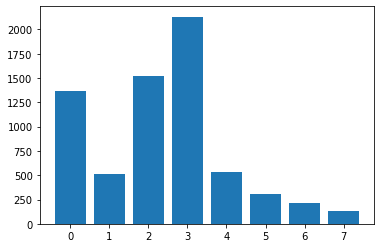

In [54]:
distibustion=pd.DataFrame(data['single_lable'].value_counts()).sort_index()
distibustion
plt.bar(list(distibustion.index),distibustion.single_lable)

TF-IDF

In [55]:
from sklearn.feature_extraction.text import TfidfVectorizer


tfidf = TfidfVectorizer()


tfidf.fit_transform(data['stemed'])



<6705x4530 sparse matrix of type '<class 'numpy.float64'>'
	with 69233 stored elements in Compressed Sparse Row format>

In [56]:
tfidf.idf_

array([8.71214564, 9.11761075, 8.71214564, ..., 9.11761075, 8.42446357,
       8.71214564])

Making Dictionary for tfidf featur e names and idf values





In [57]:
idf_dic=dict(zip(tfidf.get_feature_names(),tfidf.idf_))
idf_dic

{'aa': 8.712145638358065,
 'aaa': 9.117610746466228,
 'aap': 8.712145638358065,
 'ab': 9.117610746466228,
 'abandon': 8.201320014592074,
 'abl': 7.038169204786392,
 'abnorm': 9.117610746466228,
 'abort': 9.117610746466228,
 'abrupt': 8.712145638358065,
 'absenc': 8.201320014592074,
 'absolut': 8.424463565906283,
 'absorb': 9.117610746466228,
 'absurd': 8.201320014592074,
 'abt': 8.01899845779812,
 'abu': 9.117610746466228,
 'abus': 4.861998036648005,
 'ac': 8.712145638358065,
 'acceler': 8.201320014592074,
 'accent': 9.117610746466228,
 'accept': 7.325851277238174,
 'access': 7.86484777797086,
 'accid': 7.508172834032128,
 'accident': 8.01899845779812,
 'accompani': 7.2458085695646375,
 'accord': 7.86484777797086,
 'account': 8.712145638358065,
 'accumul': 9.117610746466228,
 'accus': 7.325851277238174,
 'ace': 7.613533349689955,
 'acid': 7.86484777797086,
 'acknowledg': 9.117610746466228,
 'acquaint': 8.01899845779812,
 'acr': 9.117610746466228,
 'across': 6.3767707225410275,
 'act': 

In [58]:
len(idf_dic)

4530

Sorting the idf_dic with respect to key value in Descending order

In [59]:
{k: v for k, v in sorted(idf_dic.items(), key=lambda item: item[1],reverse=True)}

{'aaa': 9.117610746466228,
 'ab': 9.117610746466228,
 'abnorm': 9.117610746466228,
 'abort': 9.117610746466228,
 'absorb': 9.117610746466228,
 'abu': 9.117610746466228,
 'accent': 9.117610746466228,
 'accumul': 9.117610746466228,
 'acknowledg': 9.117610746466228,
 'acr': 9.117610746466228,
 'activitiesquot': 9.117610746466228,
 'actress': 9.117610746466228,
 'adam': 9.117610746466228,
 'add': 9.117610746466228,
 'adjac': 9.117610746466228,
 'adjust': 9.117610746466228,
 'adm': 9.117610746466228,
 'administr': 9.117610746466228,
 'admir': 9.117610746466228,
 'admiss': 9.117610746466228,
 'admit': 9.117610746466228,
 'adventur': 9.117610746466228,
 'advic': 9.117610746466228,
 'advis': 9.117610746466228,
 'advoc': 9.117610746466228,
 'af': 9.117610746466228,
 'afar': 9.117610746466228,
 'affect': 9.117610746466228,
 'affili': 9.117610746466228,
 'agenc': 9.117610746466228,
 'aggrav': 9.117610746466228,
 'agit': 9.117610746466228,
 'ahmedabad': 9.117610746466228,
 'aim': 9.117610746466228

Creating a featur for stemed length

In [60]:
l=[]
for i in data.stemed:
  l.append(len(i.split(' ')))


data['stemed_len']=l
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,stemed,single_lable,stemed_len
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait us cam offer liftvto young irl,2,7
3,incident happened inside the train,0,0,0,incid happen insid train,3,4
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11
...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt e found on...,3,24


Box plot between lables and stemed len

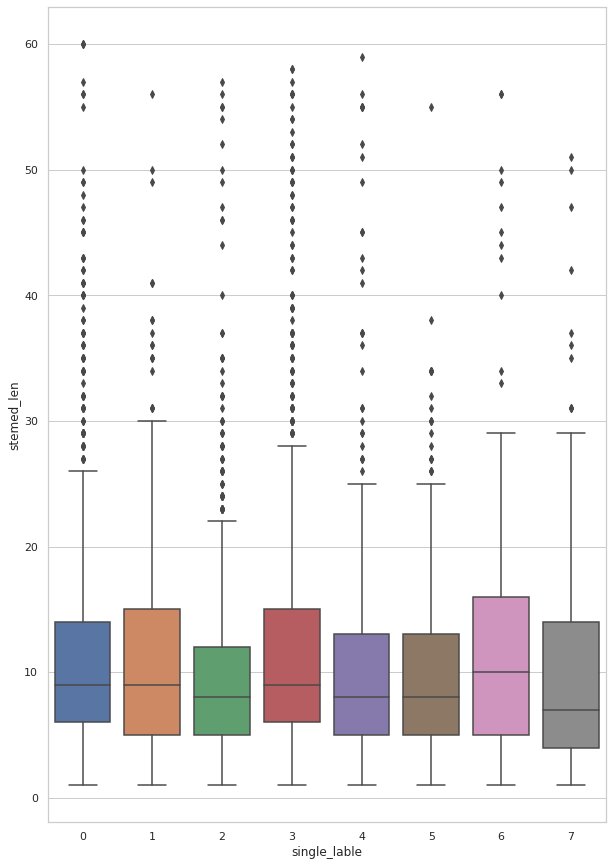

In [61]:
import seaborn as sns
plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y="stemed_len", data=data)



In [62]:

data


,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,stemed,single_lable,stemed_len
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait us cam offer liftvto young irl,2,7
3,incident happened inside the train,0,0,0,incid happen insid train,3,4
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11
...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt e found on...,3,24


Creating a featurs by SentimentIntensityAnalyzer which gives the polarity of the text 

In [63]:
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer

sid = SentimentIntensityAnalyzer()

neg=[]
neu=[]
pos=[]
com=[]

for i in data.stemed:

  ss=sid.polarity_scores(i)

  neg.append(ss['neg'])
  neu.append(ss['neu'])
  pos.append(ss['pos'])
  com.append(ss['compound'])

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


/usr/local/lib/python3.7/dist-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


In [64]:
data['negative']=neg
data['neutral']=neu
data['positive']=pos
data['compound']=com

In [65]:
data

,Description,Commenting,Ogling/Facial Expressions/Staring,Touching /Groping,stemed,single_lable,stemed_len,negative,neutral,positive,compound
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18,0.000,0.833,0.167,0.4939
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9,0.000,1.000,0.000,0.0000
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait us cam offer liftvto young irl,2,7,0.000,1.000,0.000,0.0000
3,incident happened inside the train,0,0,0,incid happen insid train,3,4,0.000,1.000,0.000,0.0000
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11,0.291,0.709,0.000,-0.6249
...,...,...,...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13,0.000,0.811,0.189,0.4215
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8,0.464,0.536,0.000,-0.6369
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8,0.000,0.843,0.157,0.0772
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt e found on...,3,24,0.222,0.677,0.102,-0.4939


Remove words whose length is between 1 and 2

In [66]:
import re

shortword=re.compile(r'\W*\b\w{1,2}\b')


data['stemed']=data['stemed'].str.replace(shortword, '')

Box plot between lables and Description length

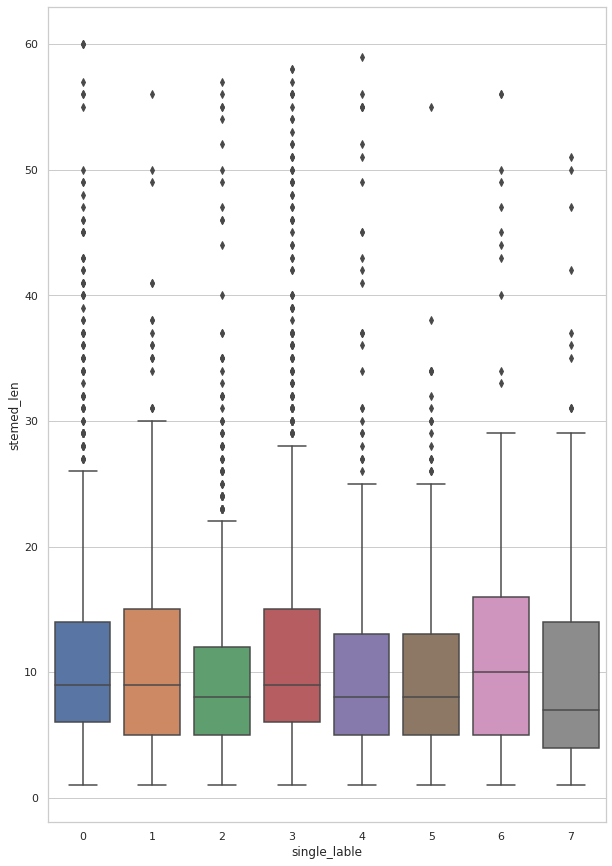

In [67]:
plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y='stemed_len', data=data)

Box plot between lables and compound

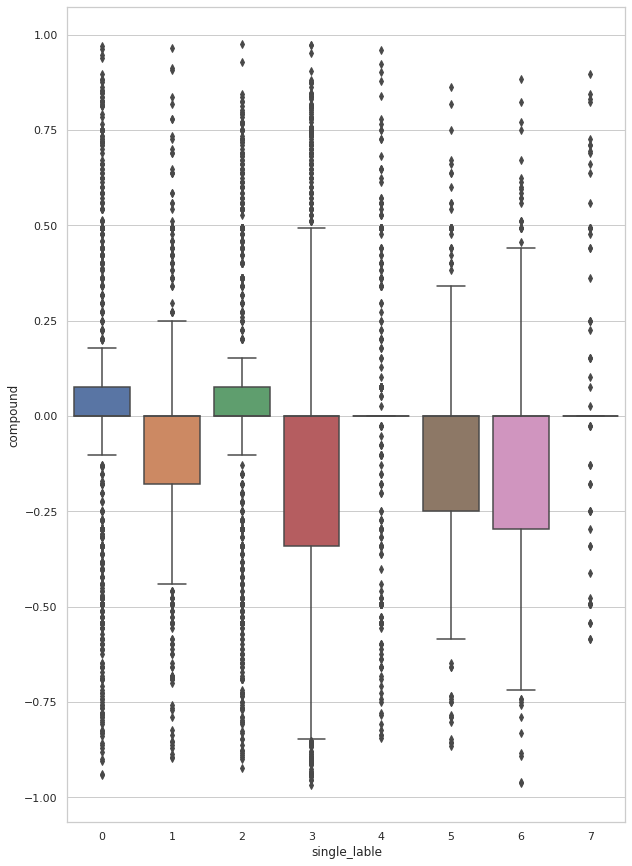

In [68]:
plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y='compound', data=data)

Box plot between lables and new featue mul

mul=data['negative'].replace(0.000,0.11) * data['positive'].replace(0.000,0.11) *data['compound'].replace(0.000,0.11)

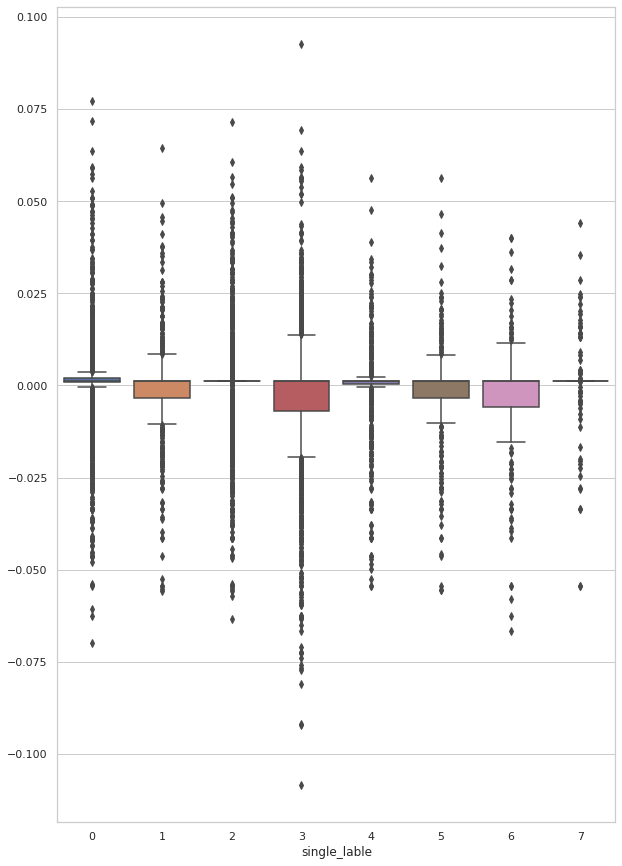

In [69]:
mul=data['negative'].replace(0.000,0.11) * data['positive'].replace(0.000,0.11) *data['compound'].replace(0.000,0.11)

plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y=mul, data=data)

Adding log(idf) values of each word in the text

In [70]:
text_idf_plus=[]
for i in data.stemed:
  idf=0
  for j in i.split(' '):
    try:
      idf+=idf_dic[j]
    except:
      continue
  text_idf_plus.append(np.log(idf))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in log
  if __name__ == '__main__':


In [71]:
data['idf_plus']=text_idf_plus

Box plot between lables and text_idf_plus

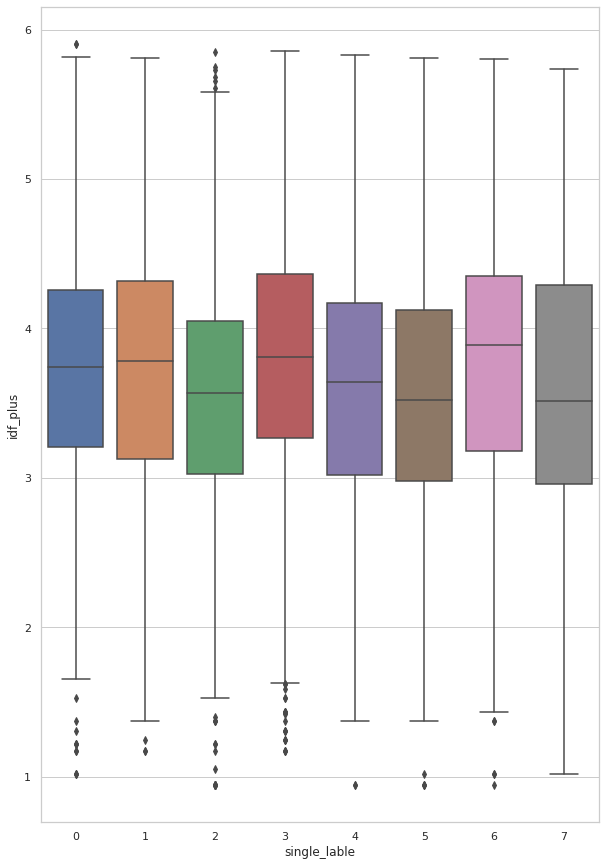

In [72]:
plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y='idf_plus', data=data)

Multiplying log(idf) values of each word in the text

In [73]:
text_idf_mul=[]
for i in data.stemed:
  idf=1
  for j in i.split(' '):
    
    try:
      idf*=idf_dic[j]
     
    except:
      continue
  text_idf_mul.append(np.log(idf))

In [74]:
data['idf_mul']=text_idf_mul

Box plot between lables and text_idf_mul

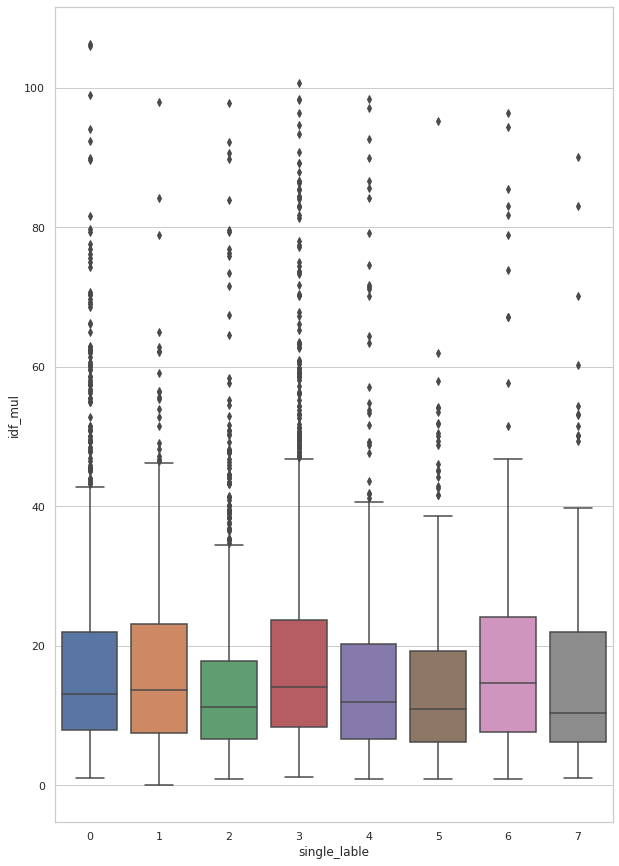

In [75]:
plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y='idf_mul', data=data)

Box plot between lables and new feature f1

f1=data.compound + text_idf_plus

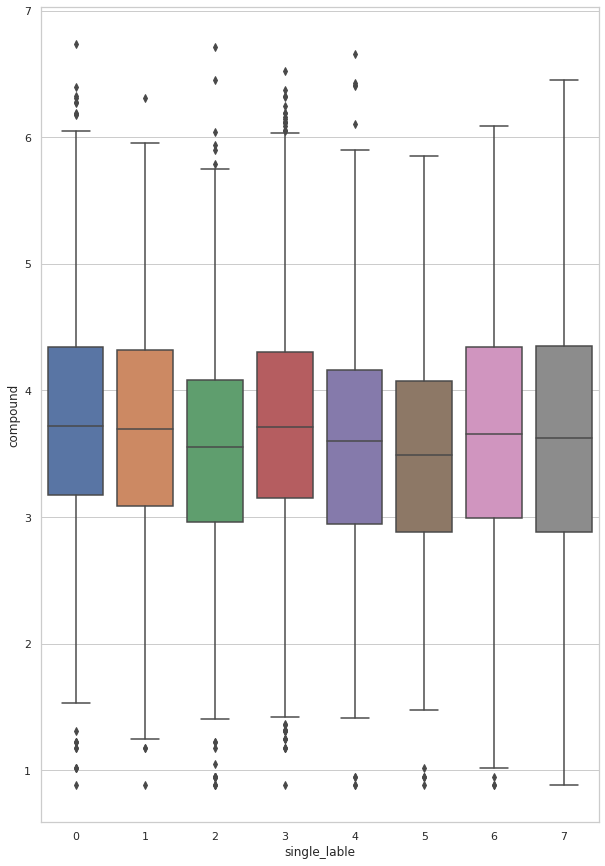

In [76]:
f1=data.compound + text_idf_plus

plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x="single_lable", y=f1, data=data)

By doing Analysis I found that  **compound feature** and **text_idf_plus** can play an impotant role for classification.

In [77]:
d0=data[data['single_lable']==0]['stemed'].reset_index(drop=True)
d1=data[data['single_lable']==1]['stemed'].reset_index(drop=True)
d2=data[data['single_lable']==2]['stemed'].reset_index(drop=True)
d3=data[data['single_lable']==3]['stemed'].reset_index(drop=True)
d4=data[data['single_lable']==4]['stemed'].reset_index(drop=True)
d5=data[data['single_lable']==5]['stemed'].reset_index(drop=True)
d6=data[data['single_lable']==6]['stemed'].reset_index(drop=True)
d7=data[data['single_lable']==7]['stemed'].reset_index(drop=True)

In [78]:
d0_list=set(d0.str.split(' ', expand=True).stack().unique())
d1_list=set(d1.str.split(' ', expand=True).stack().unique())
d2_list=set(d2.str.split(' ', expand=True).stack().unique())
d3_list=set(d3.str.split(' ', expand=True).stack().unique())
d4_list=set(d4.str.split(' ', expand=True).stack().unique())
d5_list=set(d5.str.split(' ', expand=True).stack().unique())
d6_list=set(d6.str.split(' ', expand=True).stack().unique())
d7_list=set(d7.str.split(' ', expand=True).stack().unique())


In [79]:
remove_words=list(d0_list & d1_list & d2_list & d3_list & d4_list & d5_list & d6_list & d7_list)
remove_words

['',
 'mani',
 'almost',
 'took',
 'three',
 'take',
 'run',
 'stalk',
 'home',
 'main',
 'bus',
 'toward',
 'give',
 'told',
 'bike',
 'also',
 'inappropri',
 'month',
 'refus',
 'feel',
 'behind',
 'behav',
 'pull',
 'away',
 'intent',
 'follow',
 'would',
 'see',
 'place',
 'forc',
 'regular',
 'two',
 'platform',
 'saw',
 'could',
 'express',
 'misbehav',
 'polic',
 'train',
 'men',
 'one',
 'male',
 'buse',
 'problem',
 'pass',
 'wrong',
 'public',
 'continu',
 'felt',
 'watch',
 'light',
 'lead',
 'especi',
 'work',
 'night',
 'colleg',
 'driver',
 'old',
 'privat',
 'teas',
 'leav',
 'late',
 'show',
 'cancel',
 'small',
 'peni',
 'return',
 'everyday',
 'chain',
 'time',
 'uncomfort',
 'someon',
 'age',
 'tri',
 'middl',
 'man',
 'sat',
 'wear',
 'close',
 'side',
 'unsaf',
 'breast',
 'touch',
 'street',
 'face',
 'keep',
 'like',
 'peopl',
 'besid',
 'sister',
 'wait',
 'walk',
 'uncl',
 'till',
 'pictur',
 'hit',
 'near',
 'hold',
 'metro',
 'bad',
 'auto',
 'around',
 'numb

In [80]:
len(remove_words)

221

In [81]:
pat = r'\b(?:{})\b'.format('|'.join(remove_words))

pat

data['remove_stemed'] = data['stemed'].str.replace(pat,'')

Violan plot of single lable

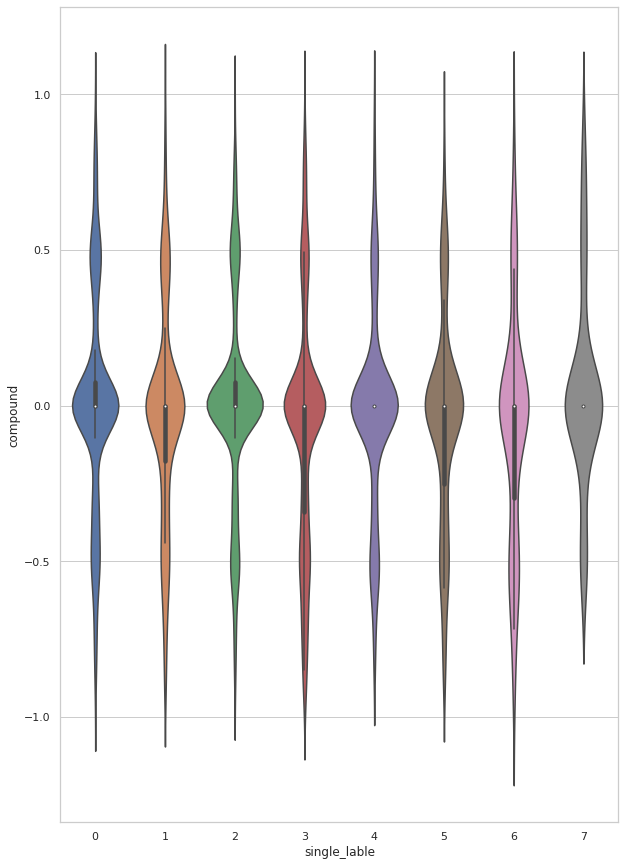

In [82]:

plt.figure(figsize=(10,15))
sns.set_theme(style="whitegrid")
ax = sns.violinplot(x="single_lable", y='compound', data=data)

In [83]:
#please use below code to load glove vectors 
import pickle
with open('/content/drive/MyDrive/glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

#Single lable analysis

In [84]:

data = data.rename(columns={'Ogling/Facial Expressions/Staring': 'Staring', 'Touching /Groping': 'touching'})
data_test = data_test.rename(columns={'Ogling/Facial Expressions/Staring': 'Staring', 'Touching /Groping': 'touching'})

data

,Description,Commenting,Staring,touching,stemed,single_lable,stemed_len,negative,neutral,positive,compound,idf_plus,idf_mul,remove_stemed
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18,0.000,0.833,0.167,0.4939,4.446563,26.790928,along sum butt turn yrs
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9,0.000,1.000,0.000,0.0000,3.512121,11.759428,
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait cam offer liftvto young irl,2,7,0.000,1.000,0.000,0.0000,3.714501,11.394736,cam offer liftvto young irl
3,incident happened inside the train,0,0,0,incid happen insid train,3,4,0.000,1.000,0.000,0.0000,2.894686,5.963872,
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11,0.291,0.709,0.000,-0.6249,3.988859,17.117968,wit brutal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13,0.000,0.811,0.189,0.4215,4.333076,22.397354,construct site probabl labor kiss sound ...
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8,0.464,0.536,0.000,-0.6369,3.675154,12.459297,threaten convers threaten
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8,0.000,0.843,0.157,0.0772,3.495025,10.932422,univers
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt found one ...,3,24,0.222,0.677,0.102,-0.4939,4.709317,33.654827,aunt frm haunt gal frm aunt sort


TF_IDS W2V analysis

In [85]:

tfidf_model = TfidfVectorizer()
tfidf_model.fit(data['stemed'])

# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())

In [86]:
joblib.dump(tfidf_model, 'tfidf_model.pkl')


['tfidf_model.pkl']

In [87]:
from tqdm import tqdm

tfidf_w2v_vectors_tr = []; # the avg-w2v for each sentence/review is stored in this list

for sentence in tqdm(data['stemed']): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    tfidf_w2v_vectors_tr.append(vector)

print(len(tfidf_w2v_vectors_tr))
print(len(tfidf_w2v_vectors_tr[0]))





100%|██████████| 6705/6705 [00:00<00:00, 8532.14it/s]

6705
300


#Test_TF_IDF_w2v

In [88]:

tfidf_model_test = TfidfVectorizer()
tfidf_model_test.fit(data_test['stemed'])

# we are converting a dictionary with word as a key, and the idf as a value
dictionary_test = dict(zip(tfidf_model_test.get_feature_names(), list(tfidf_model_test.idf_)))
tfidf_words_test = set(tfidf_model_test.get_feature_names())


from tqdm import tqdm

tfidf_w2v_vectors_tr_test = []; # the avg-w2v for each sentence/review is stored in this list

for sentence in tqdm(data_test['stemed']): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    tfidf_w2v_vectors_tr_test.append(vector)

print(len(tfidf_w2v_vectors_tr_test))
print(len(tfidf_w2v_vectors_tr_test[0]))





100%|██████████| 1640/1640 [00:00<00:00, 9271.77it/s]

1640
300


In [89]:
from sklearn.manifold import TSNE


tsne2d = TSNE(
    n_components=2,
    init='random', # pca
    random_state=101,
    method='barnes_hut',
    n_iter=1000,
    verbose=2,
    angle=0.5
).fit_transform(tfidf_w2v_vectors_tr)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 6705 samples in 0.213s...
[t-SNE] Computed neighbors for 6705 samples in 23.441s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6705
[t-SNE] Computed conditional probabilities for sample 2000 / 6705
[t-SNE] Computed conditional probabilities for sample 3000 / 6705
[t-SNE] Computed conditional probabilities for sample 4000 / 6705
[t-SNE] Computed conditional probabilities for sample 5000 / 6705
[t-SNE] Computed conditional probabilities for sample 6000 / 6705
[t-SNE] Computed conditional probabilities for sample 6705 / 6705
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.374s
[t-SNE] Iteration 50: error = 90.8340836, gradient norm = 0.0559444 (50 iterations in 6.281s)
[t-SNE] Iteration 100: error = 90.5504761, gradient norm = 0.0881341 (50 iterations in 6.350s)
[t-SNE] Iteration 150: error = 90.8916779, gradient norm = 0.0535356 (50 iterations in 5.300s)
[t-SNE] Iteration 200: error =

In [90]:
from sklearn.manifold import TSNE

#  plot TSNE_method


def TSNE_plot(tfidf_w2v_vectors_tr):
  X_embedded_tf_w2v = TSNE(n_components=2).fit_transform(tfidf_w2v_vectors_tr)
  X_embedded_tf_w2v.shape

  df = pd.DataFrame({'x':X_embedded_tf_w2v[:,0], 'y':X_embedded_tf_w2v[:,1] ,'label':data['Commenting']})

  # draw the plot in appropriate place in the grid
  sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8,palette="Set1")
  plt.title("Scatter plot for lable Commenting ")
  plt.show()


  df = pd.DataFrame({'x':X_embedded_tf_w2v[:,0], 'y':X_embedded_tf_w2v[:,1] ,'label':data['Staring']})

  # draw the plot in appropriate place in the grid
  sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8,palette="Set1")
  plt.title("Scatter plot for lable Staring ")
  plt.show()



  df = pd.DataFrame({'x':X_embedded_tf_w2v[:,0], 'y':X_embedded_tf_w2v[:,1] ,'label':data['touching']})

  # draw the plot in appropriate place in the grid
  sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, size=8,palette="Set1")
  plt.title("Scatter plot for lable Touching ")
  plt.show()


/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


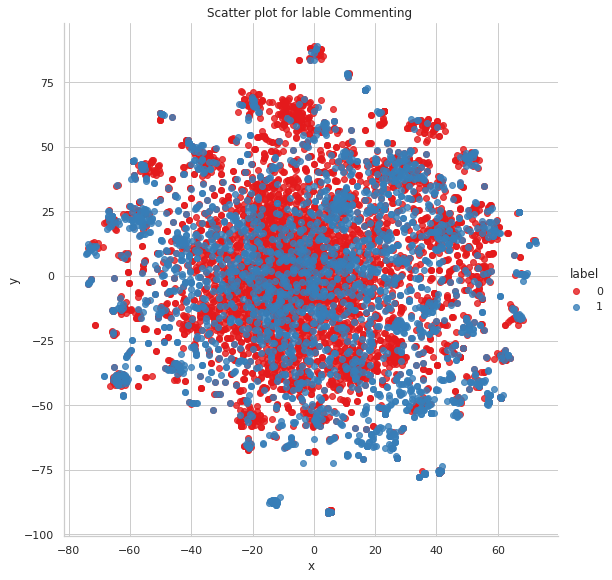

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


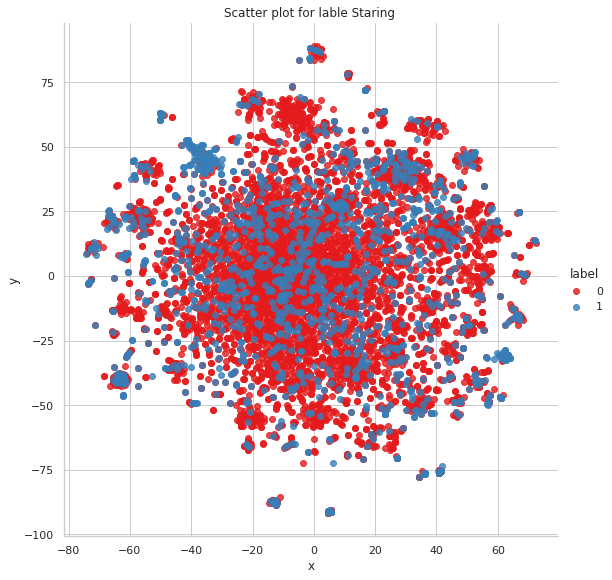

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


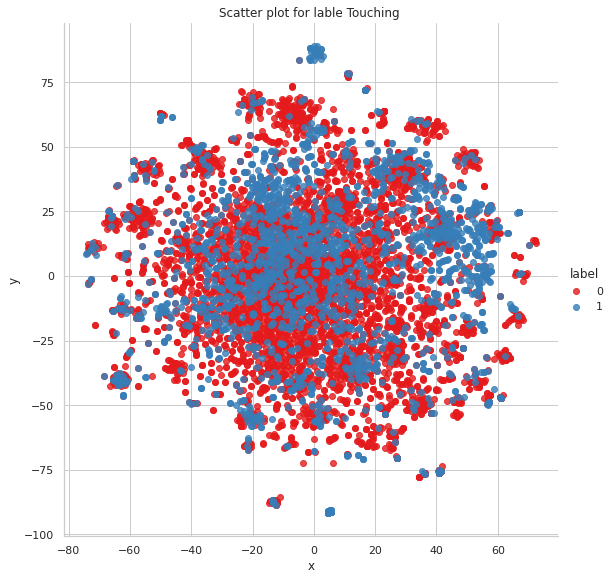

In [91]:
# TSNE plot for TF_IDF_W2v
TSNE_plot(tfidf_w2v_vectors_tr)

## Traing BERT *model*

# Brief description about BERT

In [92]:
'''
Reference :- https://searchenterpriseai.techtarget.com/definition/BERT-language-model

BERT, which stands for Bidirectional Encoder Representations from Transformers, is based on Transformers, 
a deep learning model in which every output element is connected to every input element, and the weightings 
between them are dynamically calculated based upon their connection. (In NLP, this process is called attention.)

Historically, language models could only read text input sequentially -- either left-to-right 
or right-to-left -- but couldn't do both at the same time. BERT is different because
it is designed to read in both directions at once. This capability, enabled by the introduction of Transformers, is known as bidirectionality. 

'''

"\nReference :- https://searchenterpriseai.techtarget.com/definition/BERT-language-model\n\nBERT, which stands for Bidirectional Encoder Representations from Transformers, is based on Transformers, \na deep learning model in which every output element is connected to every input element, and the weightings \nbetween them are dynamically calculated based upon their connection. (In NLP, this process is called attention.)\n\nHistorically, language models could only read text input sequentially -- either left-to-right \nor right-to-left -- but couldn't do both at the same time. BERT is different because\nit is designed to read in both directions at once. This capability, enabled by the introduction of Transformers, is known as bidirectionality. \n\n"

In [93]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras.models import Model

In [94]:
## Loading the Pretrained Model from tensorflow HUB
tf.keras.backend.clear_session()

# maximum length of a seq in the data we have, for now i am making it as 55. You can change this
max_seq_length = 55

#BERT takes 3 inputs

#this is input words. Sequence of words represented as integers
input_word_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="input_word_ids")

#mask vector if you are padding anything
input_mask = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="input_mask")

#segment vectors. If you are giving only one sentence for the classification, total seg vector is 0. 
#If you are giving two sentenced with [sep] token separated, first seq segment vectors are zeros and 
#second seq segment vector are 1's
segment_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="segment_ids")

#bert layer 
bert_layer = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1", trainable=False)
pooled_output, sequence_output = bert_layer([input_word_ids, input_mask, segment_ids])

#Bert model
#We are using only pooled output not sequence out. 
#If you want to know about those, please read https://www.kaggle.com/questions-and-answers/86510
bert_model = Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=pooled_output)


In [95]:
#getting Vocab file
vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()

In [96]:
!pip install sentencepiece

from tokenization import FullTokenizer

tokenizer=FullTokenizer(vocab_file, do_lower_case )


X_train_vocab=[]

for i in data.stemed:
  X_train_vocab.append(tokenizer.tokenize(i))

     |████████████████████████████████| 1.2 MB 11.1 MB/s 


In [97]:
train_trunk=[]
for i in X_train_vocab:
  train_trunk.append(['[CLS]',*i[0:53],'[SEP]'])

In [98]:
'''
Convert into vector
'''
train_ids=[]
for i in train_trunk:
  train_ids.append(tokenizer.convert_tokens_to_ids(i))

In [99]:
'''
Padding
'''

X_train_tokens=[]
for i in train_ids:
  X_train_tokens.append(i+[0]*(55-len(i)))

In [100]:
X_train_tokens=np.array(X_train_tokens)

In [101]:
X_train_tokens

X_train_mask=[]

for i in train_ids:
  X_train_mask.append(np.array([1]*len(i)+[0]*(55-len(i))))



X_train_tokens[102]  


X_train_mask = np.array(X_train_mask)


# Segment

X_train_segment=[]

for i in range(len(train_ids)):
  X_train_segment.append([0]*55)




X_train_segment = np.array(X_train_segment) 

In [102]:
len(X_train_segment)

6705

In [103]:
import pickle

In [104]:
max_seq_length=55

In [105]:
tokenizer.vocab['[CLS]']

101

In [106]:
X_train_tokens.shape

(6705, 55)

In [107]:
bert_model.input

[<KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'input_word_ids')>,
 <KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'input_mask')>,
 <KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'segment_ids')>]

In [108]:
bert_model.output

<KerasTensor: shape=(None, 768) dtype=float32 (created by layer 'keras_layer')>

In [109]:
X_train_pooled_output=bert_model.predict([X_train_tokens,X_train_mask,X_train_segment])

In [110]:
bert_model.save('bert_model')

INFO:tensorflow:Assets written to: bert_model/assets


INFO:tensorflow:Assets written to: bert_model/assets


In [111]:
from tensorflow import keras
model = keras.models.load_model('/content/bert_model')

In [112]:
X_train_pooled_output=model.predict([X_train_tokens,X_train_mask,X_train_segment])

In [113]:
X_train_pooled_output.shape

(6705, 768)

#Tset data for BERT

In [114]:
#getting Vocab file
vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()

In [115]:
!pip install sentencepiece

from tokenization import FullTokenizer

tokenizer=FullTokenizer(vocab_file, do_lower_case )


X_test_vocab=[]

for i in data_test.stemed:
  X_test_vocab.append(tokenizer.tokenize(i))

In [116]:
test_trunk=[]
for i in X_test_vocab:
  test_trunk.append(['[CLS]',*i[0:53],'[SEP]'])

In [117]:
X_test_vocab

[['mor',
  '##n',
  'woman',
  'walk',
  'thin',
  'guy',
  'came',
  'around',
  'call',
  'name',
  'comment',
  'fig',
  '##ur',
  'woman',
  'hand',
  '##l',
  'abu',
  '##s'],
 ['man', 'tri', 'brush', 'pen', '##i', 'woman', 'shoulder', 'bus'],
 ['happen',
  'fellow',
  'pass',
  '##eng',
  'mine',
  'travel',
  'metro',
  'kick',
  'metro',
  'station',
  'quo',
  '##t',
  '##di',
  '##ffer',
  '##ently',
  '##qu',
  '##ot',
  'dress'],
 ['on', '##lin'],
 ['return',
  'home',
  'finish',
  'class',
  'queue',
  'get',
  'micro',
  'bus',
  'girl',
  'op',
  '##po',
  '##sit',
  'young',
  'man',
  'tri',
  'touch',
  'breast'],
 ['come', 'tu', '##rra', '##m', '##nagar', 'shop', 'stranger', 'touch'],
 ['travel',
  'dc',
  'bus',
  'even',
  'boy',
  'intent',
  'fall',
  'girl',
  'stand',
  'behind',
  'report',
  'conductor',
  'not',
  '##h',
  'said',
  'mist',
  '##ak',
  'dc',
  'bus',
  '##e',
  'total',
  'un',
  '##sa',
  '##f',
  'girl'],
 ['come',
  'back',
  'shop',
  '

In [118]:
'''
Convert into vector
'''
test_ids=[]
for i in test_trunk:
  test_ids.append(tokenizer.convert_tokens_to_ids(i))

In [119]:
'''
Padding
'''

X_test_tokens=[]
for i in test_ids:
  X_test_tokens.append(i+[0]*(55-len(i)))

In [120]:
X_test_tokens=np.array(X_test_tokens)
X_test_tokens

array([[  101, 22822,  2078, ...,     0,     0,     0],
       [  101,  2158, 13012, ...,     0,     0,     0],
       [  101,  4148,  3507, ...,     0,     0,     0],
       ...,
       [  101,  2711, 13012, ...,     0,     0,     0],
       [  101,  2919, 21877, ...,     0,     0,     0],
       [  101,  2287,  2086, ...,     0,     0,     0]])

In [121]:
X_test_tokens

X_test_mask=[]

for i in test_ids:
  X_test_mask.append(np.array([1]*len(i)+[0]*(55-len(i))))





X_test_mask = np.array(X_test_mask)


# Segment

X_test_segment=[]

for i in range(len(test_ids)):
  X_test_segment.append([0]*55)




X_test_segment = np.array(X_test_segment) 

In [122]:
X_test_segment

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [123]:
import pickle

In [124]:
max_seq_length=55

In [125]:
tokenizer.vocab['[CLS]']

101

In [126]:
X_test_tokens.shape

(1640, 55)

In [127]:
bert_model.input

[<KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'input_word_ids')>,
 <KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'input_mask')>,
 <KerasTensor: shape=(None, 55) dtype=int32 (created by layer 'segment_ids')>]

In [128]:
bert_model.output

<KerasTensor: shape=(None, 768) dtype=float32 (created by layer 'keras_layer')>

In [129]:
X_test_pooled_output=bert_model.predict([X_test_tokens,X_test_mask,X_test_segment])

In [130]:
len(X_train_pooled_output[1])

768

In [131]:
X_test_pooled_output.shape

(1640, 768)

In [132]:
data

,Description,Commenting,Staring,touching,stemed,single_lable,stemed_len,negative,neutral,positive,compound,idf_plus,idf_mul,remove_stemed
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18,0.000,0.833,0.167,0.4939,4.446563,26.790928,along sum butt turn yrs
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9,0.000,1.000,0.000,0.0000,3.512121,11.759428,
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait cam offer liftvto young irl,2,7,0.000,1.000,0.000,0.0000,3.714501,11.394736,cam offer liftvto young irl
3,incident happened inside the train,0,0,0,incid happen insid train,3,4,0.000,1.000,0.000,0.0000,2.894686,5.963872,
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11,0.291,0.709,0.000,-0.6249,3.988859,17.117968,wit brutal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13,0.000,0.811,0.189,0.4215,4.333076,22.397354,construct site probabl labor kiss sound ...
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8,0.464,0.536,0.000,-0.6369,3.675154,12.459297,threaten convers threaten
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8,0.000,0.843,0.157,0.0772,3.495025,10.932422,univers
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt found one ...,3,24,0.222,0.677,0.102,-0.4939,4.709317,33.654827,aunt frm haunt gal frm aunt sort


/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


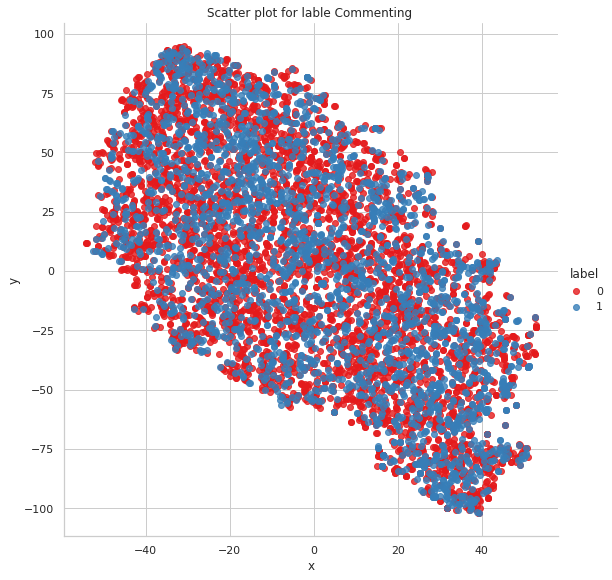

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


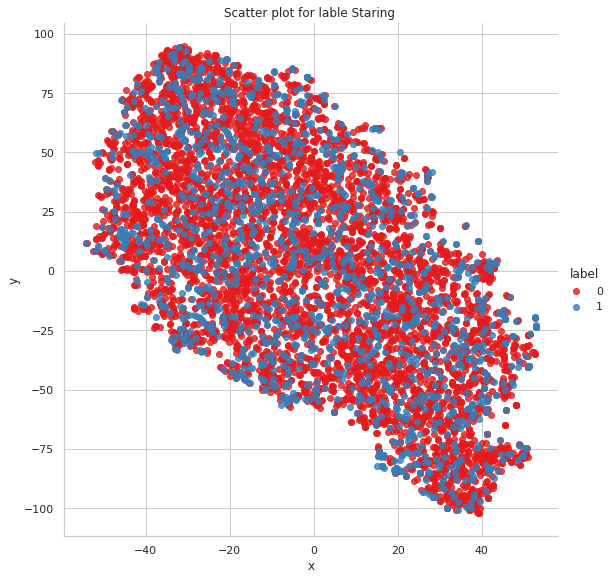

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


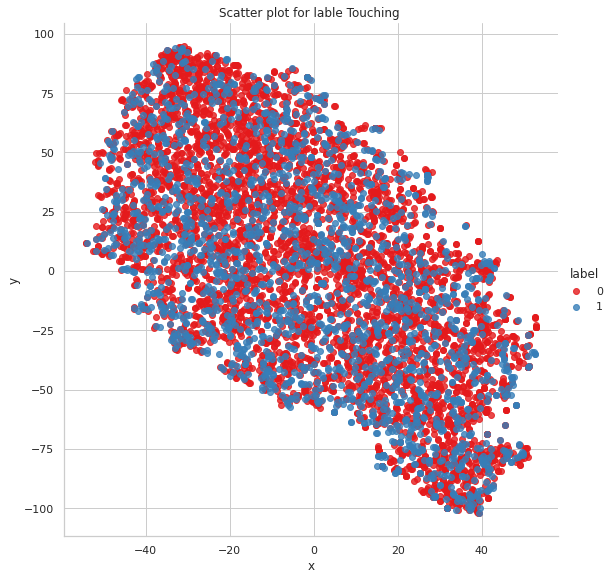

In [133]:
# TSNE plot for BERT
TSNE_plot(X_train_pooled_output)

# Models fuctions

In [134]:
from sklearn import tree

def dession_tree(x_train,x_test):

  print('Model metric for Dession tree model\n\n')

  # Traing the model and calculating the metric class Commenting.
  
  clf = tree.DecisionTreeClassifier()
  clf.fit(x_train, data.Commenting)
  predictions_1 = clf.predict(x_train)

  print('Train accuracy for data_commenting\n\n')

  print("accuracy :",metrics.accuracy_score(data.Commenting,predictions_1))
  print("macro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Commenting,predictions_1))
  print('\n\n')

  acc_train_com = metrics.accuracy_score(data.Commenting,predictions_1)
  f1_train_bi_com_ma = metrics.f1_score(data.Commenting, predictions_1, average = 'macro')
  f1_train_bi_com_mi = metrics.f1_score(data.Commenting, predictions_1, average = 'micro')
  f1_train_com_ham = metrics.hamming_loss(data.Commenting,predictions_1)
  print('\n\n')


  predictions_1_test = clf.predict(x_test)
  print('Test accuracy for data_commenting\n')
  print("accuracy_test :",metrics.accuracy_score(data_test.Commenting,predictions_1_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Commenting,predictions_1_test))
  print('\n\n')

  acc_test_com= metrics.accuracy_score(data_test.Commenting,predictions_1_test)
  f1_test_bi_com_ma = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro')
  f1_test_bi_com_mi = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro')
  f1_test_com_ham = metrics.hamming_loss(data_test.Commenting,predictions_1_test)
  print('\n\n')


  # Traing the model and calculating the metric class Touching.

  clf = tree.DecisionTreeClassifier()
  clf.fit(x_train, data.touching)

  predictions_2 = clf.predict(x_train)
  print('Train accuracy for data_touching\n')

  print("accuracy :",metrics.accuracy_score(data.touching,predictions_2))
  print("macro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.touching,predictions_2))
  print('\n\n')

  acc_train_tou = metrics.accuracy_score(data.touching,predictions_2)
  f1_train_bi_tou_ma = metrics.f1_score(data.touching, predictions_2, average = 'macro')
  f1_train_bi_tou_mi = metrics.f1_score(data.touching, predictions_2, average = 'micro')
  f1_train_tou_ham = metrics.hamming_loss(data.touching,predictions_2)



  predictions_2_test = clf.predict(x_test)
  print('Test accuracy for data_touching\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.touching,predictions_2_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.touching,predictions_2_test))
  print('\n\n')

  acc_test_tou = metrics.accuracy_score(data_test.touching,predictions_2_test)
  f1_test_bi_tou_ma = metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro')
  f1_test_bi_tou_mi = metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro')
  f1_test_tou_ham = metrics.hamming_loss(data_test.touching,predictions_2_test)


  # Traing the model and calculating the metric class Staring.

  clf = tree.DecisionTreeClassifier()
  clf.fit(x_train, data.Staring)
  predictions_3 = clf.predict(x_train)
  print('Train accuracy for data_staring\n')

  print("accuracy :",metrics.accuracy_score(data.Staring,predictions_3))
  print("macro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Staring,predictions_3))
  print('\n\n')

  acc_train_sta = metrics.accuracy_score(data.Staring,predictions_3)
  f1_train_bi_sta_ma = metrics.f1_score(data.Staring, predictions_3, average = 'macro')
  f1_train_bi_sta_mi = metrics.f1_score(data.Staring, predictions_3, average = 'micro')
  f1_train_sta_ham = metrics.hamming_loss(data.Staring,predictions_3)

  predictions_3_test = clf.predict(x_test)
  print('Test accuracy for data_staring\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Staring,predictions_3_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Staring,predictions_3_test))
  print('\n\n')


  acc_test_sta = metrics.accuracy_score(data_test.Staring,predictions_3_test)
  f1_test_bi_sta_ma = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro')
  f1_test_bi_sta_mi = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro')
  f1_test_sta_ham = metrics.hamming_loss(data_test.Staring,predictions_3_test)


  # Calculating mean mertic of all multiclass lable for Train

  acc_mean_bi_tri_bert_train = np.mean((acc_train_sta,acc_train_tou,acc_train_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_ma,f1_train_bi_tou_ma,f1_train_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_mi,f1_train_bi_tou_mi,f1_train_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_train = np.mean((f1_train_sta_ham,f1_train_tou_ham,f1_train_com_ham),dtype=np.float64)


  # Calculating mean mertic of all multiclass lable  for test

  acc_mean_bi_tri_bert_test = np.mean((acc_test_sta,acc_test_tou,acc_test_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_ma,f1_test_bi_tou_ma,f1_test_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_mi,f1_test_bi_tou_mi,f1_test_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_test = np.mean((f1_test_sta_ham,f1_test_tou_ham,f1_test_com_ham),dtype=np.float64)

  print('Mean accuracy for train data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_train,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_train, ' mean_f1_score_micro : ',f1_micro_mean_bi_tri_bert_train,' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_train)
  print('\n\n')

  print('Mean accuracy for test data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_test,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_test,' mean_f1_micro : ',f1_micro_mean_bi_tri_bert_test, ' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_test)
  print('\n\n')

  return acc_mean_bi_tri_bert_train,f1_macro_mean_bi_tri_bert_train,f1_micro_mean_bi_tri_bert_train,f1_hamming_mean_bi_tri_bert_train,acc_mean_bi_tri_bert_test,f1_macro_mean_bi_tri_bert_test,f1_micro_mean_bi_tri_bert_test,f1_hamming_mean_bi_tri_bert_test



  
  




In [135]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.linear_model import SGDClassifier
import sklearn.metrics as metrics
import pickle






def SGD_model(x_train,x_test):

  print('Model metric for SGD model\n\n')

  # Traing the model and calculating the metric class Commenting.

  classifier = OneVsRestClassifier(SGDClassifier(loss='log', alpha=0.00001, penalty='l1'), n_jobs=-1)
  classifier.fit(x_train, data.Commenting)

  predictions_1 = classifier.predict(x_train)

  # my_var = x_train  
  # my_var_name = [ k for k,v in locals().items() if v == my_var][0]
  # my_var_name
 
  
  joblib.dump(classifier,'commenting.pkl')

  print('Train accuracy for data_commenting\n')

  print("accuracy :",metrics.accuracy_score(data.Commenting,predictions_1))
  print("macro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Commenting,predictions_1))
  print('\n\n')

  acc_train_com = metrics.accuracy_score(data.Commenting,predictions_1)
  f1_train_bi_com_ma = metrics.f1_score(data.Commenting, predictions_1, average = 'macro')
  f1_train_bi_com_mi = metrics.f1_score(data.Commenting, predictions_1, average = 'micro')
  f1_train_com_ham = metrics.hamming_loss(data.Commenting,predictions_1)


  predictions_1_test = classifier.predict(x_test)
  print('Test accuracy for data_commenting\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Commenting,predictions_1_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Commenting,predictions_1_test))
  print('\n\n')

  acc_test_com= metrics.accuracy_score(data_test.Commenting,predictions_1_test)
  f1_test_bi_com_ma = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro')
  f1_test_bi_com_mi = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro')
  f1_test_com_ham = metrics.hamming_loss(data_test.Commenting,predictions_1_test)


  # Traing the model and calculating the metric class Touching.

  classifier = OneVsRestClassifier(SGDClassifier(loss='log', alpha=0.00001, penalty='l1'), n_jobs=-1)
  classifier.fit(x_train, data.touching)

 

  joblib.dump(classifier, 'touching.pkl')

  predictions_2 = classifier.predict(x_train)

  print('Train accuracy for data_touching\n')

  print("accuracy :",metrics.accuracy_score(data.touching,predictions_2))
  print("macro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.touching,predictions_2))
  print('\n\n')

  acc_train_tou = metrics.accuracy_score(data.touching,predictions_2)
  f1_train_bi_tou_ma = metrics.f1_score(data.touching, predictions_2, average = 'macro')
  f1_train_bi_tou_mi = metrics.f1_score(data.touching, predictions_2, average = 'micro')
  f1_train_tou_ham = metrics.hamming_loss(data.touching,predictions_2)



  predictions_2_test = classifier.predict(x_test)

  print('Test accuracy for data_touching\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.touching,predictions_2_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.touching,predictions_2_test))
  print('\n\n')

  acc_test_tou = metrics.accuracy_score(data_test.touching,predictions_2_test)
  f1_test_bi_tou_ma = metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro')
  f1_test_bi_tou_mi = metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro')
  f1_test_tou_ham = metrics.hamming_loss(data_test.touching,predictions_2_test)


  # Traing the model and calculating the metric class Staring.

  classifier = OneVsRestClassifier(SGDClassifier(loss='log', alpha=0.00001, penalty='l1'), n_jobs=-1)
  classifier.fit(x_train, data.Staring)

  
  joblib.dump(classifier,'staring.pkl')
  predictions_3 = classifier.predict(x_train)

  print('Train accuracy for data_staring\n')

  print("accuracy :",metrics.accuracy_score(data.Staring,predictions_3))
  print("macro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Staring,predictions_3))
  print('\n\n')

  acc_train_sta = metrics.accuracy_score(data.Staring,predictions_3)
  f1_train_bi_sta_ma = metrics.f1_score(data.Staring, predictions_3, average = 'macro')
  f1_train_bi_sta_mi = metrics.f1_score(data.Staring, predictions_3, average = 'micro')
  f1_train_sta_ham = metrics.hamming_loss(data.Staring,predictions_3)

  predictions_3_test = classifier.predict(x_test)

  print('Test accuracy for data_staring\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Staring,predictions_3_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Staring,predictions_3_test))
  print('\n\n')

  acc_test_sta = metrics.accuracy_score(data_test.Staring,predictions_3_test)
  f1_test_bi_sta_ma = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro')
  f1_test_bi_sta_mi = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro')
  f1_test_sta_ham = metrics.hamming_loss(data_test.Staring,predictions_3_test)


  # Calculating mean mertic of all multiclass lable for Train

  acc_mean_bi_tri_bert_train = np.mean((acc_train_sta,acc_train_tou,acc_train_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_ma,f1_train_bi_tou_ma,f1_train_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_mi,f1_train_bi_tou_mi,f1_train_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_train = np.mean((f1_train_sta_ham,f1_train_tou_ham,f1_train_com_ham),dtype=np.float64)


  # Calculating mean mertic of all multiclass lable  for test

  acc_mean_bi_tri_bert_test = np.mean((acc_test_sta,acc_test_tou,acc_test_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_ma,f1_test_bi_tou_ma,f1_test_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_mi,f1_test_bi_tou_mi,f1_test_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_test = np.mean((f1_test_sta_ham,f1_test_tou_ham,f1_test_com_ham),dtype=np.float64)


  print('Mean accuracy for train data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_train,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_train, ' mean_f1_score_micro : ',f1_micro_mean_bi_tri_bert_train,' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_train)
  print('\n\n')

  print('Mean accuracy for test data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_test,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_test,' mean_f1_micro : ',f1_micro_mean_bi_tri_bert_test, ' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_test)
  print('\n\n')

  return acc_mean_bi_tri_bert_train,f1_macro_mean_bi_tri_bert_train,f1_micro_mean_bi_tri_bert_train,f1_hamming_mean_bi_tri_bert_train,acc_mean_bi_tri_bert_test,f1_macro_mean_bi_tri_bert_test,f1_micro_mean_bi_tri_bert_test,f1_hamming_mean_bi_tri_bert_test



  
  




In [136]:
sgd_tf_w2v=SGD_model(tfidf_w2v_vectors_tr,tfidf_w2v_vectors_tr_test)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.7686800894854586
macro f1 score : 0.7566295080515508
micro f1 score : 0.7686800894854586
hamming loss : 0.2313199105145414



Test accuracy for data_commenting

accuracy_test : 0.7353658536585366
macro f1 score_test : 0.7208482172972448
micro f1 score_test : 0.7353658536585366
hamming loss_test : 0.2646341463414634



Train accuracy for data_touching

accuracy : 0.8174496644295302
macro f1 score : 0.7470642275123821
micro f1 score : 0.8174496644295302
hamming loss : 0.1825503355704698



Test accuracy for data_touching

accuracy_test : 0.7926829268292683
macro f1 score_test : 0.7184742678614344
micro f1 score_test : 0.7926829268292683
hamming loss_test : 0.2073170731707317



Train accuracy for data_staring

accuracy : 0.7919463087248322
macro f1 score : 0.6392795274319715
micro f1 score : 0.7919463087248322
hamming loss : 0.2080536912751678



Test accuracy for data_staring

accuracy_test : 0.766463414634146

In [137]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.naive_bayes import GaussianNB
import sklearn.metrics as metrics





def Naive_base_model(x_train,x_test):

  # Traing the model and calculating the metric class Commenting.

  print('Model metric for Naive Base model\n\n')

  classifier = GaussianNB()
  classifier.fit(x_train, data.Commenting)

  predictions_1 = classifier.predict(x_train)
  print('Train accuracy for data_commenting\n')

  print("accuracy :",metrics.accuracy_score(data.Commenting,predictions_1))
  print("macro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Commenting,predictions_1))
  print('\n\n')

  acc_train_com = metrics.accuracy_score(data.Commenting,predictions_1)
  f1_train_bi_com_ma = metrics.f1_score(data.Commenting, predictions_1, average = 'macro')
  f1_train_bi_com_mi = metrics.f1_score(data.Commenting, predictions_1, average = 'micro')
  f1_train_com_ham = metrics.hamming_loss(data.Commenting,predictions_1)


  predictions_1_test = classifier.predict(x_test)
  print('Test accuracy for data_commenting\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Commenting,predictions_1_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Commenting,predictions_1_test))
  print('\n\n')

  acc_test_com= metrics.accuracy_score(data_test.Commenting,predictions_1_test)
  f1_test_bi_com_ma = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro')
  f1_test_bi_com_mi = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro')
  f1_test_com_ham = metrics.hamming_loss(data_test.Commenting,predictions_1_test)


  # Traing the model and calculating the metric class Touching.


  classifier = GaussianNB()
  classifier.fit(x_train, data.touching)

  predictions_2 = classifier.predict(x_train)

  print('Train accuracy for data_touching\n')

  print("accuracy :",metrics.accuracy_score(data.touching,predictions_2))
  print("macro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.touching,predictions_2))
  print('\n\n')

  acc_train_tou = metrics.accuracy_score(data.touching,predictions_2)
  f1_train_bi_tou_ma = metrics.f1_score(data.touching, predictions_2, average = 'macro')
  f1_train_bi_tou_mi = metrics.f1_score(data.touching, predictions_2, average = 'micro')
  f1_train_tou_ham = metrics.hamming_loss(data.touching,predictions_2)



  predictions_2_test = classifier.predict(x_test)

  print('Test accuracy for data_touching\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.touching,predictions_2_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.touching,predictions_2_test))
  print('\n\n')

  acc_test_tou = metrics.accuracy_score(data_test.touching,predictions_2_test)
  f1_test_bi_tou_ma = metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro')
  f1_test_bi_tou_mi = metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro')
  f1_test_tou_ham = metrics.hamming_loss(data_test.touching,predictions_2_test)


  # Traing the model and calculating the metric class Staring.

  classifier = GaussianNB()
  classifier.fit(x_train, data.Staring)

  predictions_3 = classifier.predict(x_train)

  print('Train accuracy for data_staring\n')

  print("accuracy :",metrics.accuracy_score(data.Staring,predictions_3))
  print("macro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Staring,predictions_3))
  print('\n\n')

  acc_train_sta = metrics.accuracy_score(data.Staring,predictions_3)
  f1_train_bi_sta_ma = metrics.f1_score(data.Staring, predictions_3, average = 'macro')
  f1_train_bi_sta_mi = metrics.f1_score(data.Staring, predictions_3, average = 'micro')
  f1_train_sta_ham = metrics.hamming_loss(data.Staring,predictions_3)

  predictions_3_test = classifier.predict(x_test)

  print('Test accuracy for data_staring\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Staring,predictions_3_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Staring,predictions_3_test))
  print('\n\n')

  acc_test_sta = metrics.accuracy_score(data_test.Staring,predictions_3_test)
  f1_test_bi_sta_ma = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro')
  f1_test_bi_sta_mi = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro')
  f1_test_sta_ham = metrics.hamming_loss(data_test.Staring,predictions_3_test)


  # Calculating mean mertic of all multiclass lable for Train

  acc_mean_bi_tri_bert_train = np.mean((acc_train_sta,acc_train_tou,acc_train_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_ma,f1_train_bi_tou_ma,f1_train_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_mi,f1_train_bi_tou_mi,f1_train_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_train = np.mean((f1_train_sta_ham,f1_train_tou_ham,f1_train_com_ham),dtype=np.float64)


  # Calculating mean mertic of all multiclass lable  for test

  acc_mean_bi_tri_bert_test = np.mean((acc_test_sta,acc_test_tou,acc_test_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_ma,f1_test_bi_tou_ma,f1_test_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_mi,f1_test_bi_tou_mi,f1_test_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_test = np.mean((f1_test_sta_ham,f1_test_tou_ham,f1_test_com_ham),dtype=np.float64)


  print('Mean accuracy for train data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_train,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_train, ' mean_f1_score_micro : ',f1_micro_mean_bi_tri_bert_train,' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_train)
  print('\n\n')

  print('Mean accuracy for test data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_test,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_test,' mean_f1_micro : ',f1_micro_mean_bi_tri_bert_test, ' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_test)
  print('\n\n')

  return acc_mean_bi_tri_bert_train,f1_macro_mean_bi_tri_bert_train,f1_micro_mean_bi_tri_bert_train,f1_hamming_mean_bi_tri_bert_train,acc_mean_bi_tri_bert_test,f1_macro_mean_bi_tri_bert_test,f1_micro_mean_bi_tri_bert_test,f1_hamming_mean_bi_tri_bert_test



  
  




In [138]:
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.ensemble import RandomForestClassifier
import sklearn.metrics as metrics





def Random_forest(x_train,x_test):


  # Traing the model and calculating the metric class Commenting.

  print('Model metric for Naive Base model\n\n')

  classifier = RandomForestClassifier(max_depth=2, random_state=0)
  classifier.fit(x_train, data.Commenting)

  predictions_1 = classifier.predict(x_train)
  print('Train accuracy for data_commenting\n')

  print("accuracy :",metrics.accuracy_score(data.Commenting,predictions_1))
  print("macro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Commenting, predictions_1, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Commenting,predictions_1))
  print('\n\n')

  acc_train_com = metrics.accuracy_score(data.Commenting,predictions_1)
  f1_train_bi_com_ma = metrics.f1_score(data.Commenting, predictions_1, average = 'macro')
  f1_train_bi_com_mi = metrics.f1_score(data.Commenting, predictions_1, average = 'micro')
  f1_train_com_ham = metrics.hamming_loss(data.Commenting,predictions_1)
  

  predictions_1_test = classifier.predict(x_test)
  print('Test accuracy for data_commenting\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Commenting,predictions_1_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Commenting,predictions_1_test))
  print('\n\n')

  acc_test_com= metrics.accuracy_score(data_test.Commenting,predictions_1_test)
  f1_test_bi_com_ma = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'macro')
  f1_test_bi_com_mi = metrics.f1_score(data_test.Commenting, predictions_1_test, average = 'micro')
  f1_test_com_ham = metrics.hamming_loss(data_test.Commenting,predictions_1_test)



  # Traing the model and calculating the metric class Touching.

  classifier = RandomForestClassifier(max_depth=2, random_state=0)
  classifier.fit(x_train, data.touching)

  predictions_2 = classifier.predict(x_train)

  print('Train accuracy for data_touching\n')

  print("accuracy :",metrics.accuracy_score(data.touching,predictions_2))
  print("macro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.touching, predictions_2, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.touching,predictions_2))
  print('\n\n')

  acc_train_tou = metrics.accuracy_score(data.touching,predictions_2)
  f1_train_bi_tou_ma = metrics.f1_score(data.touching, predictions_2, average = 'macro')
  f1_train_bi_tou_mi = metrics.f1_score(data.touching, predictions_2, average = 'micro')
  f1_train_tou_ham = metrics.hamming_loss(data.touching,predictions_2)



  predictions_2_test = classifier.predict(x_test)

  print('Test accuracy for data_touching\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.touching,predictions_2_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.touching,predictions_2_test))
  print('\n\n')

  acc_test_tou = metrics.accuracy_score(data_test.touching,predictions_2_test)
  f1_test_bi_tou_ma = metrics.f1_score(data_test.touching, predictions_2_test, average = 'macro')
  f1_test_bi_tou_mi = metrics.f1_score(data_test.touching, predictions_2_test, average = 'micro')
  f1_test_tou_ham = metrics.hamming_loss(data_test.touching,predictions_2_test)


  # Traing the model and calculating the metric class Staring.

  classifier = RandomForestClassifier(max_depth=2, random_state=0)
  classifier.fit(x_train, data.Staring)

  predictions_3 = classifier.predict(x_train)

  print('Train accuracy for data_staring\n')

  print("accuracy :",metrics.accuracy_score(data.Staring,predictions_3))
  print("macro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'macro'))
  print("micro f1 score :",metrics.f1_score(data.Staring, predictions_3, average = 'micro'))
  print("hamming loss :",metrics.hamming_loss(data.Staring,predictions_3))
  print('\n\n')

  acc_train_sta = metrics.accuracy_score(data.Staring,predictions_3)
  f1_train_bi_sta_ma = metrics.f1_score(data.Staring, predictions_3, average = 'macro')
  f1_train_bi_sta_mi = metrics.f1_score(data.Staring, predictions_3, average = 'micro')
  f1_train_sta_ham = metrics.hamming_loss(data.Staring,predictions_3)

  predictions_3_test = classifier.predict(x_test)

  print('Test accuracy for data_staring\n')

  print("accuracy_test :",metrics.accuracy_score(data_test.Staring,predictions_3_test))
  print("macro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro'))
  print("micro f1 score_test :",metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro'))
  print("hamming loss_test :",metrics.hamming_loss(data_test.Staring,predictions_3_test))
  print('\n\n')

  acc_test_sta = metrics.accuracy_score(data_test.Staring,predictions_3_test)
  f1_test_bi_sta_ma = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'macro')
  f1_test_bi_sta_mi = metrics.f1_score(data_test.Staring, predictions_3_test, average = 'micro')
  f1_test_sta_ham = metrics.hamming_loss(data_test.Staring,predictions_3_test)


  # Calculating mean mertic of all multiclass lable for Train

  acc_mean_bi_tri_bert_train = np.mean((acc_train_sta,acc_train_tou,acc_train_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_ma,f1_train_bi_tou_ma,f1_train_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_train = np.mean((f1_train_bi_sta_mi,f1_train_bi_tou_mi,f1_train_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_train = np.mean((f1_train_sta_ham,f1_train_tou_ham,f1_train_com_ham),dtype=np.float64)


  # Calculating mean mertic of all multiclass lable  for test

  acc_mean_bi_tri_bert_test = np.mean((acc_test_sta,acc_test_tou,acc_test_com),dtype=np.float64)
  f1_macro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_ma,f1_test_bi_tou_ma,f1_test_bi_com_ma),dtype=np.float64)
  f1_micro_mean_bi_tri_bert_test = np.mean((f1_test_bi_sta_mi,f1_test_bi_tou_mi,f1_test_bi_com_mi),dtype=np.float64)
  f1_hamming_mean_bi_tri_bert_test = np.mean((f1_test_sta_ham,f1_test_tou_ham,f1_test_com_ham),dtype=np.float64)


  print('Mean accuracy for train data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_train,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_train, ' mean_f1_score_micro : ',f1_micro_mean_bi_tri_bert_train,' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_train)
  print('\n\n')

  print('Mean accuracy for test data\n')

  print(' mean_accuracy : ',acc_mean_bi_tri_bert_test,' mean_f1_score_macro : ',f1_macro_mean_bi_tri_bert_test,' mean_f1_micro : ',f1_micro_mean_bi_tri_bert_test, ' mean_hamming_loss : ',f1_hamming_mean_bi_tri_bert_test)
  print('\n\n')

  return acc_mean_bi_tri_bert_train,f1_macro_mean_bi_tri_bert_train,f1_micro_mean_bi_tri_bert_train,f1_hamming_mean_bi_tri_bert_train,acc_mean_bi_tri_bert_test,f1_macro_mean_bi_tri_bert_test,f1_micro_mean_bi_tri_bert_test,f1_hamming_mean_bi_tri_bert_test



  
  




#Models for tf_idf_w2v vectors

In [139]:
tree_tf_w2v=dession_tree(tfidf_w2v_vectors_tr,tfidf_w2v_vectors_tr_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9777777777777777
macro f1 score : 0.9763563646757847
micro f1 score : 0.9777777777777777
hamming loss : 0.022222222222222223






Test accuracy for data_commenting

accuracy_test : 0.6439024390243903
macro f1 score_test : 0.6245868636759884
micro f1 score_test : 0.6439024390243903
hamming loss_test : 0.35609756097560974






Train accuracy for data_touching

accuracy : 0.9853840417598807
macro f1 score : 0.9823839937099365
micro f1 score : 0.9853840417598807
hamming loss : 0.014615958240119313



Test accuracy for data_touching

accuracy_test : 0.6932926829268292
macro f1 score_test : 0.6293891876276765
micro f1 score_test : 0.6932926829268292
hamming loss_test : 0.3067073170731707



Train accuracy for data_staring

accuracy : 0.9789709172259508
macro f1 score : 0.9669100055262869
micro f1 score : 0.9789709172259508
hamming loss : 0.021029082774049218



Test accuracy for data_staring

accuracy_t

In [140]:
sgd_tf_w2v=SGD_model(tfidf_w2v_vectors_tr,tfidf_w2v_vectors_tr_test)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.7618195376584639
macro f1 score : 0.7168532635510689
micro f1 score : 0.7618195376584639
hamming loss : 0.23818046234153617



Test accuracy for data_commenting

accuracy_test : 0.7597560975609756
macro f1 score_test : 0.7187825865943864
micro f1 score_test : 0.7597560975609756
hamming loss_test : 0.24024390243902438



Train accuracy for data_touching

accuracy : 0.7955257270693512
macro f1 score : 0.6896710343596673
micro f1 score : 0.7955257270693512
hamming loss : 0.20447427293064876



Test accuracy for data_touching

accuracy_test : 0.7823170731707317
macro f1 score_test : 0.6781504811965845
micro f1 score_test : 0.7823170731707317
hamming loss_test : 0.2176829268292683



Train accuracy for data_staring

accuracy : 0.752572706935123
macro f1 score : 0.6365797973417543
micro f1 score : 0.752572706935123
hamming loss : 0.24742729306487696



Test accuracy for data_staring

accuracy_test : 0.7268292682926

In [141]:
naive_tf_w2v = Naive_base_model(tfidf_w2v_vectors_tr,tfidf_w2v_vectors_tr_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.7225950782997763
macro f1 score : 0.6852711977910007
micro f1 score : 0.7225950782997763
hamming loss : 0.27740492170022374



Test accuracy for data_commenting

accuracy_test : 0.7121951219512195
macro f1 score_test : 0.6739007716041581
micro f1 score_test : 0.7121951219512196
hamming loss_test : 0.28780487804878047



Train accuracy for data_touching

accuracy : 0.7111111111111111
macro f1 score : 0.691463502503352
micro f1 score : 0.7111111111111111
hamming loss : 0.28888888888888886



Test accuracy for data_touching

accuracy_test : 0.697560975609756
macro f1 score_test : 0.6780220267386114
micro f1 score_test : 0.697560975609756
hamming loss_test : 0.3024390243902439



Train accuracy for data_staring

accuracy : 0.7017151379567487
macro f1 score : 0.5720241540503684
micro f1 score : 0.7017151379567487
hamming loss : 0.29828486204325133



Test accuracy for data_staring

accuracy_test : 0.6786585

In [142]:
Random_forest_tf_w2v=Random_forest(tfidf_w2v_vectors_tr,tfidf_w2v_vectors_tr_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.6513049962714392
macro f1 score : 0.47724552839108514
micro f1 score : 0.6513049962714392
hamming loss : 0.34869500372856077



Test accuracy for data_commenting

accuracy_test : 0.6567073170731708
macro f1 score_test : 0.4816859409304302
micro f1 score_test : 0.6567073170731708
hamming loss_test : 0.3432926829268293



Train accuracy for data_touching

accuracy : 0.7069351230425056
macro f1 score : 0.43805614275640675
micro f1 score : 0.7069351230425056
hamming loss : 0.2930648769574944



Test accuracy for data_touching

accuracy_test : 0.6957317073170731
macro f1 score_test : 0.4324476337305146
micro f1 score_test : 0.6957317073170731
hamming loss_test : 0.3042682926829268



Train accuracy for data_staring

accuracy : 0.7959731543624161
macro f1 score : 0.45447603187819674
micro f1 score : 0.7959731543624161
hamming loss : 0.2040268456375839



Test accuracy for data_staring

accuracy_test : 0.7829

#Models for BERT vector as input

In [143]:
tree_bert=dession_tree(X_train_pooled_output,X_test_pooled_output)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9861297539149888
macro f1 score : 0.9852855702311416
micro f1 score : 0.9861297539149888
hamming loss : 0.013870246085011185






Test accuracy for data_commenting

accuracy_test : 0.6353658536585366
macro f1 score_test : 0.6120563481904244
micro f1 score_test : 0.6353658536585366
hamming loss_test : 0.3646341463414634






Train accuracy for data_touching

accuracy : 0.9904548844146159
macro f1 score : 0.9885563923024031
micro f1 score : 0.9904548844146159
hamming loss : 0.009545115585384041



Test accuracy for data_touching

accuracy_test : 0.6408536585365854
macro f1 score_test : 0.57018299126759
micro f1 score_test : 0.6408536585365854
hamming loss_test : 0.3591463414634146



Train accuracy for data_staring

accuracy : 0.9864280387770321
macro f1 score : 0.978917295281324
micro f1 score : 0.9864280387770321
hamming loss : 0.013571961222967934



Test accuracy for data_staring

accuracy_test 

In [144]:
sgd_bert=SGD_model(X_train_pooled_output,X_test_pooled_output)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.7718120805369127
macro f1 score : 0.7508934534537801
micro f1 score : 0.7718120805369127
hamming loss : 0.22818791946308725



Test accuracy for data_commenting

accuracy_test : 0.7189024390243902
macro f1 score_test : 0.6945578008678785
micro f1 score_test : 0.7189024390243902
hamming loss_test : 0.2810975609756098



Train accuracy for data_touching

accuracy : 0.81834451901566
macro f1 score : 0.778458345766758
micro f1 score : 0.8183445190156601
hamming loss : 0.18165548098434003



Test accuracy for data_touching

accuracy_test : 0.7707317073170732
macro f1 score_test : 0.7264241348713398
micro f1 score_test : 0.7707317073170732
hamming loss_test : 0.22926829268292684



Train accuracy for data_staring

accuracy : 0.8190902311707681
macro f1 score : 0.6698527348998036
micro f1 score : 0.8190902311707681
hamming loss : 0.1809097688292319



Test accuracy for data_staring

accuracy_test : 0.764024390243902

In [145]:
naive_bert = Naive_base_model(X_train_pooled_output,X_test_pooled_output)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.5743475018642804
macro f1 score : 0.5730261411646811
micro f1 score : 0.5743475018642804
hamming loss : 0.4256524981357196



Test accuracy for data_commenting

accuracy_test : 0.5792682926829268
macro f1 score_test : 0.5781081528474343
micro f1 score_test : 0.5792682926829268
hamming loss_test : 0.42073170731707316



Train accuracy for data_touching

accuracy : 0.5255779269202088
macro f1 score : 0.5124067897074572
micro f1 score : 0.5255779269202088
hamming loss : 0.4744220730797912



Test accuracy for data_touching

accuracy_test : 0.5158536585365854
macro f1 score_test : 0.5068166083150653
micro f1 score_test : 0.5158536585365854
hamming loss_test : 0.4841463414634146



Train accuracy for data_staring

accuracy : 0.22281879194630871
macro f1 score : 0.1959360241344233
micro f1 score : 0.22281879194630871
hamming loss : 0.7771812080536913



Test accuracy for data_staring

accuracy_test : 0.22987

In [146]:
Random_forest_bert=Random_forest(X_train_pooled_output,X_test_pooled_output)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.6284862043251305
macro f1 score : 0.41673102459628236
micro f1 score : 0.6284862043251305
hamming loss : 0.3715137956748695



Test accuracy for data_commenting

accuracy_test : 0.6378048780487805
macro f1 score_test : 0.431464828977225
micro f1 score_test : 0.6378048780487805
hamming loss_test : 0.3621951219512195



Train accuracy for data_touching

accuracy : 0.6999254287844892
macro f1 score : 0.4117389015616775
micro f1 score : 0.6999254287844892
hamming loss : 0.3000745712155108



Test accuracy for data_touching

accuracy_test : 0.6884146341463414
macro f1 score_test : 0.4077284218129288
micro f1 score_test : 0.6884146341463414
hamming loss_test : 0.31158536585365854



Train accuracy for data_staring

accuracy : 0.7937360178970917
macro f1 score : 0.4425043651783487
micro f1 score : 0.7937360178970917
hamming loss : 0.20626398210290828



Test accuracy for data_staring

accuracy_test : 0.781097

In [147]:
!pip install textstat
from textstat.textstat import textstat

import textstat

data["word_count"] = data["stemed"].apply(lambda x: len(x.split(" ")))
data["avg_word_length"] = data["stemed"].apply(lambda x: np.mean([len(word) for word in x.split(" ")]))
data["difficult_words_score"] = data["stemed"].apply(lambda x: textstat.difficult_words(x))
data["flesch_reading_ease"] = data["stemed"].apply(lambda x: textstat.flesch_reading_ease(x))
data["flesch_kincaid_grade"] = data["stemed"].apply(lambda x: textstat.flesch_kincaid_grade(x))
data["coleman_liau_index"] = data["stemed"].apply(lambda x: textstat.coleman_liau_index(x))



     |████████████████████████████████| 101 kB 7.3 MB/s 
     |████████████████████████████████| 2.0 MB 51.7 MB/s 


In [148]:
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
pos_re = {"noun":re.compile('N.*'), "verb":re.compile('V.*'),
          "adverb":re.compile('R.*'), "adjective":re.compile('J.*'),
          "pronoun":re.compile('J.*')}
def count_POS(text, part_of_speech):
  count = 0
  for word, pos in nltk.pos_tag(word_tokenize(text)):
    if re.match(pos_re[part_of_speech],pos):
      count += 1
  return count
data["noun_count"] = data["stemed"].apply(lambda x: count_POS(x,"noun"))
data["pronoun_count"] = data["stemed"].apply(lambda x: count_POS(x,"pronoun"))
data["verb_count"] = data["stemed"].apply(lambda x: count_POS(x,"verb"))
data["adverb_count"] = data["stemed"].apply(lambda x: count_POS(x,"adverb"))
data["adjective_count"] = data["stemed"].apply(lambda x: count_POS(x,"adjective"))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


In [149]:
data

,Description,Commenting,Staring,touching,stemed,single_lable,stemed_len,negative,neutral,positive,compound,idf_plus,idf_mul,remove_stemed,word_count,avg_word_length,difficult_words_score,flesch_reading_ease,flesch_kincaid_grade,coleman_liau_index,noun_count,pronoun_count,verb_count,adverb_count,adjective_count
0,was walking along crowded street holding sums...,0,0,1,walk along crowd street hold sum hand elder ma...,0,18,0.000,0.833,0.167,0.4939,4.446563,26.790928,along sum butt turn yrs,17,4.117647,0,96.52,4.0,6.32,7,5,3,1,5
1,this incident took place in the evening i was ...,0,1,0,incid took place even metro two guy start stare,1,9,0.000,1.000,0.000,0.0000,3.512121,11.759428,,9,4.333333,1,104.64,0.9,6.06,4,1,2,1,1
2,i as waiting or the us a an cam of a be and a...,1,0,0,wait cam offer liftvto young irl,2,7,0.000,1.000,0.000,0.0000,3.714501,11.394736,cam offer liftvto young irl,6,4.500000,1,90.77,2.1,5.27,3,2,1,0,2
3,incident happened inside the train,0,0,0,incid happen insid train,3,4,0.000,1.000,0.000,0.0000,2.894686,5.963872,,4,5.250000,2,50.50,7.2,7.25,3,0,1,0,0
4,i witnessed an incident when a chain was bruta...,0,0,0,wit incid chain brutal snatch elder ladi incid...,3,11,0.291,0.709,0.000,-0.6249,3.988859,17.117968,wit brutal,11,4.727273,3,68.77,6.4,8.97,8,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6700,there was this person near a construction site...,0,1,0,person near construct site probabl labor make ...,1,13,0.000,0.811,0.189,0.4215,4.333076,22.397354,construct site probabl labor kiss sound ...,13,5.076923,3,66.74,7.2,11.30,9,2,1,0,2
6701,he threatened me by making inappropriate conve...,1,0,0,threaten make inappropri convers threaten one ...,2,8,0.464,0.536,0.000,-0.6369,3.675154,12.459297,threaten convers threaten,8,6.875000,3,21.06,12.3,20.26,4,1,2,0,1
6702,happened during morning at university metro st...,1,0,0,happen morn univers metro station guy comment ...,2,8,0.000,0.843,0.157,0.0772,3.495025,10.932422,univers,8,5.375000,1,80.28,4.1,11.56,6,0,2,0,0
6703,one day my aunt was returned frm office haun...,0,0,0,one day aunt return frm offic haunt found one ...,3,24,0.222,0.677,0.102,-0.4939,4.709317,33.654827,aunt frm haunt gal frm aunt sort,21,3.904762,1,92.46,5.6,5.34,13,2,3,0,2


In [150]:
c=list(data.columns[14:])
c

['word_count',
 'avg_word_length',
 'difficult_words_score',
 'flesch_reading_ease',
 'flesch_kincaid_grade',
 'coleman_liau_index',
 'noun_count',
 'pronoun_count',
 'verb_count',
 'adverb_count',
 'adjective_count']

##**Violineplot** of new features

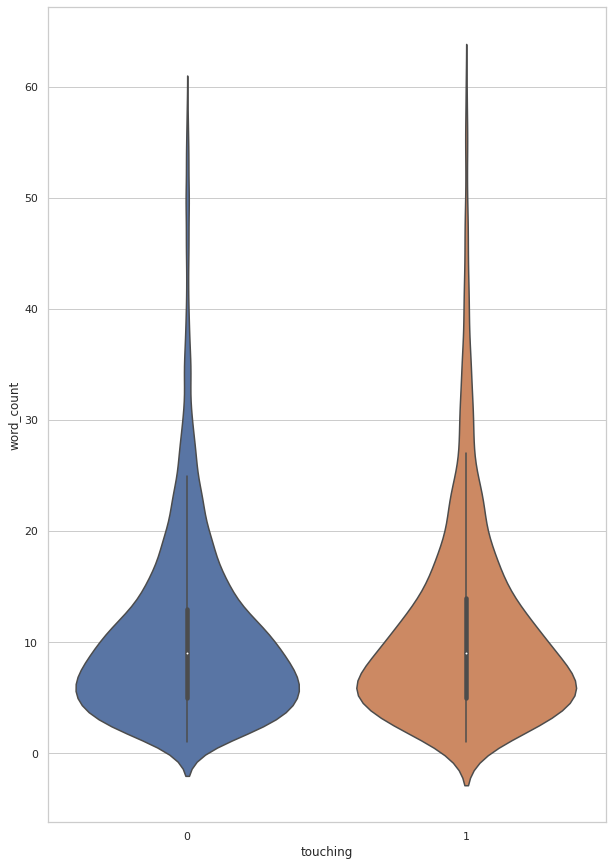

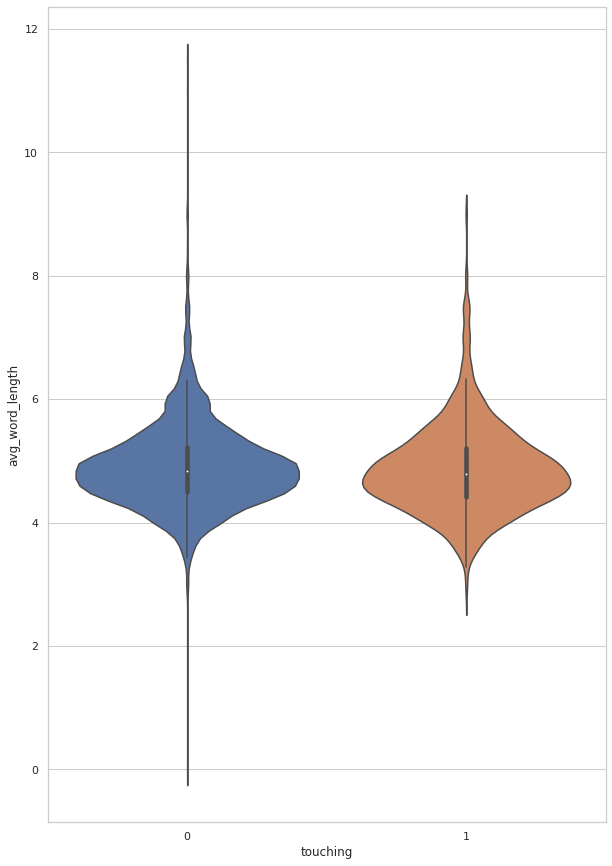

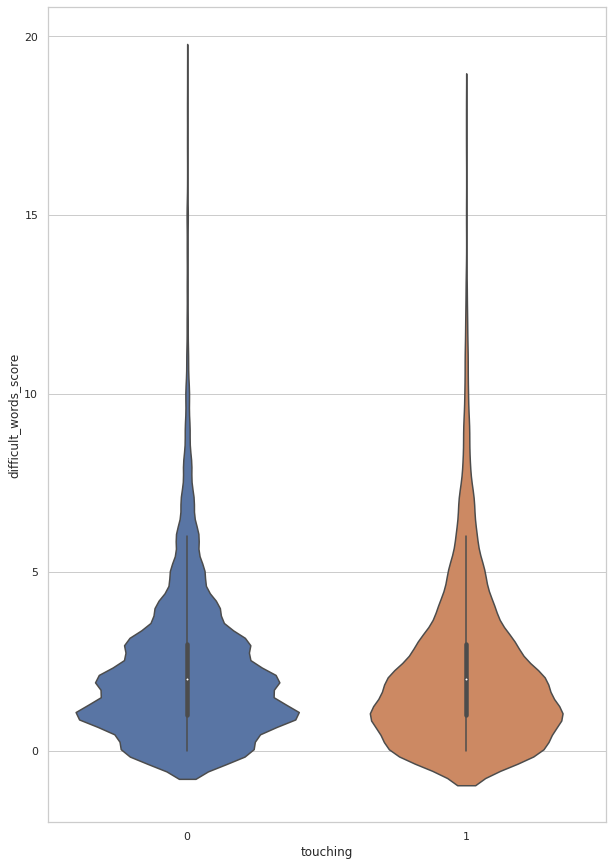

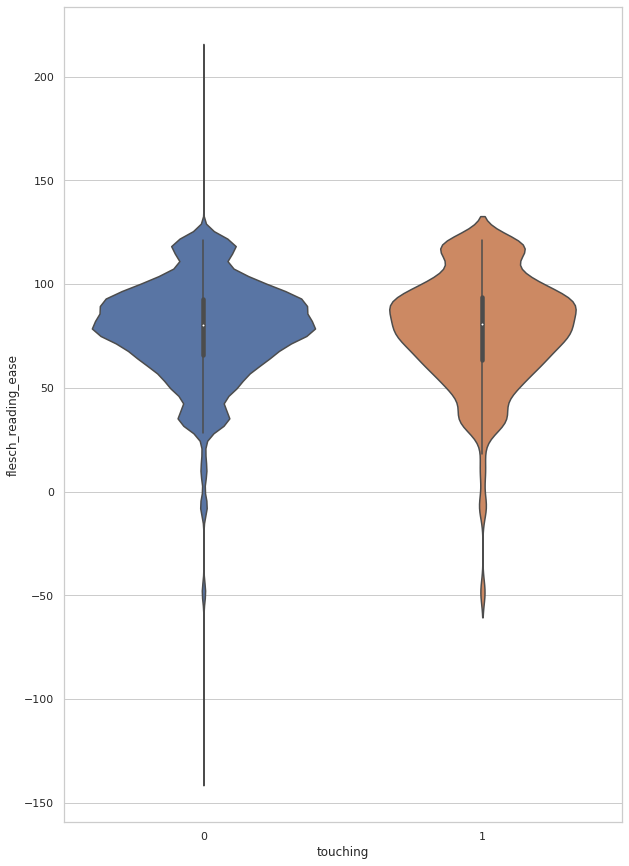

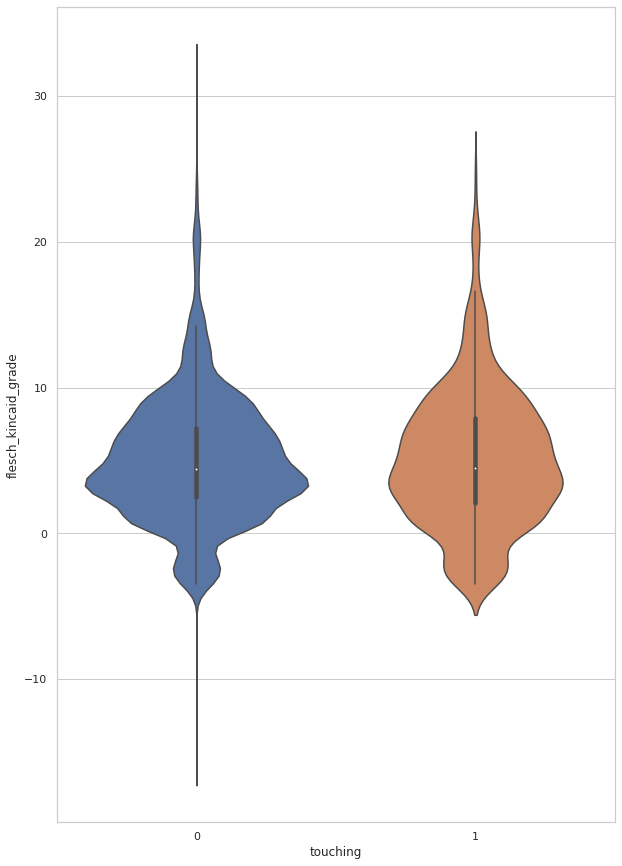

...

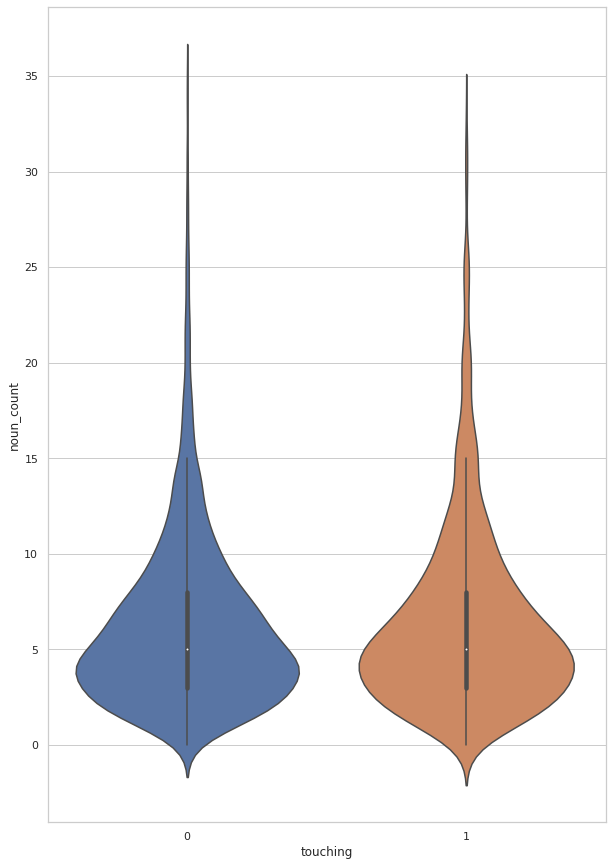

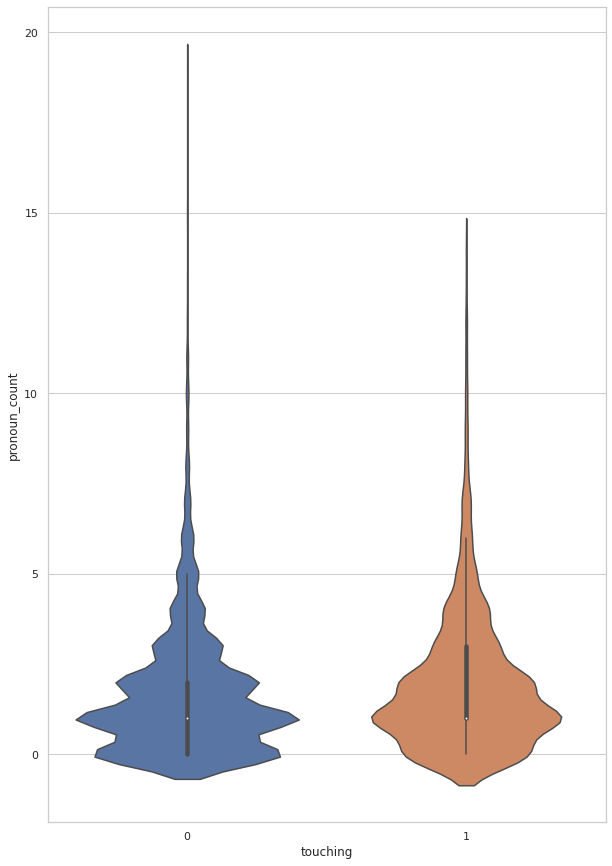

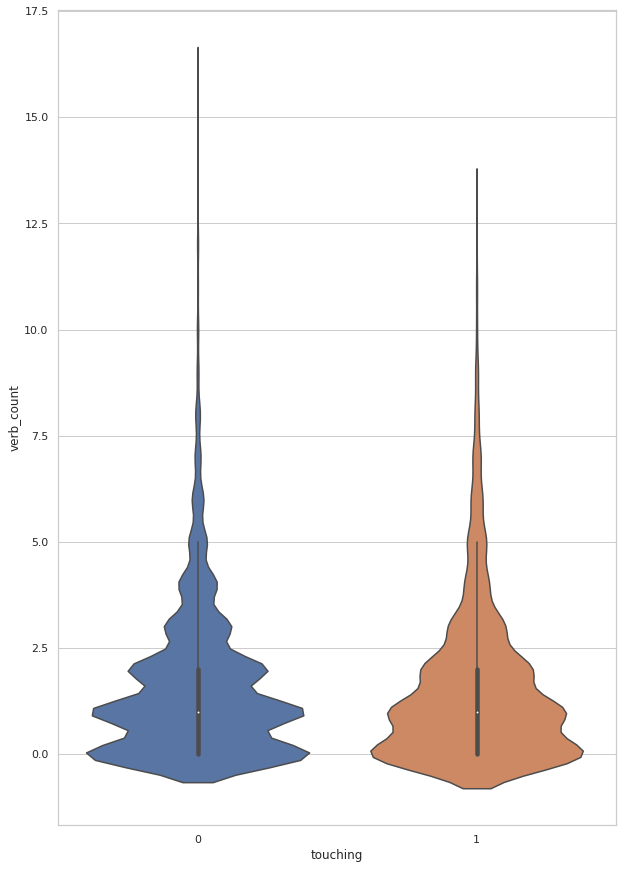

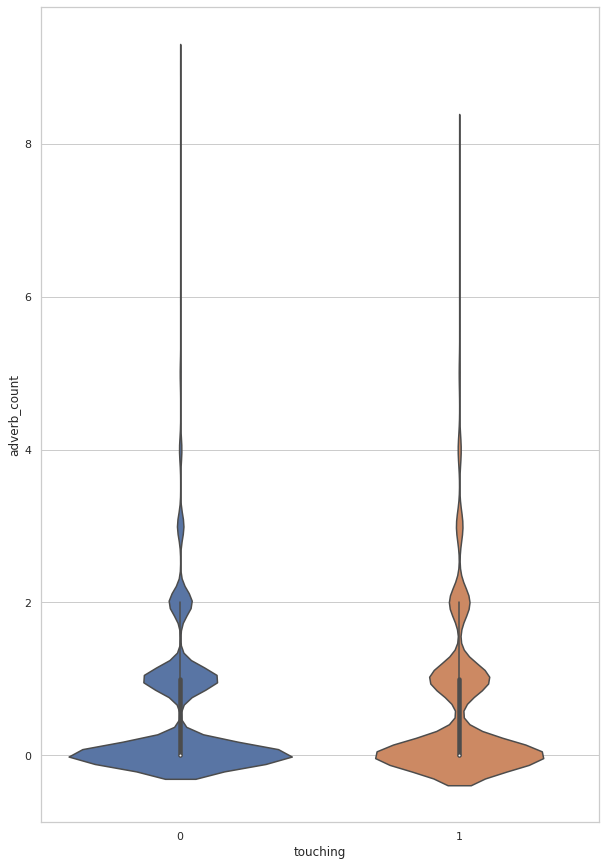

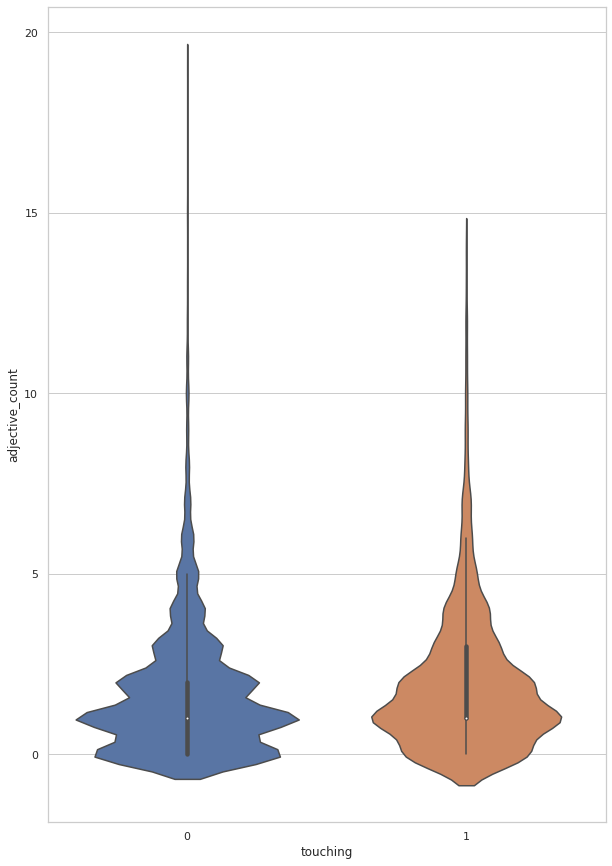

In [151]:
for i in c:
  plt.figure(figsize=(10,15))
  sns.set_theme(style="whitegrid")
  ax = sns.violinplot(x="touching", y=data[i], data=data)

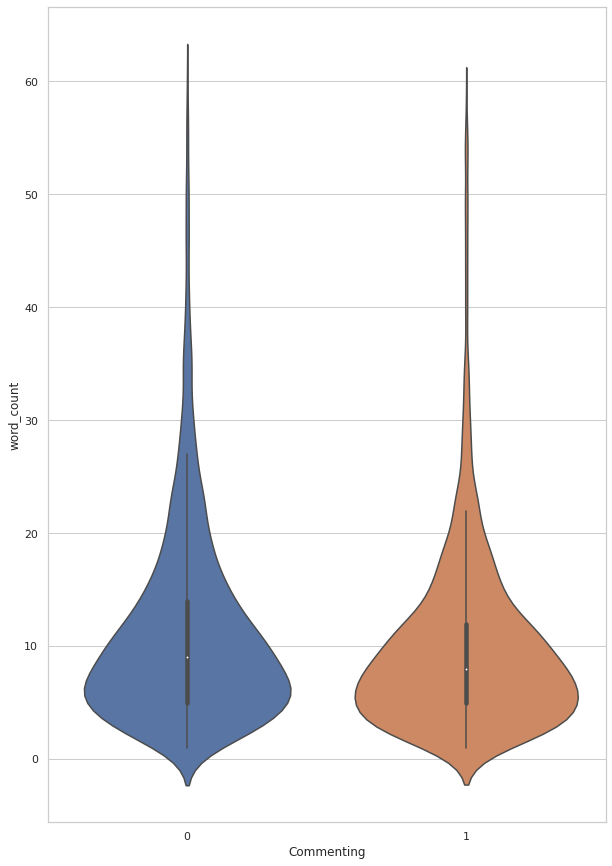

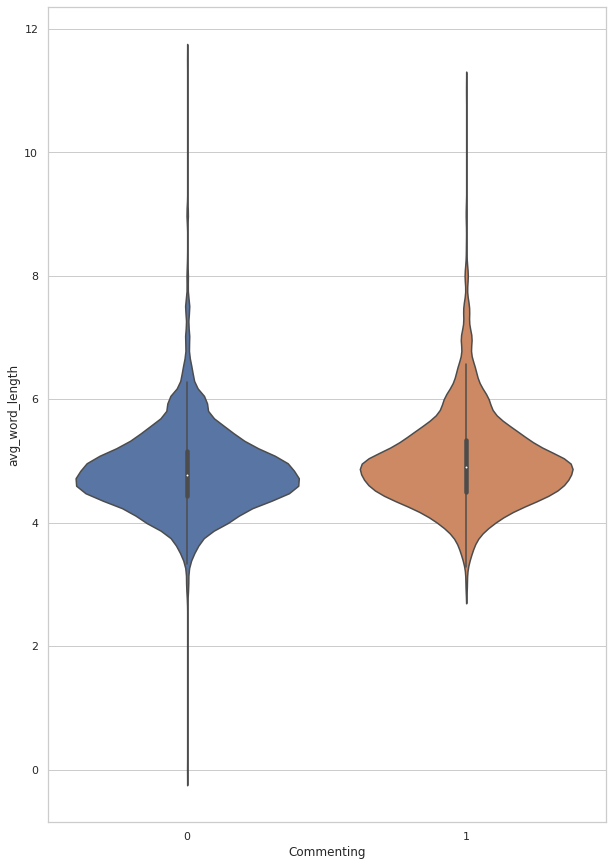

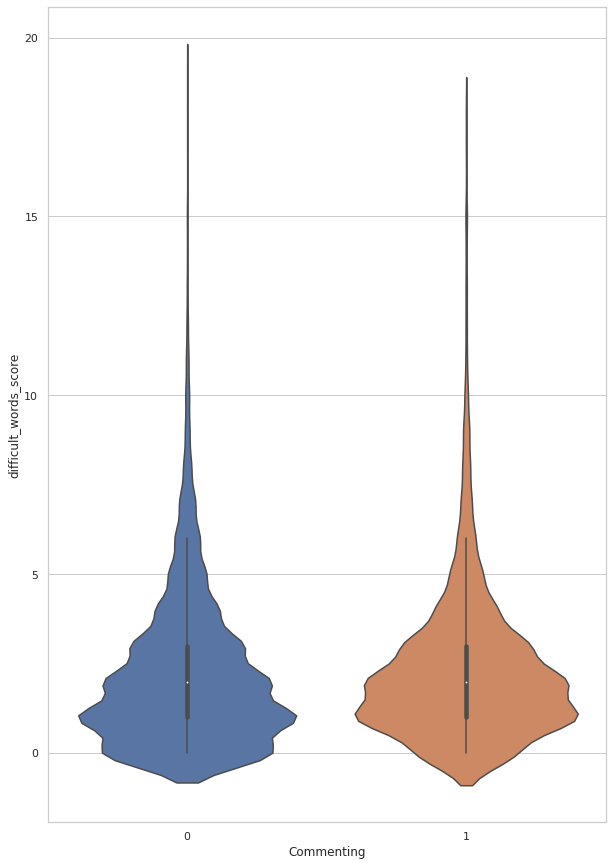

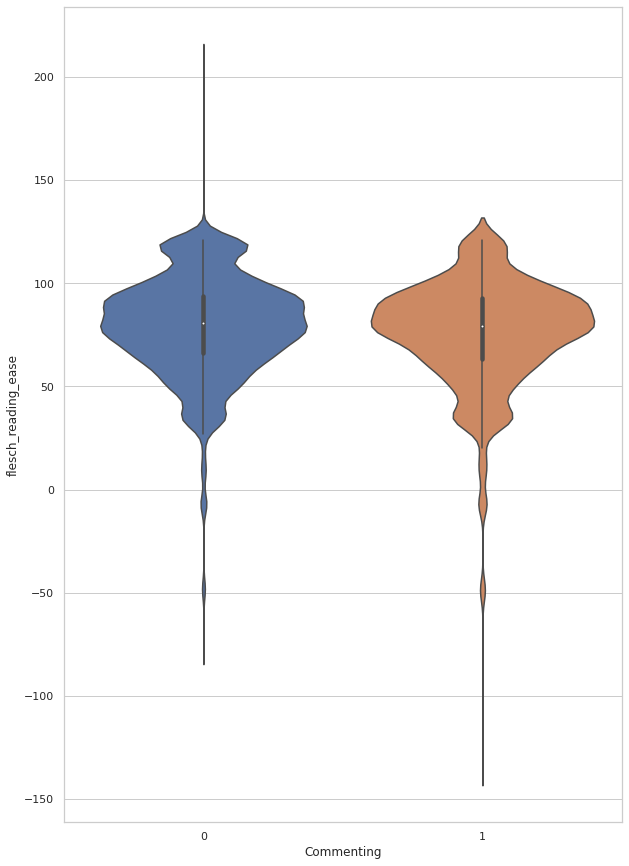

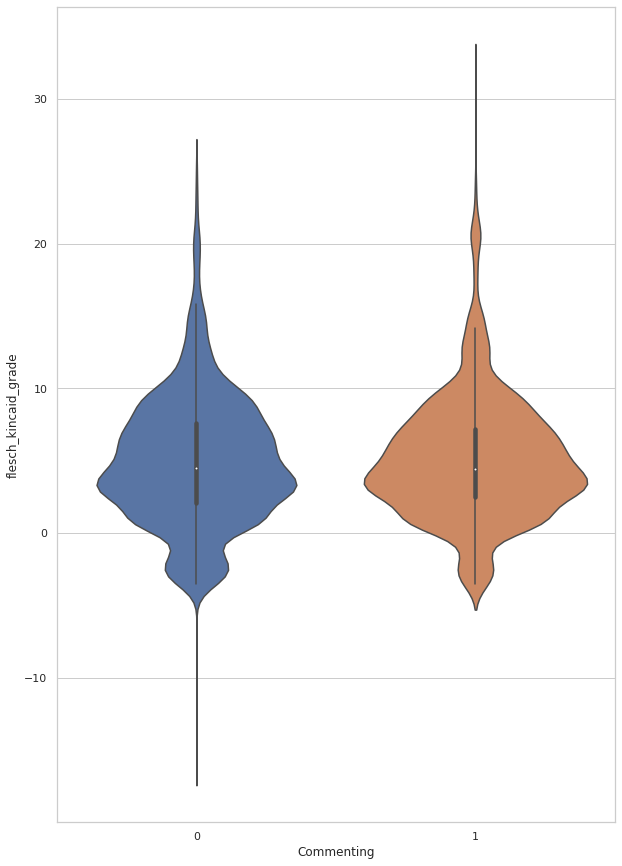

...

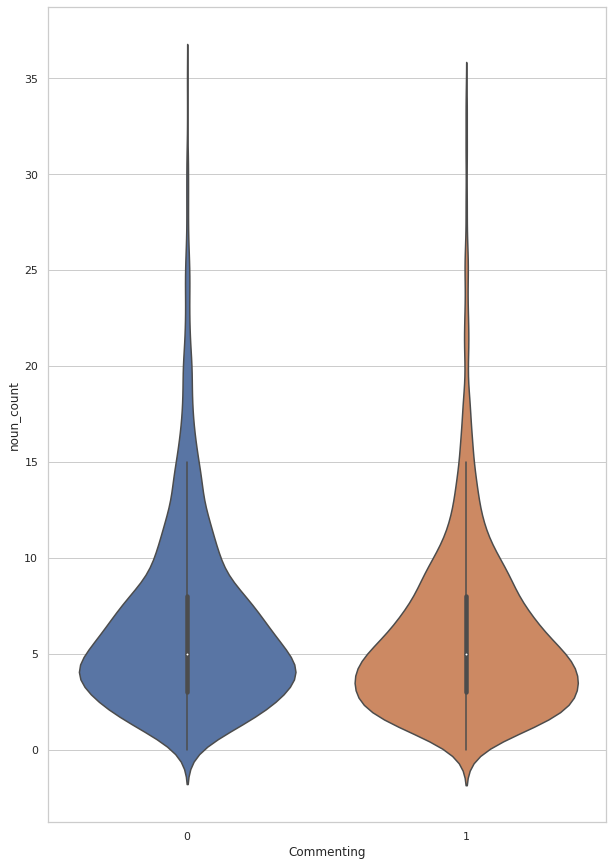

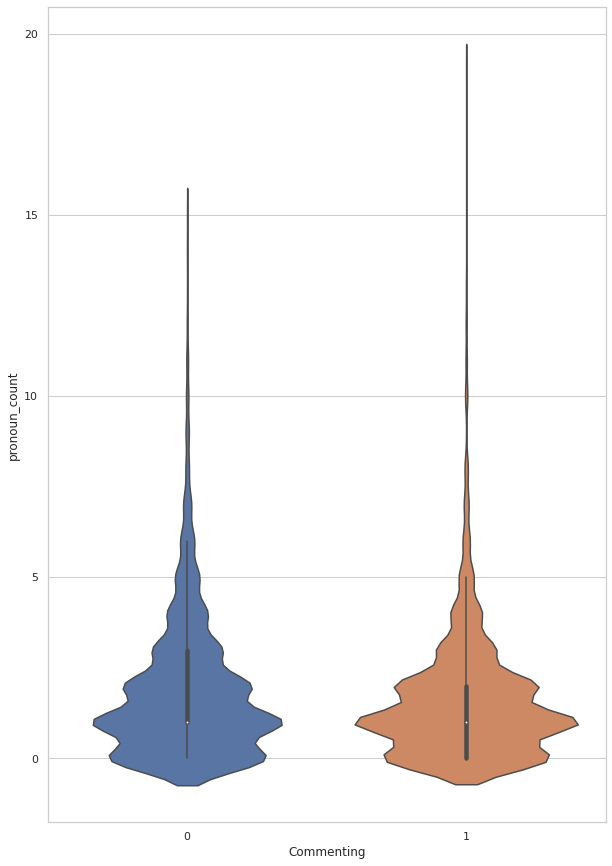

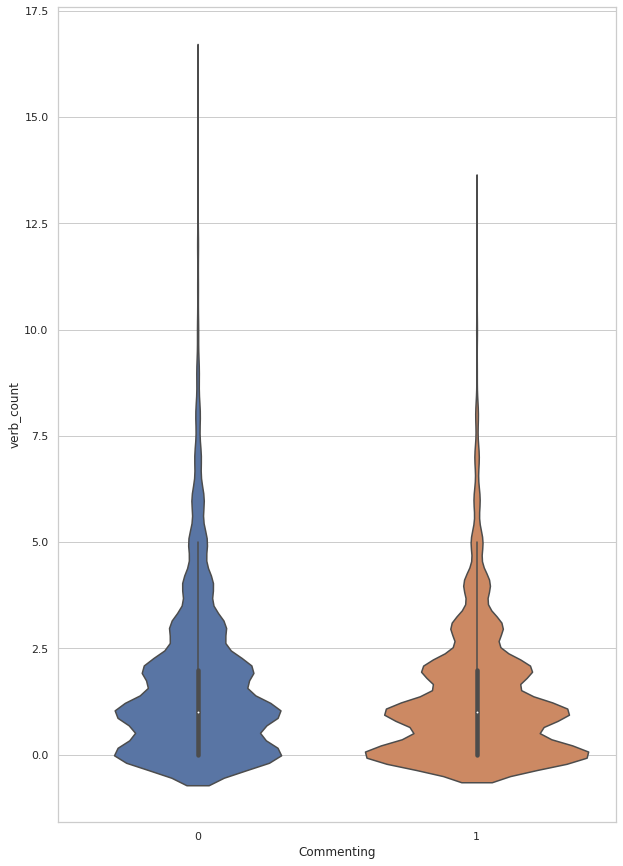

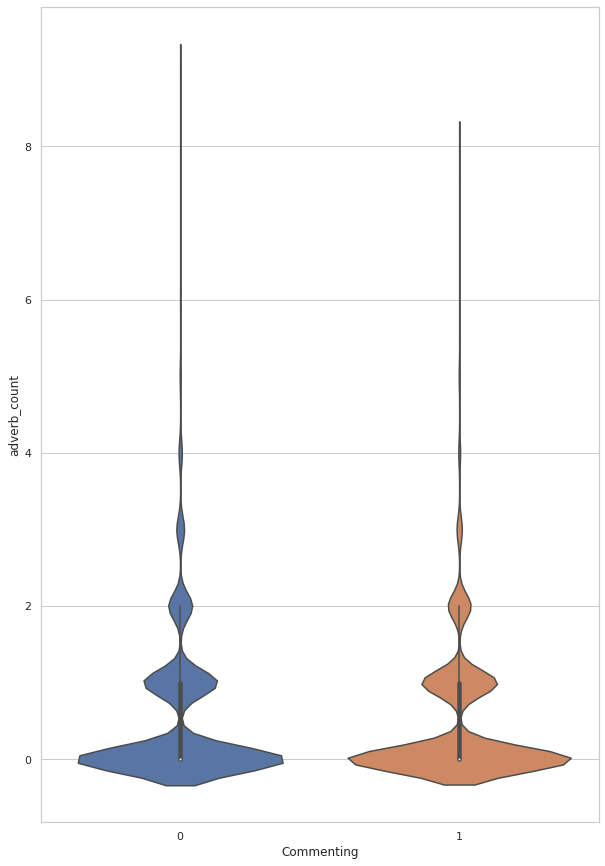

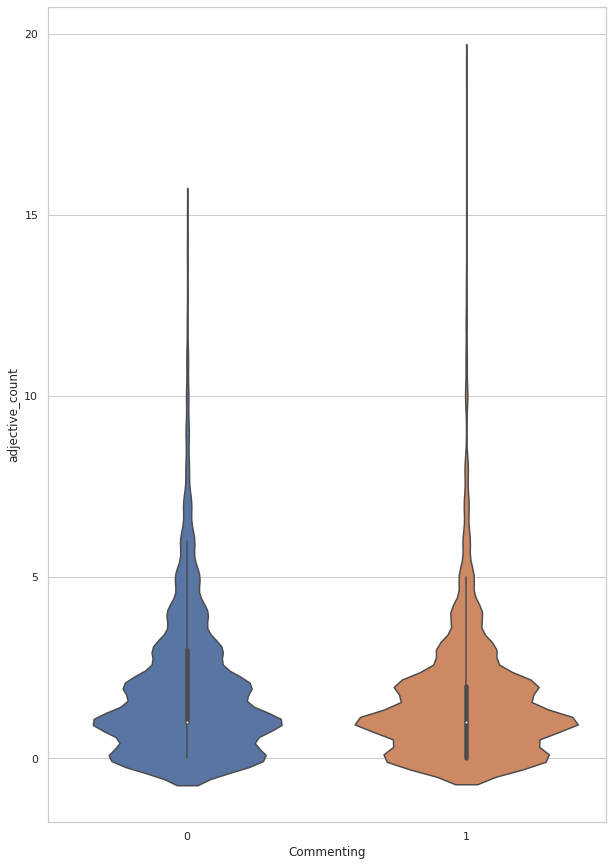

In [152]:
for i in c:
  plt.figure(figsize=(10,15))
  sns.set_theme(style="whitegrid")
  ax = sns.violinplot(x="Commenting", y=data[i], data=data)

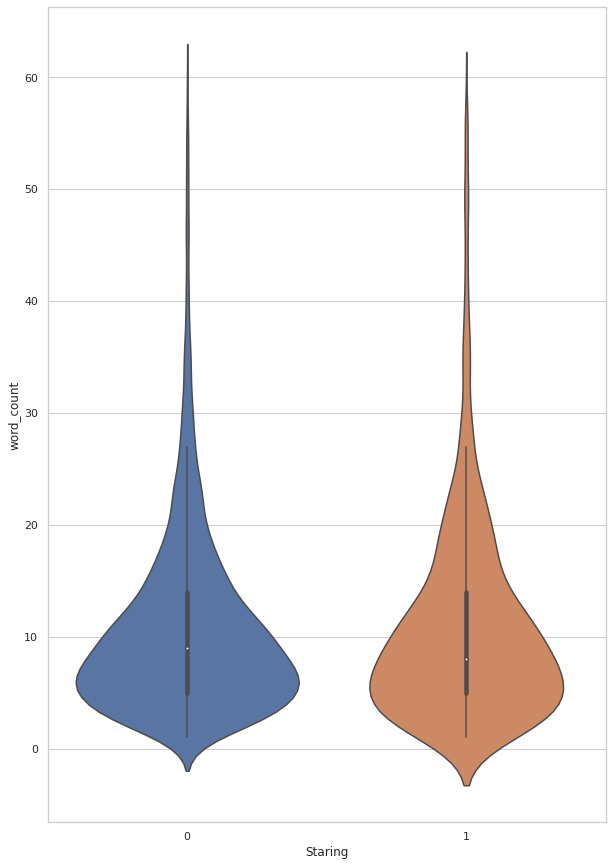

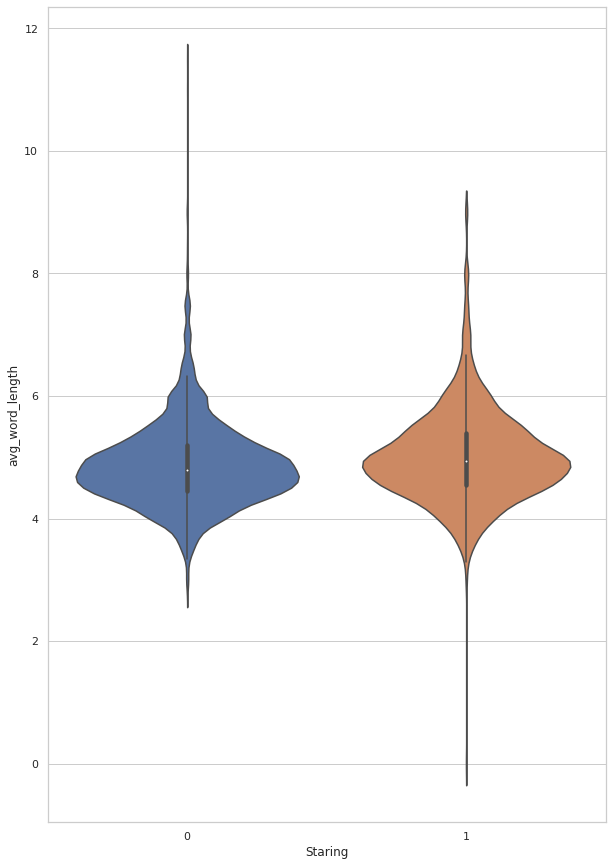

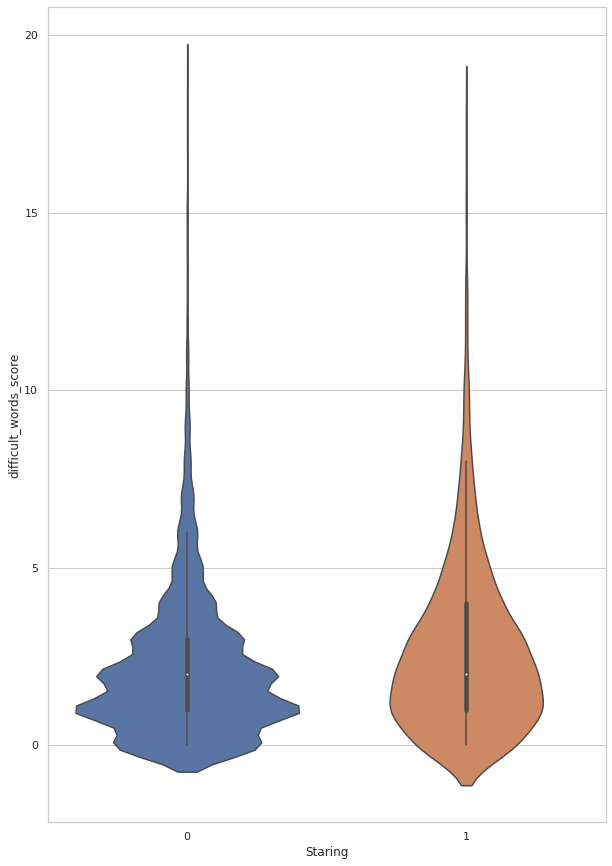

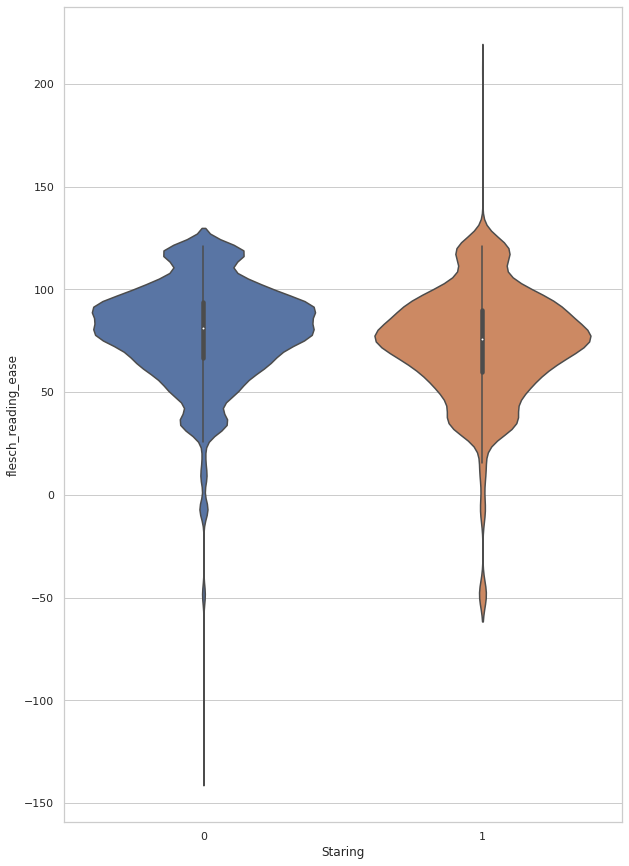

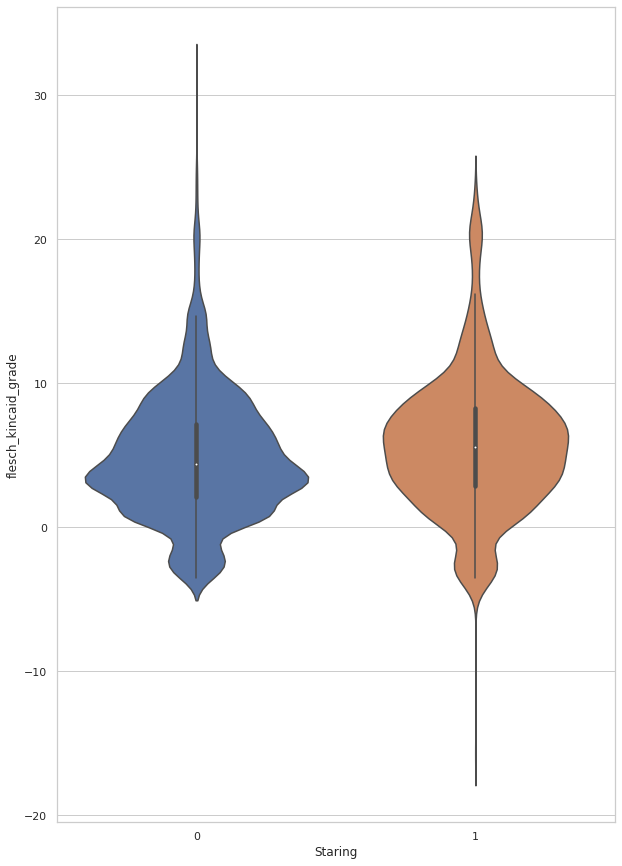

...

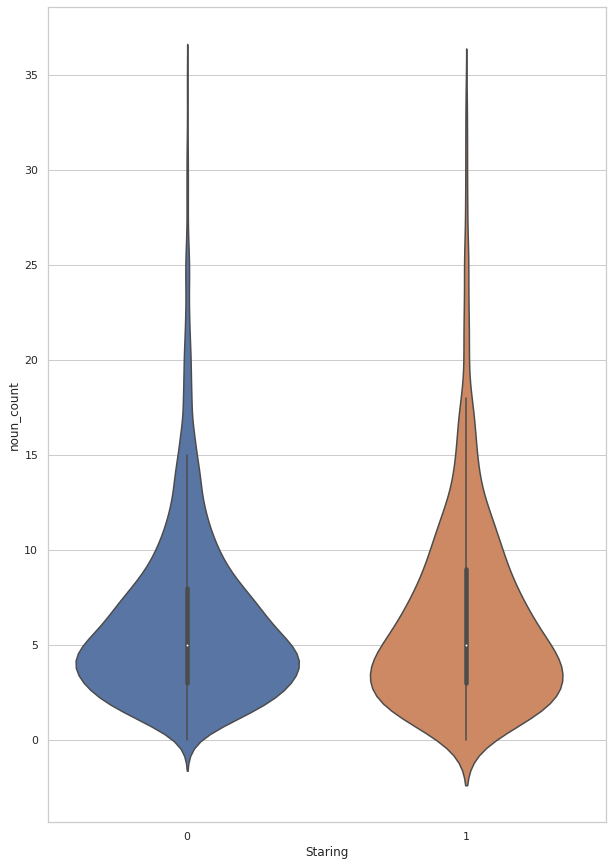

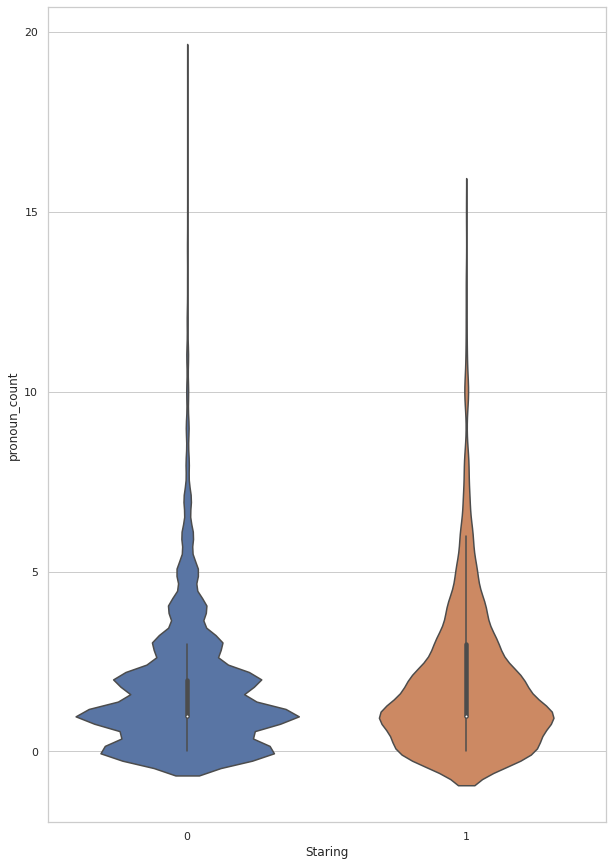

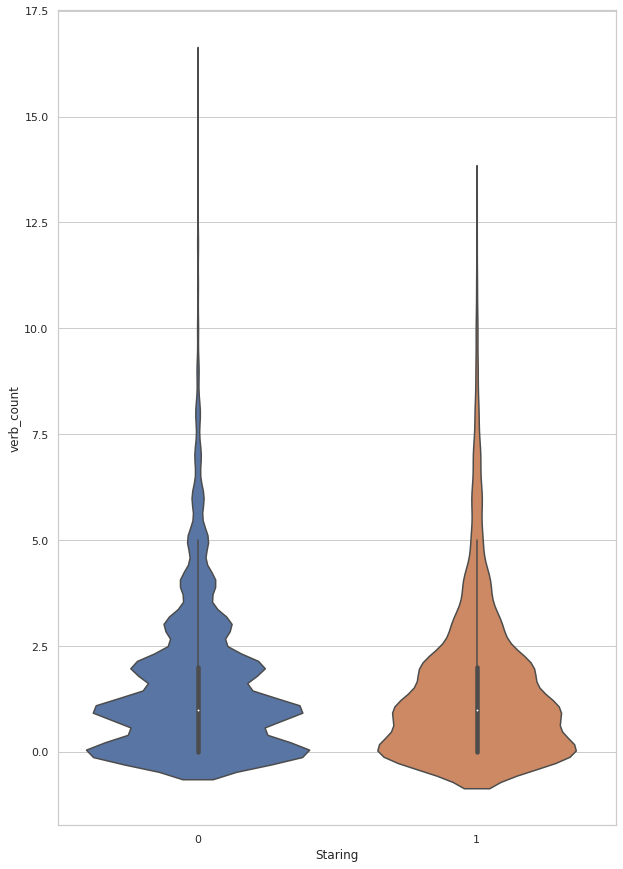

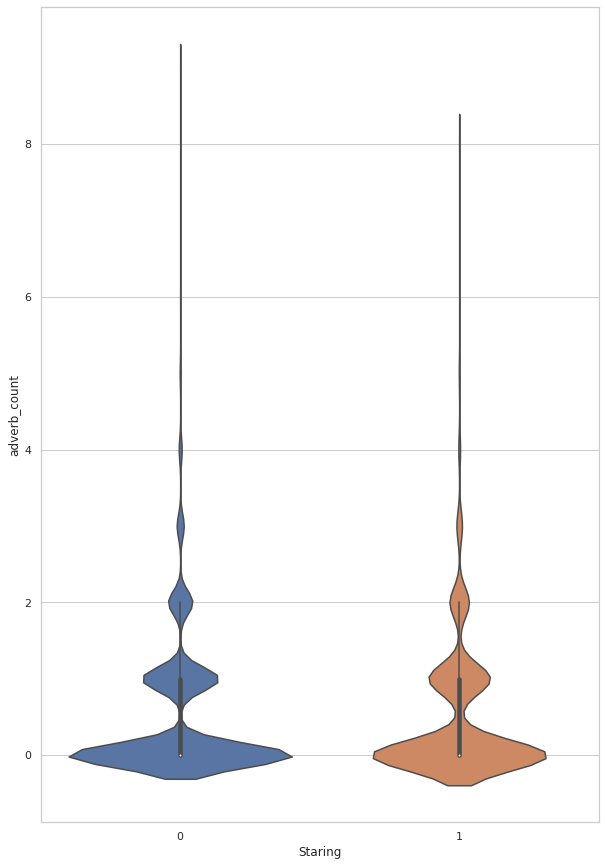

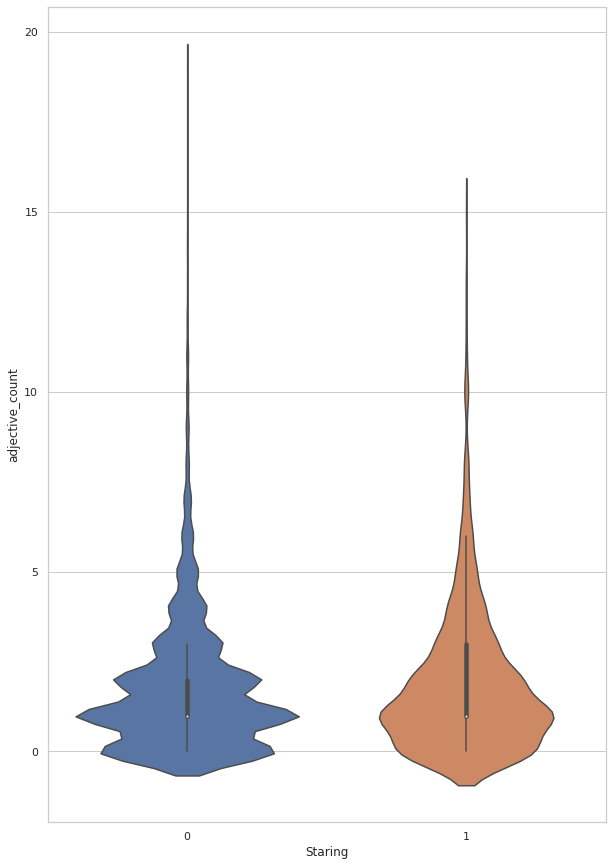

In [153]:
for i in c:
  plt.figure(figsize=(10,15))
  sns.set_theme(style="whitegrid")
  ax = sns.violinplot(x="Staring", y=data[i], data=data)

In [154]:
badreview = ''
for x in data[data['Commenting']==1]['stemed']:
        badreview= badreview+x



In [155]:
len(badreview)

146624

In [156]:
badreview_test = ''
for x in data_test[data_test['Commenting']==1]['stemed']:
        badreview_test=badreview_test+x



In [157]:
len(badreview_test)

35343

In [158]:
from nltk.util import ngrams
import collections

n = 2
sentence = badreview
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_commenting=collections.Counter(a)

   
  


In [159]:
from nltk.util import ngrams
import collections

n = 2
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_commenting_test=collections.Counter(a)

   
  


In [160]:
import more_itertools

counter_bi_commenting={k: v for k, v in sorted(counter_bi_commenting.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi_commenting.items())
print(len(first_n))
print(first_n)
print(len(counter_bi_commenting))

200
[('pass_comment', 107), ('group_boy', 98), ('took_place', 70), ('metro_station', 66), ('start_comment', 59), ('comment_girl', 54), ('boy_comment', 51), ('boy_start', 49), ('tri_touch', 49), ('take_pictur', 39), ('guy_comment', 38), ('guy_start', 37), ('boy_pass', 36), ('girl_pass', 36), ('pass_lead', 35), ('back_home', 35), ('facial_express', 33), ('two_boy', 32), ('whistl_comment', 32), ('start_follow', 30), ('boy_teas', 29), ('bus_stop', 27), ('lead_comment', 26), ('boy_stand', 26), ('bad_comment', 25), ('group_guy', 25), ('guy_pass', 24), ('comment_whistl', 24), ('comment_pass', 24), ('comment_happen', 23), ('boy_came', 22), ('comment_bad', 22), ('comment_tri', 22), ('start_whistl', 22), ('group_men', 21), ('home_school', 20), ('privat_part', 20), ('two_guy', 20), ('comment_dress', 20), ('bad_word', 20), ('pass_bad', 20), ('start_pass', 20), ('pass_cheap', 19), ('day_time', 19), ('teas_girl', 18), ('start_call', 18), ('comment_make', 18), ('men_start', 18), ('sexual_invit', 17),

In [161]:
import more_itertools

counter_bi_commenting_test={k: v for k, v in sorted(counter_bi_commenting_test.items(), key=lambda item: item[1],reverse=True)}


first_n_test = more_itertools.take(200, counter_bi_commenting_test.items())
print(len(first_n_test))
print(first_n_test)
print(len(counter_bi_commenting_test))

200
[('pass_comment', 27), ('metro_station', 22), ('group_boy', 22), ('start_comment', 21), ('took_place', 16), ('boy_comment', 14), ('tri_touch', 13), ('comment_girl', 12), ('comment_whistl', 11), ('two_boy', 9), ('boy_pass', 9), ('comment_happen', 9), ('guy_comment', 9), ('girl_pass', 8), ('back_home', 8), ('bus_stop', 8), ('start_pass', 7), ('follow_us', 7), ('pass_lead', 7), ('group_guy', 6), ('guy_start', 6), ('comment_pass', 6), ('whistl_comment', 6), ('comment_touch', 6), ('lead_comment', 6), ('boy_start', 6), ('pass_cheap', 6), ('take_pictur', 5), ('teas_comment', 5), ('cheap_comment', 5), ('boy_bike', 5), ('girl_walk', 5), ('boy_sit', 5), ('sexual_harass', 5), ('comment_upon', 5), ('boy_stand', 5), ('start_call', 5), ('colleg_boy', 5), ('guy_tri', 5), ('call_name', 4), ('pictur_without', 4), ('without_permiss', 4), ('comment_stare', 4), ('carri_safeti', 4), ('safeti_red', 4), ('red_dot', 4), ('dot_foundat', 4), ('foundat_along', 4), ('along_safeti', 4), ('safeti_audit', 4), ('

Word_cloud  Bi_gram for commenting

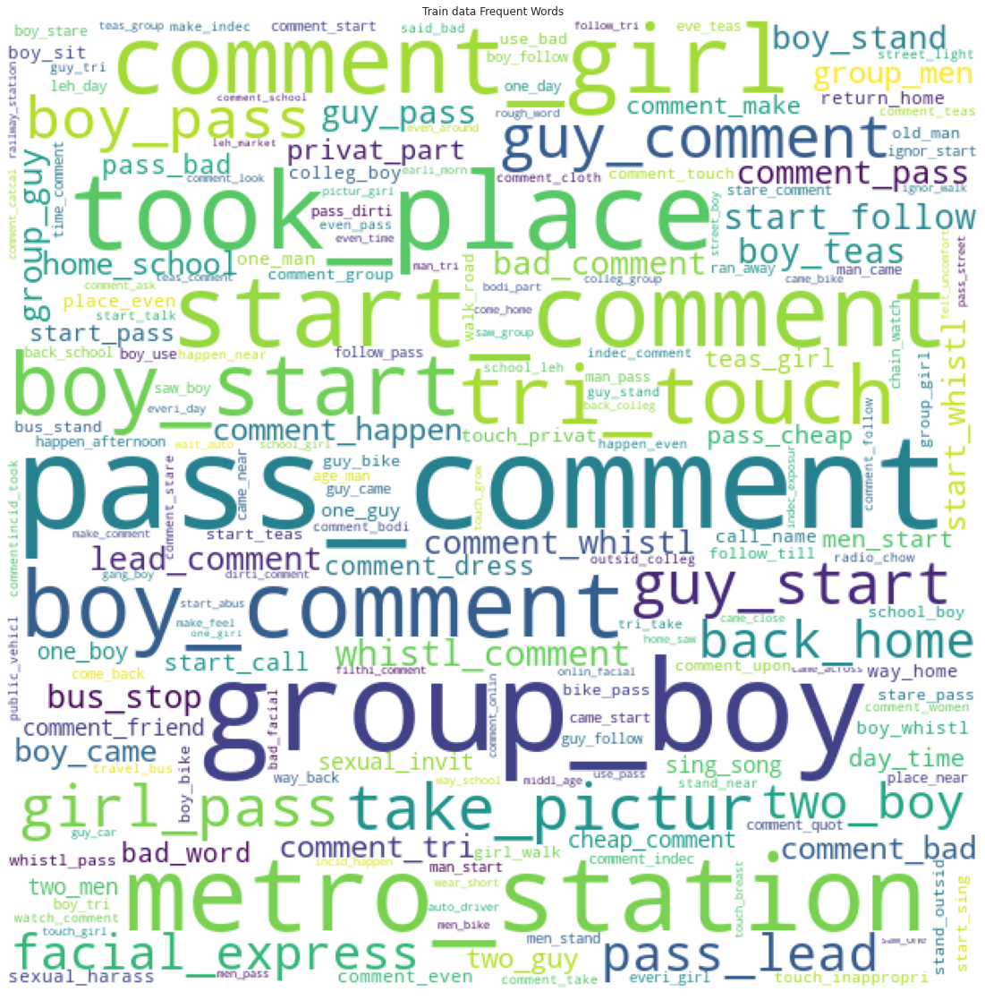

In [162]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_bi_commenting)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [163]:
badreview = ''
for x in data[data['Staring']==1]['stemed']:
        badreview= badreview+x

badreview_test = ''
for x in data_test[data_test['Staring']==1]['stemed']:
        badreview_test= badreview_test+x



In [164]:
from nltk.util import ngrams
import collections

n = 2
sentence = badreview
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_staring=collections.Counter(a)

   
  
from nltk.util import ngrams
import collections

n = 2
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_staring_test=collections.Counter(a)

   
  


In [165]:
import more_itertools

counter_bi_staring={k: v for k, v in sorted(counter_bi_staring.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi_staring.items())
print(len(first_n))
print(first_n)
print(len(counter_bi_staring))

200
[('facial_express', 62), ('pass_comment', 49), ('metro_station', 42), ('group_boy', 37), ('took_place', 35), ('tri_touch', 35), ('day_time', 17), ('back_home', 16), ('old_man', 16), ('take_pictur', 15), ('boy_start', 15), ('sexual_harass', 14), ('comment_girl', 14), ('start_whistl', 14), ('start_comment', 14), ('kept_stare', 14), ('guy_start', 13), ('girl_pass', 13), ('pass_lead', 13), ('age_man', 13), ('privat_part', 13), ('weird_facial', 13), ('bus_stop', 13), ('group_guy', 12), ('comment_make', 12), ('constant_stare', 12), ('sexual_invit', 12), ('touch_privat', 12), ('one_boy', 12), ('one_day', 12), ('bad_facial', 12), ('boy_stand', 11), ('comment_whistl', 11), ('two_boy', 11), ('boy_stare', 11), ('continu_stare', 11), ('leh_market', 11), ('comment_bad', 11), ('middl_age', 10), ('one_man', 10), ('sing_song', 10), ('guy_stand', 10), ('leh_day', 10), ('make_indec', 9), ('stand_outsid', 9), ('boy_pass', 9), ('make_uncomfort', 9), ('onlin_facial', 9), ('make_facial', 9), ('touch_ina

In [166]:
import more_itertools

counter_bi_staring_test={k: v for k, v in sorted(counter_bi_staring_test.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi_staring.items())
print(len(first_n))
print(first_n)
print(len(counter_bi_staring_test))

200
[('facial_express', 62), ('pass_comment', 49), ('metro_station', 42), ('group_boy', 37), ('took_place', 35), ('tri_touch', 35), ('day_time', 17), ('back_home', 16), ('old_man', 16), ('take_pictur', 15), ('boy_start', 15), ('sexual_harass', 14), ('comment_girl', 14), ('start_whistl', 14), ('start_comment', 14), ('kept_stare', 14), ('guy_start', 13), ('girl_pass', 13), ('pass_lead', 13), ('age_man', 13), ('privat_part', 13), ('weird_facial', 13), ('bus_stop', 13), ('group_guy', 12), ('comment_make', 12), ('constant_stare', 12), ('sexual_invit', 12), ('touch_privat', 12), ('one_boy', 12), ('one_day', 12), ('bad_facial', 12), ('boy_stand', 11), ('comment_whistl', 11), ('two_boy', 11), ('boy_stare', 11), ('continu_stare', 11), ('leh_market', 11), ('comment_bad', 11), ('middl_age', 10), ('one_man', 10), ('sing_song', 10), ('guy_stand', 10), ('leh_day', 10), ('make_indec', 9), ('stand_outsid', 9), ('boy_pass', 9), ('make_uncomfort', 9), ('onlin_facial', 9), ('make_facial', 9), ('touch_ina

Word_cloud  Bi_gram  for staring

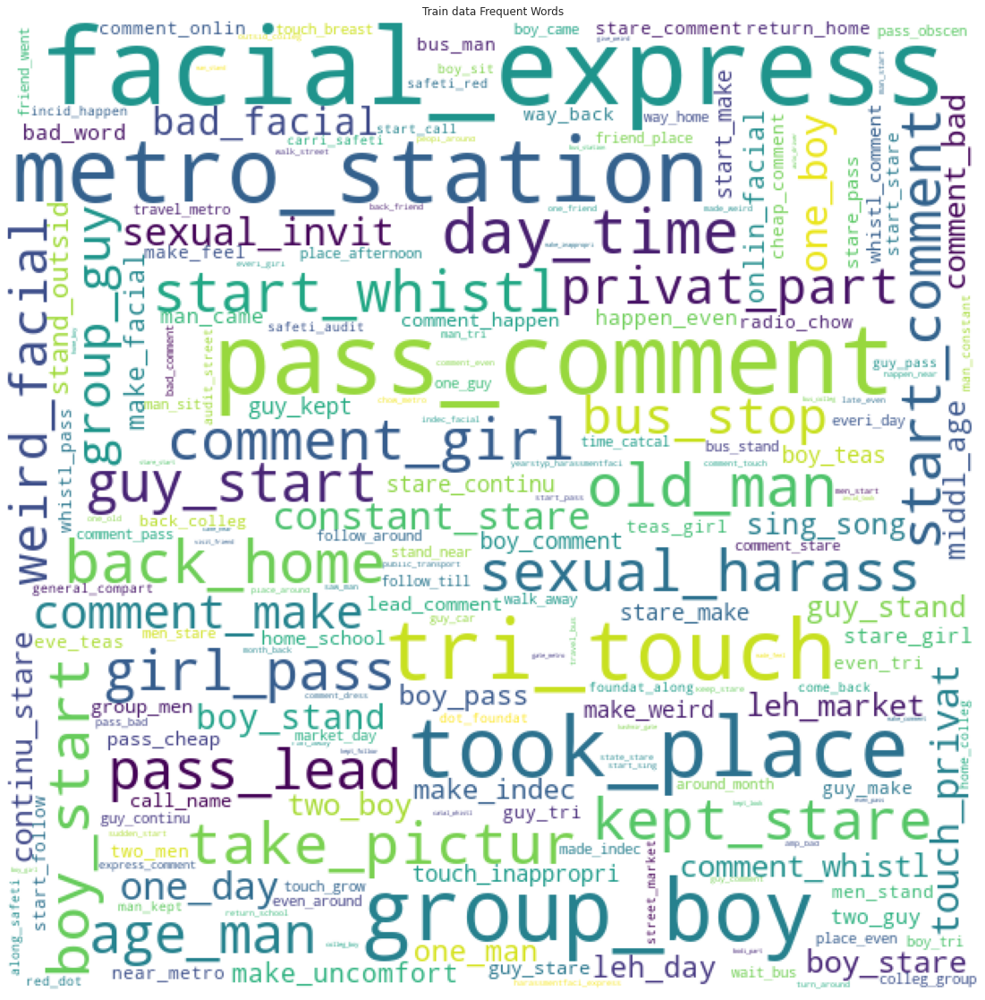

In [167]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_bi_staring)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [168]:
badreview = ''
for x in data[data['touching']==1]['stemed']:
        badreview= badreview+x


badreview_test = ''
for x in data_test[data_test['touching']==1]['stemed']:
        badreview_test= badreview_test+x



In [169]:
from nltk.util import ngrams
import collections

n = 2
sentence = badreview
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_touching=collections.Counter(a)

   
  
from nltk.util import ngrams
import collections

n = 2
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
bi=[]


for item in unigrams:
    bi.append(item[0]+'_'+item[1])



a = bi
counter_bi_touching_test=collections.Counter(a)

   
  


In [170]:
import more_itertools

counter_bi_touching={k: v for k, v in sorted(counter_bi.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi_touching.items())
print(len(first_n))
print(first_n)
print(len(counter_bi_touching))

200
[('tri_touch', 221), ('took_place', 160), ('group_boy', 159), ('pass_comment', 128), ('metro_station', 126), ('take_pictur', 96), ('privat_part', 96), ('back_home', 91), ('boy_start', 90), ('bus_stop', 77), ('two_boy', 76), ('old_man', 74), ('start_comment', 73), ('touch_privat', 72), ('start_touch', 70), ('facial_express', 69), ('around_pm', 69), ('ran_away', 65), ('start_follow', 65), ('man_tri', 63), ('sexual_harass', 61), ('man_came', 60), ('comment_girl', 60), ('guy_start', 59), ('boy_comment', 59), ('boy_came', 56), ('touch_breast', 55), ('touch_inappropri', 54), ('one_man', 54), ('follow_us', 51), ('guy_tri', 50), ('start_whistl', 50), ('guy_came', 49), ('girl_pass', 48), ('two_guy', 47), ('one_boy', 47), ('year_old', 47), ('one_day', 46), ('pass_lead', 44), ('street_light', 44), ('snatch_chain', 43), ('age_man', 43), ('boy_pass', 42), ('start_call', 41), ('home_school', 40), ('guy_comment', 40), ('group_guy', 40), ('touch_girl', 40), ('day_time', 40), ('whistl_comment', 40)

In [171]:
import more_itertools

counter_bi_touching_test={k: v for k, v in sorted(counter_bi_touching_test.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_bi_touching_test.items())
print(len(first_n))
print(first_n)
print(len(counter_bi_touching_test))

200
[('tri_touch', 55), ('man_tri', 15), ('touch_privat', 13), ('guy_tri', 11), ('touch_girl', 10), ('man_touch', 10), ('touch_breast', 10), ('privat_part', 10), ('ran_away', 10), ('boy_tri', 9), ('touch_inappropri', 9), ('man_came', 9), ('metro_station', 8), ('two_boy', 8), ('touch_hand', 8), ('back_home', 8), ('peopl_around', 6), ('radio_chow', 6), ('touch_us', 6), ('boy_touch', 6), ('hold_hand', 6), ('one_day', 6), ('start_touch', 6), ('pass_comment', 5), ('girl_touch', 5), ('walk_away', 5), ('person_tri', 5), ('boy_came', 5), ('comment_touch', 5), ('touch_grow', 5), ('sexual_harass', 5), ('middl_age', 5), ('could_anyth', 5), ('came_close', 5), ('guy_touch', 5), ('touch_back', 5), ('group_boy', 5), ('two_men', 4), ('man_walk', 4), ('one_man', 4), ('bodi_part', 4), ('street_market', 4), ('nagar_market', 4), ('chow_metro', 4), ('street_light', 4), ('took_place', 4), ('touch_inher', 4), ('go_back', 4), ('take_advantag', 4), ('toward_girl', 4), ('turn_back', 4), ('travel_bus', 4), ('clo

Word_cloud  Bi_gram for Touching

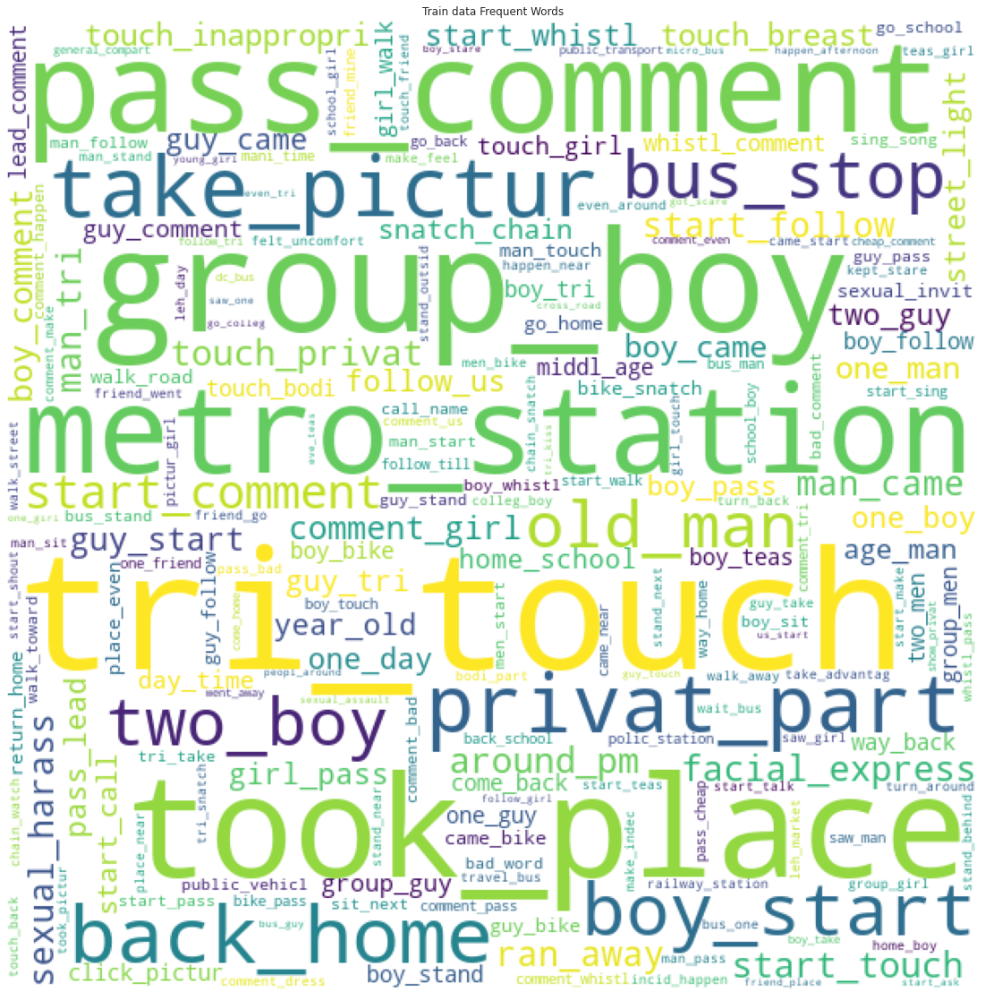

In [172]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_bi_touching)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [173]:
badreview = ''
for x in data[data['Commenting']==1]['stemed']:
        badreview= badreview+x

badreview_test = ''
for x in data_test[data_test['Commenting']==1]['stemed']:
        badreview_test= badreview_test+x



In [174]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_commenting=collections.Counter(a)

  
print(len(counter_tri_commenting))    
counter_tri_commenting={k: v for k, v in sorted(counter_tri_commenting.items(), key=lambda item: item[1],reverse=True)}



counter_tri_commenting={k: v for k, v in sorted(counter_tri_commenting.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_tri_commenting.items())
print(len(first_n))
print(first_n)


21453
200
[('pass_lead_comment', 22), ('group_boy_start', 16), ('pass_cheap_comment', 14), ('pass_bad_comment', 14), ('comment_girl_pass', 12), ('touch_privat_part', 11), ('took_place_even', 10), ('boy_start_comment', 9), ('boy_pass_comment', 9), ('commentincid_took_place', 9), ('group_boy_teas', 9), ('start_whistl_comment', 9), ('day_time_comment', 8), ('comment_take_pictur', 7), ('pass_comment_girl', 7), ('group_boy_pass', 7), ('guy_start_follow', 7), ('pass_dirti_comment', 7), ('bad_comment_girl', 7), ('guy_start_comment', 7), ('start_pass_comment', 7), ('bad_facial_express', 7), ('school_leh_day', 7), ('leh_day_time', 7), ('use_bad_word', 7), ('comment_tri_touch', 7), ('group_boy_comment', 7), ('took_place_around', 7), ('guy_pass_comment', 6), ('radio_chow_metro', 6), ('boy_whistl_comment', 6), ('start_follow_pass', 6), ('use_pass_comment', 6), ('man_tri_touch', 6), ('boy_start_whistl', 6), ('pass_obscen_comment', 6), ('pass_comment_tri', 6), ('stare_pass_comment', 6), ('took_place

In [175]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_commenting_test=collections.Counter(a)

  
print(len(counter_tri_commenting_test))    
counter_tri_commenting_test={k: v for k, v in sorted(counter_tri_commenting_test.items(), key=lambda item: item[1],reverse=True)}




first_n = more_itertools.take(200, counter_tri_commenting_test.items())
print(len(first_n))
print(first_n)


5417
200
[('carri_safeti_red', 4), ('safeti_red_dot', 4), ('red_dot_foundat', 4), ('dot_foundat_along', 4), ('foundat_along_safeti', 4), ('along_safeti_audit', 4), ('safeti_audit_street', 4), ('audit_street_market', 4), ('boy_pass_comment', 4), ('pass_lead_comment', 4), ('pass_cheap_comment', 4), ('comment_girl_pass', 4), ('group_boy_comment', 4), ('ask_phone_number', 3), ('pictur_without_permiss', 3), ('pass_comment_happen', 3), ('start_pass_comment', 3), ('start_comment_whistl', 3), ('colleg_group_boy', 3), ('boy_start_comment', 3), ('guy_start_comment', 3), ('kailash_coloni_market', 2), ('man_kept_follow', 2), ('take_pictur_without', 2), ('radio_chowk_metro', 2), ('peopl_call_name', 2), ('call_name_tri', 2), ('pass_obscen_comment', 2), ('two_boy_came', 2), ('start_teas_comment', 2), ('boy_bike_comment', 2), ('comment_whistl_girl', 2), ('group_boy_sit', 2), ('group_boy_pass', 2), ('whistl_comment_touch', 2), ('comment_touch_grow', 2), ('us_tri_touch', 2), ('two_boy_touch', 2), ('touc




Word_cloud Tri_gram for commenting

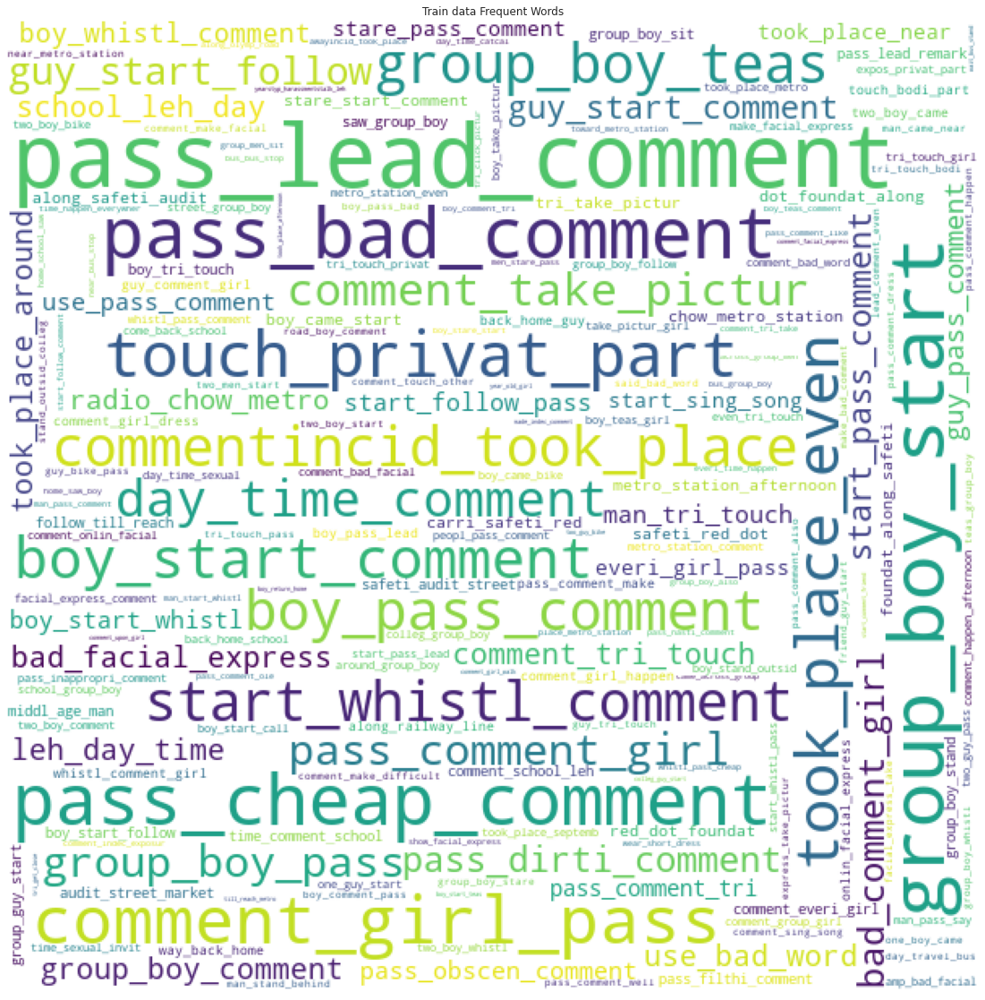

In [176]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_tri_commenting)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [177]:
badreview = ''
for x in data[data['Staring']==1]['stemed']:
        badreview= badreview+x



badreview_test = ''
for x in data_test[data_test['Staring']==1]['stemed']:
        badreview_test= badreview_test+x



In [178]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_staring=collections.Counter(a)

  
print(len(counter_tri))    
counter_tri_staring={k: v for k, v in sorted(counter_tri_staring.items(), key=lambda item: item[1],reverse=True)}



counter_tri_staring={k: v for k, v in sorted(counter_tri_staring.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_tri_staring.items())
print(len(first_n))
print(first_n)
print(len(counter_tri_staring))


70539
200
[('weird_facial_express', 10), ('middl_age_man', 9), ('make_facial_express', 8), ('touch_privat_part', 8), ('bad_facial_express', 8), ('pass_lead_comment', 7), ('pass_cheap_comment', 6), ('leh_market_day', 6), ('market_day_time', 6), ('day_time_catcal', 6), ('group_boy_teas', 6), ('carri_safeti_red', 5), ('safeti_red_dot', 5), ('red_dot_foundat', 5), ('dot_foundat_along', 5), ('foundat_along_safeti', 5), ('along_safeti_audit', 5), ('safeti_audit_street', 5), ('audit_street_market', 5), ('comment_girl_pass', 5), ('yearstyp_harassmentfaci_express', 5), ('took_place_around', 5), ('leh_day_time', 5), ('even_tri_touch', 5), ('make_weird_facial', 5), ('radio_chow_metro', 5), ('chow_metro_station', 5), ('incid_took_place', 4), ('took_place_even', 4), ('pass_comment_make', 4), ('onlin_facial_express', 4), ('boy_stand_outsid', 4), ('near_metro_station', 4), ('pass_bad_comment', 4), ('comment_onlin_facial', 4), ('made_weird_facial', 4), ('comment_bad_facial', 4), ('took_place_afternoon

In [179]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_staring_test=collections.Counter(a)

  
print(len(counter_tri))    
counter_tri_staring_test={k: v for k, v in sorted(counter_tri_staring_test.items(), key=lambda item: item[1],reverse=True)}




first_n = more_itertools.take(200, counter_tri_staring.items())
print(len(first_n))
print(first_n)
print(len(counter_tri_staring_test))


70539
200
[('weird_facial_express', 10), ('middl_age_man', 9), ('make_facial_express', 8), ('touch_privat_part', 8), ('bad_facial_express', 8), ('pass_lead_comment', 7), ('pass_cheap_comment', 6), ('leh_market_day', 6), ('market_day_time', 6), ('day_time_catcal', 6), ('group_boy_teas', 6), ('carri_safeti_red', 5), ('safeti_red_dot', 5), ('red_dot_foundat', 5), ('dot_foundat_along', 5), ('foundat_along_safeti', 5), ('along_safeti_audit', 5), ('safeti_audit_street', 5), ('audit_street_market', 5), ('comment_girl_pass', 5), ('yearstyp_harassmentfaci_express', 5), ('took_place_around', 5), ('leh_day_time', 5), ('even_tri_touch', 5), ('make_weird_facial', 5), ('radio_chow_metro', 5), ('chow_metro_station', 5), ('incid_took_place', 4), ('took_place_even', 4), ('pass_comment_make', 4), ('onlin_facial_express', 4), ('boy_stand_outsid', 4), ('near_metro_station', 4), ('pass_bad_comment', 4), ('comment_onlin_facial', 4), ('made_weird_facial', 4), ('comment_bad_facial', 4), ('took_place_afternoon

In [180]:
import more_itertools

counter_tri_staring={k: v for k, v in sorted(counter_tri_staring.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_tri_staring.items())
print(len(first_n))
print(first_n)


200
[('weird_facial_express', 10), ('middl_age_man', 9), ('make_facial_express', 8), ('touch_privat_part', 8), ('bad_facial_express', 8), ('pass_lead_comment', 7), ('pass_cheap_comment', 6), ('leh_market_day', 6), ('market_day_time', 6), ('day_time_catcal', 6), ('group_boy_teas', 6), ('carri_safeti_red', 5), ('safeti_red_dot', 5), ('red_dot_foundat', 5), ('dot_foundat_along', 5), ('foundat_along_safeti', 5), ('along_safeti_audit', 5), ('safeti_audit_street', 5), ('audit_street_market', 5), ('comment_girl_pass', 5), ('yearstyp_harassmentfaci_express', 5), ('took_place_around', 5), ('leh_day_time', 5), ('even_tri_touch', 5), ('make_weird_facial', 5), ('radio_chow_metro', 5), ('chow_metro_station', 5), ('incid_took_place', 4), ('took_place_even', 4), ('pass_comment_make', 4), ('onlin_facial_express', 4), ('boy_stand_outsid', 4), ('near_metro_station', 4), ('pass_bad_comment', 4), ('comment_onlin_facial', 4), ('made_weird_facial', 4), ('comment_bad_facial', 4), ('took_place_afternoon', 4),





Word_cloud  Bi_gram Staring

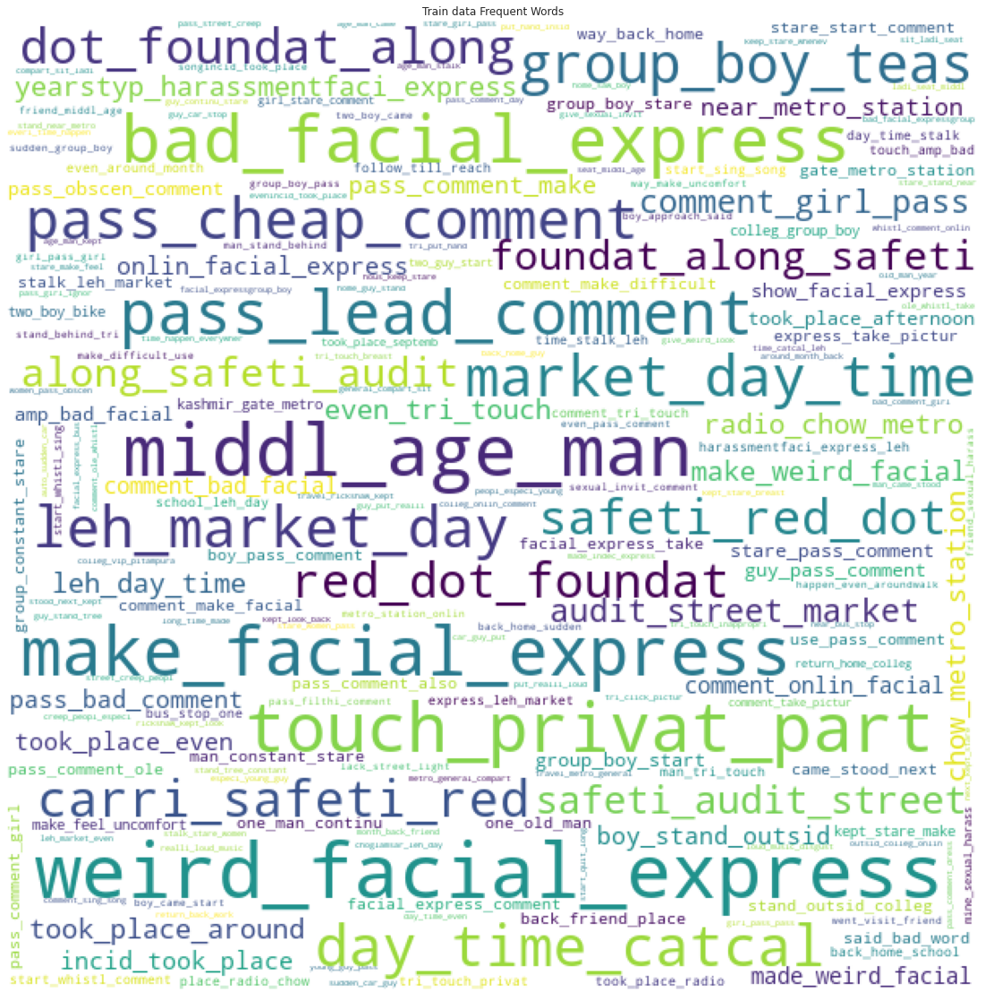

In [181]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_tri_staring)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

In [182]:
badreview = ''
for x in data[data['touching']==1]['stemed']:
        badreview= badreview+x

badreview_test = ''
for x in data_test[data_test['touching']==1]['stemed']:
        badreview_test= badreview_test+x



In [183]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_touching=collections.Counter(a)

  
counter_tri_touching={k: v for k, v in sorted(counter_tri_touching.items(), key=lambda item: item[1],reverse=True)}



counter_tri_touching={k: v for k, v in sorted(counter_tri_touching.items(), key=lambda item: item[1],reverse=True)}


first_n = more_itertools.take(200, counter_tri_touching.items())
print(len(first_n))
print(first_n)
print(len(counter_tri_touching))    


200
[('touch_privat_part', 36), ('guy_tri_touch', 26), ('man_tri_touch', 24), ('tri_touch_privat', 19), ('middl_age_man', 14), ('boy_tri_touch', 12), ('tri_touch_bodi', 11), ('tri_touch_inappropri', 10), ('tri_touch_breast', 9), ('old_man_touch', 8), ('tri_touch_girl', 8), ('touch_bodi_part', 7), ('age_man_tri', 7), ('tri_touch_friend', 7), ('comment_tri_touch', 7), ('man_stand_behind', 6), ('girl_privat_part', 6), ('tri_come_close', 6), ('one_man_tri', 6), ('even_tri_touch', 6), ('radio_chow_metro', 6), ('tri_get_close', 6), ('teacher_use_touch', 5), ('man_came_touch', 5), ('start_touch_breast', 5), ('old_man_tri', 5), ('travel_public_vehicl', 5), ('touch_girl_privat', 5), ('pass_lead_comment', 5), ('one_man_touch', 5), ('man_came_behind', 5), ('came_behind_touch', 5), ('boy_touch_girl', 5), ('breast_ran_away', 5), ('way_back_home', 5), ('bus_one_man', 5), ('chow_metro_station', 5), ('two_boy_bike', 5), ('take_advantag_crowd', 5), ('took_place_afternoon', 5), ('took_place_around', 5),

In [184]:
from nltk.util import ngrams
import collections

n = 3
sentence = badreview_test
unigrams = ngrams(sentence.split(), n)
tri=[]


for item in unigrams:
    tri.append(item[0]+'_'+item[1]+'_'+item[2])



a = tri
counter_tri_touching_test=collections.Counter(a)

  
print(len(counter_tri_touching_test))    
counter_tri_touching_test={k: v for k, v in sorted(counter_tri_touching_test.items(), key=lambda item: item[1],reverse=True)}





first_n = more_itertools.take(200, counter_tri_touching.items())
print(len(first_n))
print(first_n)
print(len(counter_tri_touching_test))    


5369
200
[('touch_privat_part', 36), ('guy_tri_touch', 26), ('man_tri_touch', 24), ('tri_touch_privat', 19), ('middl_age_man', 14), ('boy_tri_touch', 12), ('tri_touch_bodi', 11), ('tri_touch_inappropri', 10), ('tri_touch_breast', 9), ('old_man_touch', 8), ('tri_touch_girl', 8), ('touch_bodi_part', 7), ('age_man_tri', 7), ('tri_touch_friend', 7), ('comment_tri_touch', 7), ('man_stand_behind', 6), ('girl_privat_part', 6), ('tri_come_close', 6), ('one_man_tri', 6), ('even_tri_touch', 6), ('radio_chow_metro', 6), ('tri_get_close', 6), ('teacher_use_touch', 5), ('man_came_touch', 5), ('start_touch_breast', 5), ('old_man_tri', 5), ('travel_public_vehicl', 5), ('touch_girl_privat', 5), ('pass_lead_comment', 5), ('one_man_touch', 5), ('man_came_behind', 5), ('came_behind_touch', 5), ('boy_touch_girl', 5), ('breast_ran_away', 5), ('way_back_home', 5), ('bus_one_man', 5), ('chow_metro_station', 5), ('two_boy_bike', 5), ('take_advantag_crowd', 5), ('took_place_afternoon', 5), ('took_place_around'

Word_cloud Tri_gram for Touching

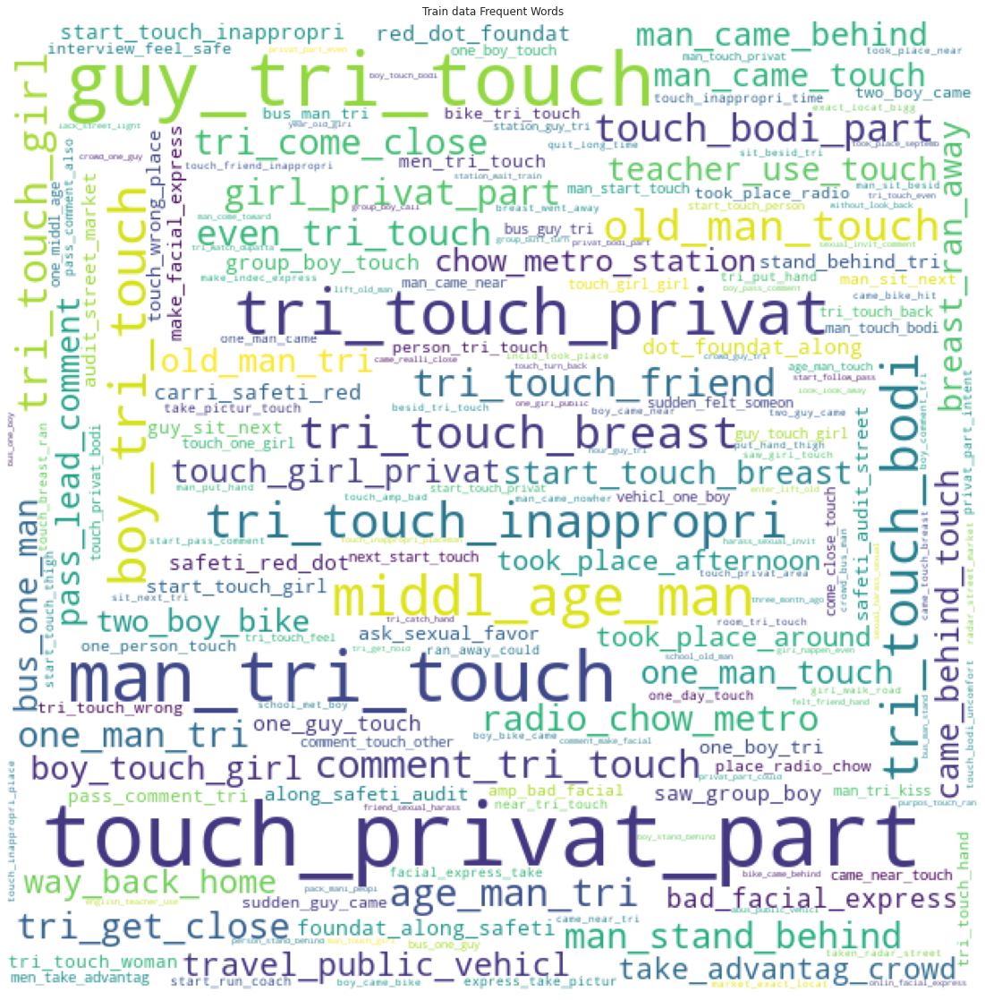

In [185]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

fig, (ax1) = plt.subplots(1, figsize = (20, 20))
wordcloud = WordCloud(background_color = 'white', width = 600, height = 600).generate_from_frequencies(counter_tri_touching)
ax1.set_title('{} data Frequent Words'.format('Train'))
ax1.imshow(wordcloud)
ax1.axis('off')
plt.show(ax1)

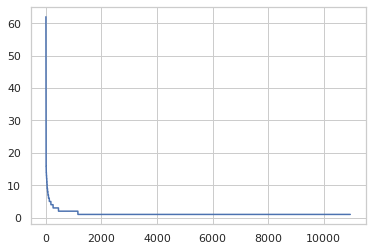

In [186]:
plt.plot(list(counter_bi_staring.values()))

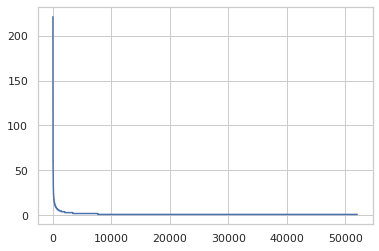

In [187]:
plt.plot(list(counter_bi_touching.values()))

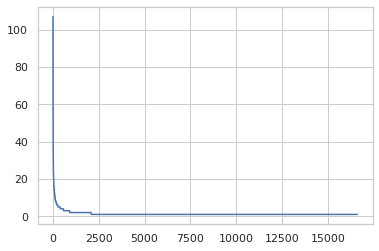

In [188]:
plt.plot(list(counter_bi_commenting.values()))

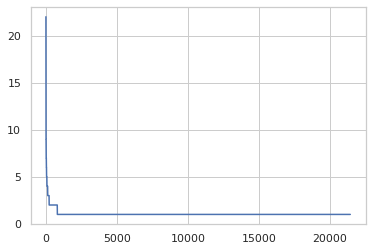

In [189]:
plt.plot(list(counter_tri_commenting.values()))

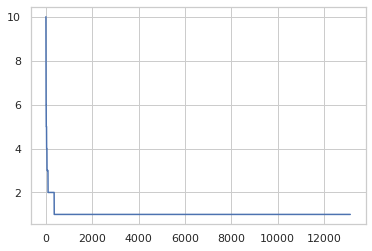

In [190]:
plt.plot(list(counter_tri_staring.values()))

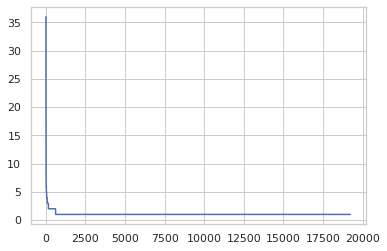

In [191]:
plt.plot(list(counter_tri_touching.values()))

In [192]:
r=100
n_counter_bi_commenting=list(counter_bi_commenting.keys())[0:r]
n_counter_bi_staring=list(counter_bi_staring.keys())[0:r]
n_counter_bi_touching=list(counter_bi_touching.keys())[0:r]
n_counter_tri_commenting=list(counter_tri_commenting.keys())[0:r]
n_counter_tri_staring=list(counter_tri_staring.keys())[0:r]
n_counter_tri_touching=list(counter_tri_touching.keys())[0:r]

In [193]:
r=100
n_counter_bi_commenting_test=list(counter_bi_commenting_test.keys())[0:r]
n_counter_bi_staring_test=list(counter_bi_staring_test.keys())[0:r]
n_counter_bi_touching_test=list(counter_bi_touching_test.keys())[0:r]
n_counter_tri_commenting_test=list(counter_tri_commenting_test.keys())[0:r]
n_counter_tri_staring_test=list(counter_tri_staring_test.keys())[0:r]
n_counter_tri_touching_test=list(counter_tri_touching_test.keys())[0:r]

In [194]:
de_bi_commenting=set(n_counter_bi_commenting)-(set(n_counter_bi_commenting) & set(n_counter_bi_staring) & set(n_counter_bi_touching))
de_bi_staring=set(n_counter_bi_staring)-(set(n_counter_bi_commenting) & set(n_counter_bi_staring) & set(n_counter_bi_touching))
de_bi_touching=set(n_counter_bi_touching)-(set(n_counter_bi_commenting) & set(n_counter_bi_staring) & set(n_counter_bi_touching))


In [195]:
de_bi_commenting

{'bad_comment',
 'bike_pass',
 'boy_bike',
 'boy_follow',
 'boy_sit',
 'boy_stare',
 'boy_use',
 'boy_whistl',
 'bus_stand',
 'chain_watch',
 'cheap_comment',
 'colleg_boy',
 'come_back',
 'comment_dress',
 'comment_even',
 'comment_friend',
 'comment_group',
 'comment_make',
 'comment_pass',
 'comment_touch',
 'comment_tri',
 'comment_upon',
 'eve_teas',
 'everi_girl',
 'follow_till',
 'girl_walk',
 'group_girl',
 'guy_bike',
 'guy_came',
 'guy_comment',
 'guy_follow',
 'guy_pass',
 'happen_afternoon',
 'men_start',
 'one_guy',
 'pass_bad',
 'pass_cheap',
 'school_boy',
 'stand_outsid',
 'stare_pass',
 'start_call',
 'start_pass',
 'start_sing',
 'start_teas',
 'teas_girl',
 'use_bad',
 'walk_road',
 'whistl_pass'}

In [196]:
de_bi_commenting_test=set(n_counter_bi_commenting_test)-(set(n_counter_bi_commenting_test) & set(n_counter_bi_staring_test) & set(n_counter_bi_touching_test))
de_bi_staring_test=set(n_counter_bi_staring_test)-(set(n_counter_bi_commenting_test) & set(n_counter_bi_staring_test) & set(n_counter_bi_touching_test))
de_bi_touching_test=set(n_counter_bi_touching_test)-(set(n_counter_bi_commenting_test) & set(n_counter_bi_staring_test) & set(n_counter_bi_touching_test))


In [197]:
final_de=set.union(de_bi_commenting,de_bi_staring,de_bi_touching)

In [198]:
final_de

import pickle
with open("final_de_bi.txt", "wb") as fp:   #Pickling
   pickle.dump(final_de, fp)
 
with open("final_de_bi.txt", "rb") as fp:   # Unpickling
   b = pickle.load(fp)



   

In [199]:
final_de_test=set.union(de_bi_commenting_test,de_bi_staring_test,de_bi_touching_test)

In [200]:
len(final_de_test)

206

In [201]:
data.shape

(6705, 25)

In [202]:
de_tri_commenting=set(n_counter_tri_commenting)-(set(n_counter_tri_commenting) & set(n_counter_tri_staring) & set(n_counter_tri_touching))
de_tri_staring=set(n_counter_tri_staring)-(set(n_counter_tri_commenting) & set(n_counter_tri_staring) & set(n_counter_tri_touching))
de_tri_touching=set(n_counter_tri_touching)-(set(n_counter_tri_commenting) & set(n_counter_tri_staring) & set(n_counter_tri_touching))


In [203]:
de_tri_commenting_test=set(n_counter_tri_commenting_test)-(set(n_counter_tri_commenting_test) & set(n_counter_tri_staring_test) & set(n_counter_tri_touching_test))
de_tri_staring_test=set(n_counter_tri_staring_test)-(set(n_counter_tri_commenting_test) & set(n_counter_tri_staring_test) & set(n_counter_tri_touching_test))
de_tri_touching_test=set(n_counter_tri_touching_test)-(set(n_counter_tri_commenting_test) & set(n_counter_tri_staring_test) & set(n_counter_tri_touching_test))


In [204]:
final_de_tri=set.union(de_tri_commenting,de_tri_staring,de_tri_touching)
len(final_de_tri)

201

In [205]:
final_de_tri_test=set.union(de_tri_commenting_test,de_tri_staring_test,de_tri_touching_test)

#Calculating Bi_Tri_gram

In [206]:
zero_bi=[]
count=0
for badreview in data.stemed:
  n = 2
  sentence = badreview
  unigrams = ngrams(sentence.split(), n)
  tri=[]
  

 
  di=dict(zip(list(final_de),np.zeros(len(final_de))))
  

  try:

    for item in unigrams:
     
      tri.append(item[0]+'_'+item[1])

    common= set(tri) & final_de 
   
    for k in common:
      di[k]=1
      
    zero_bi.append(di)
    count+=1
  except:
    zero_bi.append(di)
    count+=1
    continue    


print(count)  
len(zero_bi)

6705


6705

In [207]:
zero_bi_test=[]
count=0
for badreview in data_test.stemed:
  n = 2
  sentence = badreview
  unigrams = ngrams(sentence.split(), n)
  tri=[]
  

 
  di=dict(zip(list(final_de),np.zeros(len(final_de))))

  try:

    for item in unigrams:
     
      tri.append(item[0]+'_'+item[1])

    common= set(tri) & final_de 
   
    for k in common:
      di[k]=1
      
    zero_bi_test.append(di)
    count+=1
  except:
    zero_bi_test.append(di)
    count+=1
    continue    


print(count)  
len(zero_bi_test)

1640


1640

In [208]:
zero_bi_test

[{'around_pm': 0.0,
  'back_colleg': 0.0,
  'bad_comment': 0.0,
  'bad_facial': 0.0,
  'bike_pass': 0.0,
  'bike_snatch': 0.0,
  'boy_bike': 0.0,
  'boy_follow': 0.0,
  'boy_sit': 0.0,
  'boy_stare': 0.0,
  'boy_use': 0.0,
  'boy_whistl': 0.0,
  'bus_man': 0.0,
  'bus_stand': 0.0,
  'came_bike': 0.0,
  'came_near': 0.0,
  'chain_watch': 0.0,
  'cheap_comment': 0.0,
  'click_pictur': 0.0,
  'colleg_boy': 0.0,
  'come_back': 0.0,
  'comment_dress': 0.0,
  'comment_even': 0.0,
  'comment_friend': 0.0,
  'comment_group': 0.0,
  'comment_make': 0.0,
  'comment_onlin': 0.0,
  'comment_pass': 0.0,
  'comment_stare': 0.0,
  'comment_touch': 0.0,
  'comment_tri': 0.0,
  'comment_upon': 0.0,
  'constant_stare': 0.0,
  'continu_stare': 0.0,
  'eve_teas': 0.0,
  'even_tri': 0.0,
  'everi_girl': 0.0,
  'follow_around': 0.0,
  'follow_till': 0.0,
  'follow_us': 0.0,
  'girl_walk': 0.0,
  'go_home': 0.0,
  'go_school': 0.0,
  'group_girl': 0.0,
  'guy_bike': 0.0,
  'guy_came': 1,
  'guy_comment': 0.0

In [209]:
z_bi_value=[]
for i in zero_bi:
  z_bi_value.append(list(i.values()))


z_bi_value=np.array(z_bi_value)

In [210]:
z_bi_value_test=[]
for i in zero_bi_test:
  z_bi_value_test.append(list(i.values()))


z_bi_value_test=np.array(z_bi_value_test)

In [211]:
zero_tri=[]
count=0
for badreview in data.stemed:
  n = 3
  sentence = badreview
  unigrams = ngrams(sentence.split(), n)
  tri=[]
  

  
  di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))

  try:
    
    for item in unigrams:
      tri.append(item[0]+'_'+item[1]+'_'+item[2])

    common= set(tri) & final_de_tri 
   

    di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))
    for k in common:
      di[k]=1
    
    count+=1 
    zero_tri.append(di)
  
  except:
    count+=1

    zero_tri.append(di)

    continue    
  

print(count)  
len(zero_tri)





import pickle
with open("final_de_tri.txt", "wb") as fp:   #Pickling
   pickle.dump(final_de_tri, fp)
 
with open("final_de_tri.txt", "rb") as fp:   # Unpickling
   b = pickle.load(fp)



   

6705


In [212]:
zero_tri_test=[]
count=0
for badreview in data_test.stemed:
  n = 3
  sentence = badreview
  unigrams = ngrams(sentence.split(), n)
  tri=[]
  

  
  di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))

  try:
    
    for item in unigrams:
      tri.append(item[0]+'_'+item[1]+'_'+item[2])

    common= set(tri) & final_de_tri 
   

    di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))
    for k in common:
      di[k]=1
    
    count+=1 
    zero_tri_test.append(di)
  
  except:
    count+=1

    zero_tri_test.append(di)

    continue    
  

print(count)  
len(zero_tri_test)

1640


1640

In [213]:
z_tri_value=[]
for i in zero_tri:
  z_tri_value.append(list(i.values()))


z_tri_value=np.array(z_tri_value)

In [214]:
z_tri_value_test=[]
for i in zero_tri_test:
  z_tri_value_test.append(list(i.values()))


z_tri_value_test=np.array(z_tri_value_test)

In [215]:
z_tri_value_test

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [216]:
z_tri_value.shape,z_bi_value.shape

((6705, 201), (6705, 112))

In [217]:
zero_bi_tri=pd.DataFrame(np.concatenate((z_bi_value,z_tri_value),axis=1))
zero_bi_tri

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6700,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6701,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6702,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6703,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [218]:
zero_bi_tri_test=pd.DataFrame(np.concatenate((z_bi_value_test,z_tri_value_test),axis=1))
zero_bi_tri_test

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1635,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1636,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1637,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1638,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [219]:
from sklearn.manifold import TSNE
X_embedded_tf_w2v = TSNE(n_components=2).fit_transform(zero_bi_tri)
X_embedded_tf_w2v.shape

(6705, 2)

In [220]:
zero_bi_tri.shape,zero_bi_tri_test.shape

((6705, 313), (1640, 313))

# BI_gram + Tri_gram


/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


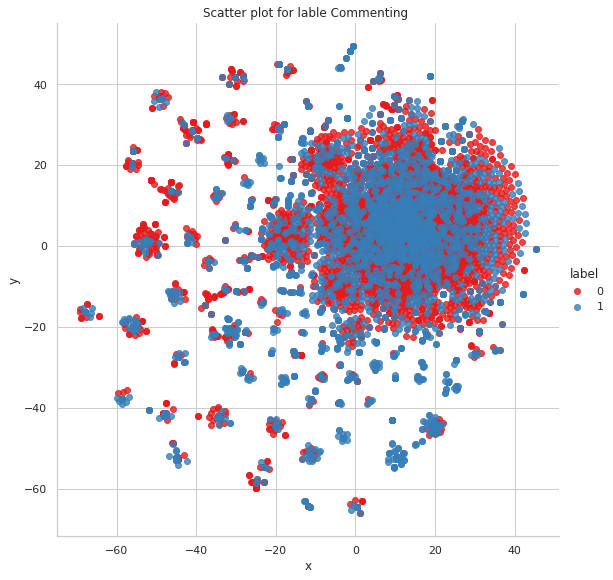

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


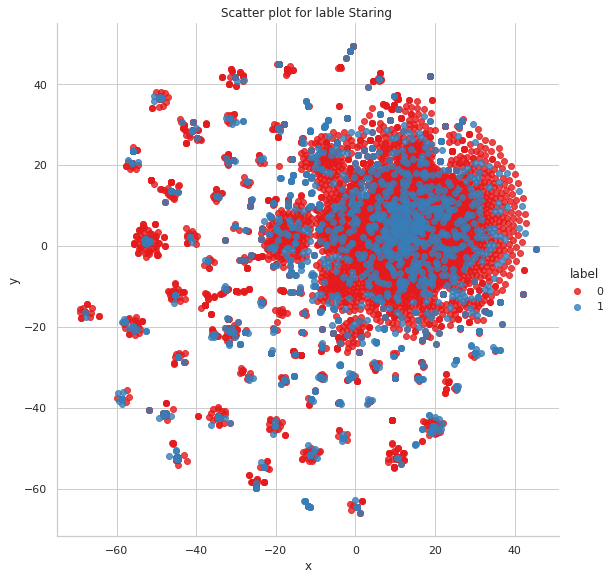

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


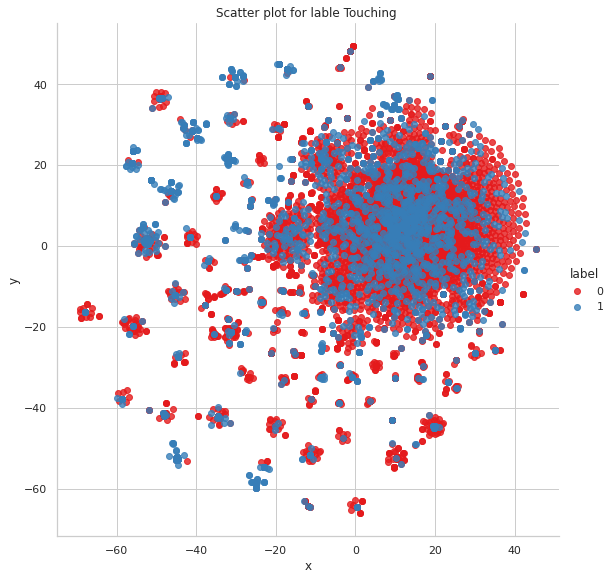

In [221]:
TSNE_plot(zero_bi_tri)

In [222]:
tree_bi_tri=dession_tree(zero_bi_tri,zero_bi_tri_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.7398956002982848
macro f1 score : 0.6688888888888889
micro f1 score : 0.7398956002982848
hamming loss : 0.2601043997017151






Test accuracy for data_commenting

accuracy_test : 0.6969512195121951
macro f1 score_test : 0.6032498195328931
micro f1 score_test : 0.6969512195121951
hamming loss_test : 0.30304878048780487






Train accuracy for data_touching

accuracy : 0.7926920208799404
macro f1 score : 0.68293018983466
micro f1 score : 0.7926920208799404
hamming loss : 0.20730797912005966



Test accuracy for data_touching

accuracy_test : 0.75
macro f1 score_test : 0.6111496645847792
micro f1 score_test : 0.75
hamming loss_test : 0.25



Train accuracy for data_staring

accuracy : 0.8426547352721849
macro f1 score : 0.658457343639681
micro f1 score : 0.8426547352721849
hamming loss : 0.15734526472781507



Test accuracy for data_staring

accuracy_test : 0.7890243902439025
macro f1 score_test : 0.

In [223]:
sgd_bi_tri=SGD_model(zero_bi_tri,zero_bi_tri_test)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.5388516032811335
macro f1 score : 0.5269161258522961
micro f1 score : 0.5388516032811335
hamming loss : 0.46114839671886654



Test accuracy for data_commenting

accuracy_test : 0.501219512195122
macro f1 score_test : 0.48442419323101144
micro f1 score_test : 0.501219512195122
hamming loss_test : 0.49878048780487805



Train accuracy for data_touching

accuracy : 0.7791200596569724
macro f1 score : 0.6718130984452136
micro f1 score : 0.7791200596569724
hamming loss : 0.2208799403430276



Test accuracy for data_touching

accuracy_test : 0.7475609756097561
macro f1 score_test : 0.6200772200772201
micro f1 score_test : 0.7475609756097561
hamming loss_test : 0.2524390243902439



Train accuracy for data_staring

accuracy : 0.8222222222222222
macro f1 score : 0.5893904757677313
micro f1 score : 0.8222222222222222
hamming loss : 0.17777777777777778



Test accuracy for data_staring

accuracy_test : 0.7914634146341

In [224]:
naive_bi_tri = Naive_base_model(zero_bi_tri,zero_bi_tri_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.7118568232662192
macro f1 score : 0.6274844035338033
micro f1 score : 0.7118568232662192
hamming loss : 0.28814317673378076



Test accuracy for data_commenting

accuracy_test : 0.6963414634146341
macro f1 score_test : 0.5957784205306077
micro f1 score_test : 0.6963414634146341
hamming loss_test : 0.30365853658536585



Train accuracy for data_touching

accuracy : 0.4715883668903803
macro f1 score : 0.4659325317537799
micro f1 score : 0.4715883668903803
hamming loss : 0.5284116331096197



Test accuracy for data_touching

accuracy_test : 0.4530487804878049
macro f1 score_test : 0.442556295531409
micro f1 score_test : 0.4530487804878049
hamming loss_test : 0.5469512195121952



Train accuracy for data_staring

accuracy : 0.3209545115585384
macro f1 score : 0.3169404201286967
micro f1 score : 0.3209545115585384
hamming loss : 0.6790454884414616



Test accuracy for data_staring

accuracy_test : 0.3048780

In [225]:
Random_forest_bi_tri=Random_forest(zero_bi_tri,zero_bi_tri_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.6199850857568978
macro f1 score : 0.39179074828327776
micro f1 score : 0.6199850857568978
hamming loss : 0.3800149142431022



Test accuracy for data_commenting

accuracy_test : 0.6213414634146341
macro f1 score_test : 0.3862508474576271
micro f1 score_test : 0.6213414634146341
hamming loss_test : 0.37865853658536586



Train accuracy for data_touching

accuracy : 0.6999254287844892
macro f1 score : 0.4117389015616775
micro f1 score : 0.6999254287844892
hamming loss : 0.3000745712155108



Test accuracy for data_touching

accuracy_test : 0.6884146341463414
macro f1 score_test : 0.4077284218129288
micro f1 score_test : 0.6884146341463414
hamming loss_test : 0.31158536585365854



Train accuracy for data_staring

accuracy : 0.7937360178970917
macro f1 score : 0.4425043651783487
micro f1 score : 0.7937360178970917
hamming loss : 0.20626398210290828



Test accuracy for data_staring

accuracy_test : 0.7810

# BI_gram + Tri_gram + BERT 


In [226]:
zero_bi_tri_pooled=np.concatenate((zero_bi_tri,X_train_pooled_output),axis=1)

zero_bi_tri_pooled_test=np.concatenate((zero_bi_tri_test,X_test_pooled_output),axis=1)

In [227]:
tree_bi_tri_bert=dession_tree(zero_bi_tri_pooled,zero_bi_tri_pooled_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9861297539149888
macro f1 score : 0.9852855702311416
micro f1 score : 0.9861297539149888
hamming loss : 0.013870246085011185






Test accuracy for data_commenting

accuracy_test : 0.624390243902439
macro f1 score_test : 0.6037845664864119
micro f1 score_test : 0.624390243902439
hamming loss_test : 0.375609756097561






Train accuracy for data_touching

accuracy : 0.9904548844146159
macro f1 score : 0.9885563923024031
micro f1 score : 0.9904548844146159
hamming loss : 0.009545115585384041



Test accuracy for data_touching

accuracy_test : 0.6615853658536586
macro f1 score_test : 0.592564822793451
micro f1 score_test : 0.6615853658536586
hamming loss_test : 0.3384146341463415



Train accuracy for data_staring

accuracy : 0.9864280387770321
macro f1 score : 0.978917295281324
micro f1 score : 0.9864280387770321
hamming loss : 0.013571961222967934



Test accuracy for data_staring

accuracy_test : 

In [228]:
sgd_bi_tri_bert=SGD_model(zero_bi_tri_pooled,zero_bi_tri_pooled_test)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.6365398956002983
macro f1 score : 0.6340415428773085
micro f1 score : 0.6365398956002983
hamming loss : 0.3634601043997017



Test accuracy for data_commenting

accuracy_test : 0.5920731707317073
macro f1 score_test : 0.5895335469043856
micro f1 score_test : 0.5920731707317073
hamming loss_test : 0.40792682926829266



Train accuracy for data_touching

accuracy : 0.7776286353467562
macro f1 score : 0.7606049902058379
micro f1 score : 0.7776286353467562
hamming loss : 0.22237136465324384



Test accuracy for data_touching

accuracy_test : 0.725609756097561
macro f1 score_test : 0.7069339894623311
micro f1 score_test : 0.7256097560975608
hamming loss_test : 0.27439024390243905



Train accuracy for data_staring

accuracy : 0.8344519015659956
macro f1 score : 0.6999686042484079
micro f1 score : 0.8344519015659956
hamming loss : 0.16554809843400448



Test accuracy for data_staring

accuracy_test : 0.775609756097

In [229]:
naive_bi_tri_bert = Naive_base_model(zero_bi_tri_pooled,zero_bi_tri_pooled_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.7123042505592841
macro f1 score : 0.6286753054333727
micro f1 score : 0.7123042505592841
hamming loss : 0.2876957494407159



Test accuracy for data_commenting

accuracy_test : 0.698780487804878
macro f1 score_test : 0.6015933120236047
micro f1 score_test : 0.698780487804878
hamming loss_test : 0.30121951219512194



Train accuracy for data_touching

accuracy : 0.5085756897837435
macro f1 score : 0.507425513603626
micro f1 score : 0.5085756897837435
hamming loss : 0.49142431021625654



Test accuracy for data_touching

accuracy_test : 0.4768292682926829
macro f1 score_test : 0.4726498378733298
micro f1 score_test : 0.4768292682926829
hamming loss_test : 0.5231707317073171



Train accuracy for data_staring

accuracy : 0.3203579418344519
macro f1 score : 0.3163717115613307
micro f1 score : 0.3203579418344519
hamming loss : 0.6796420581655481



Test accuracy for data_staring

accuracy_test : 0.294512195

In [230]:
Random_forest_bi_tri_bert=Random_forest(zero_bi_tri_pooled,zero_bi_tri_pooled_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.627889634601044
macro f1 score : 0.4180891918349816
micro f1 score : 0.627889634601044
hamming loss : 0.372110365398956



Test accuracy for data_commenting

accuracy_test : 0.6353658536585366
macro f1 score_test : 0.42497842320537355
micro f1 score_test : 0.6353658536585366
hamming loss_test : 0.3646341463414634



Train accuracy for data_touching

accuracy : 0.6999254287844892
macro f1 score : 0.4117389015616775
micro f1 score : 0.6999254287844892
hamming loss : 0.3000745712155108



Test accuracy for data_touching

accuracy_test : 0.6884146341463414
macro f1 score_test : 0.4077284218129288
micro f1 score_test : 0.6884146341463414
hamming loss_test : 0.31158536585365854



Train accuracy for data_staring

accuracy : 0.7937360178970917
macro f1 score : 0.4425043651783487
micro f1 score : 0.7937360178970917
hamming loss : 0.20626398210290828



Test accuracy for data_staring

accuracy_test : 0.78109756

# BI_gram + Tri_gram + BERT + w2v


In [231]:

zero_bi_tri_pooled_tf_w2v=np.concatenate((zero_bi_tri,X_train_pooled_output,tfidf_w2v_vectors_tr),axis=1)




/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


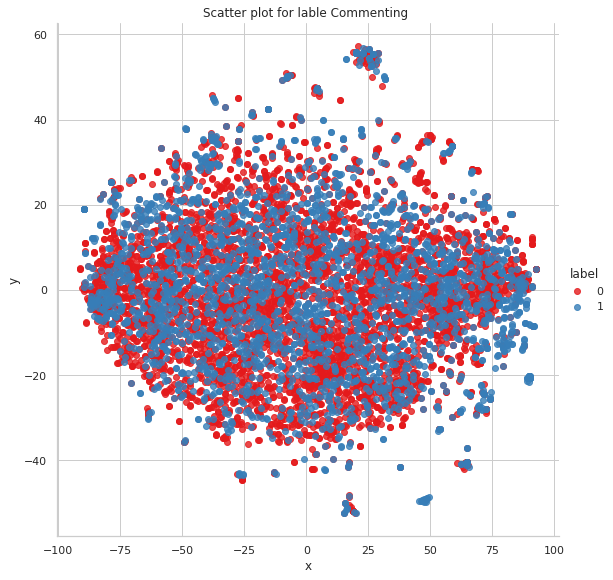

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


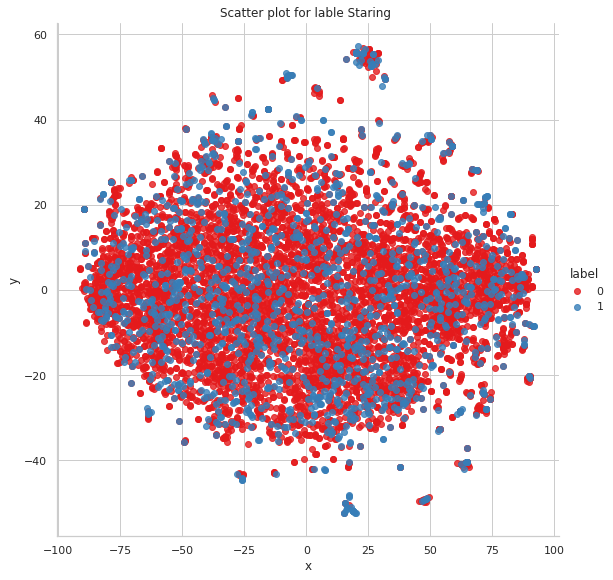

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


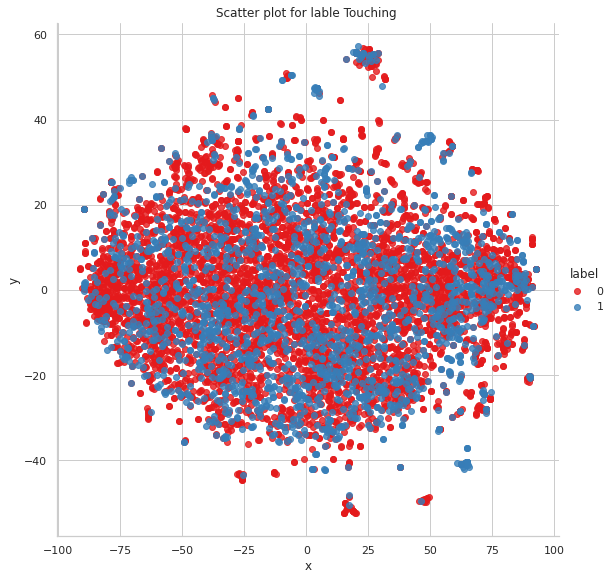

In [232]:
TSNE_plot(zero_bi_tri_pooled_tf_w2v)

In [233]:
zero_bi_tri_pooled_tf_w2v_test=np.concatenate((zero_bi_tri_test,X_test_pooled_output,tfidf_w2v_vectors_tr_test),axis=1)


In [234]:
tree_bi_tri_bert_w2v = dession_tree(zero_bi_tri_pooled_tf_w2v,zero_bi_tri_pooled_tf_w2v_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9861297539149888
macro f1 score : 0.9852855702311416
micro f1 score : 0.9861297539149888
hamming loss : 0.013870246085011185






Test accuracy for data_commenting

accuracy_test : 0.6567073170731708
macro f1 score_test : 0.6329785098526819
micro f1 score_test : 0.6567073170731708
hamming loss_test : 0.3432926829268293






Train accuracy for data_touching

accuracy : 0.9904548844146159
macro f1 score : 0.9885563923024031
micro f1 score : 0.9904548844146159
hamming loss : 0.009545115585384041



Test accuracy for data_touching

accuracy_test : 0.6902439024390243
macro f1 score_test : 0.6354126551789328
micro f1 score_test : 0.6902439024390243
hamming loss_test : 0.3097560975609756



Train accuracy for data_staring

accuracy : 0.9864280387770321
macro f1 score : 0.978917295281324
micro f1 score : 0.9864280387770321
hamming loss : 0.013571961222967934



Test accuracy for data_staring

accuracy_tes

In [235]:
sgd_bi_tri_bert_w2v = dession_tree(zero_bi_tri_pooled_tf_w2v,zero_bi_tri_pooled_tf_w2v_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9861297539149888
macro f1 score : 0.9852855702311416
micro f1 score : 0.9861297539149888
hamming loss : 0.013870246085011185






Test accuracy for data_commenting

accuracy_test : 0.6609756097560976
macro f1 score_test : 0.6388414917196221
micro f1 score_test : 0.6609756097560976
hamming loss_test : 0.33902439024390246






Train accuracy for data_touching

accuracy : 0.9904548844146159
macro f1 score : 0.9885563923024031
micro f1 score : 0.9904548844146159
hamming loss : 0.009545115585384041



Test accuracy for data_touching

accuracy_test : 0.6780487804878049
macro f1 score_test : 0.6235497064633705
micro f1 score_test : 0.6780487804878049
hamming loss_test : 0.32195121951219513



Train accuracy for data_staring

accuracy : 0.9864280387770321
macro f1 score : 0.978917295281324
micro f1 score : 0.9864280387770321
hamming loss : 0.013571961222967934



Test accuracy for data_staring

accuracy_t

In [236]:
naive_bi_tri_bert_w2v = Naive_base_model(zero_bi_tri_pooled_tf_w2v,zero_bi_tri_pooled_tf_w2v_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.7179716629381059
macro f1 score : 0.6380954215877053
micro f1 score : 0.7179716629381059
hamming loss : 0.2820283370618941



Test accuracy for data_commenting

accuracy_test : 0.7054878048780487
macro f1 score_test : 0.6138258647747001
micro f1 score_test : 0.7054878048780487
hamming loss_test : 0.2945121951219512



Train accuracy for data_touching

accuracy : 0.5231916480238628
macro f1 score : 0.5227323536766382
micro f1 score : 0.5231916480238628
hamming loss : 0.4768083519761372



Test accuracy for data_touching

accuracy_test : 0.4945121951219512
macro f1 score_test : 0.4920143851291392
micro f1 score_test : 0.4945121951219512
hamming loss_test : 0.5054878048780488



Train accuracy for data_staring

accuracy : 0.32423564504101415
macro f1 score : 0.32072536382076655
micro f1 score : 0.32423564504101415
hamming loss : 0.6757643549589858



Test accuracy for data_staring

accuracy_test : 0.29695

In [237]:
Random_forest_bi_tri_bert_w2v = Random_forest(zero_bi_tri_pooled_tf_w2v,zero_bi_tri_pooled_tf_w2v_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.6404175988068606
macro f1 score : 0.4478046006163873
micro f1 score : 0.6404175988068606
hamming loss : 0.35958240119313944



Test accuracy for data_commenting

accuracy_test : 0.6469512195121951
macro f1 score_test : 0.455174823610009
micro f1 score_test : 0.6469512195121951
hamming loss_test : 0.35304878048780486



Train accuracy for data_touching

accuracy : 0.7012677106636838
macro f1 score : 0.41746547601620065
micro f1 score : 0.7012677106636838
hamming loss : 0.2987322893363162



Test accuracy for data_touching

accuracy_test : 0.6902439024390243
macro f1 score_test : 0.41400721940404744
micro f1 score_test : 0.6902439024390243
hamming loss_test : 0.3097560975609756



Train accuracy for data_staring

accuracy : 0.7956748695003728
macro f1 score : 0.4522955071995757
micro f1 score : 0.7956748695003728
hamming loss : 0.20432513049962714



Test accuracy for data_staring

accuracy_test : 0.7829

#BI_gram + Tri_gram + w2v

In [238]:
zero_bi_tri_tf_w2v=np.concatenate((zero_bi_tri,tfidf_w2v_vectors_tr),axis=1)
zero_bi_tri_tf_w2v_test=np.concatenate((zero_bi_tri_test,tfidf_w2v_vectors_tr_test),axis=1)

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


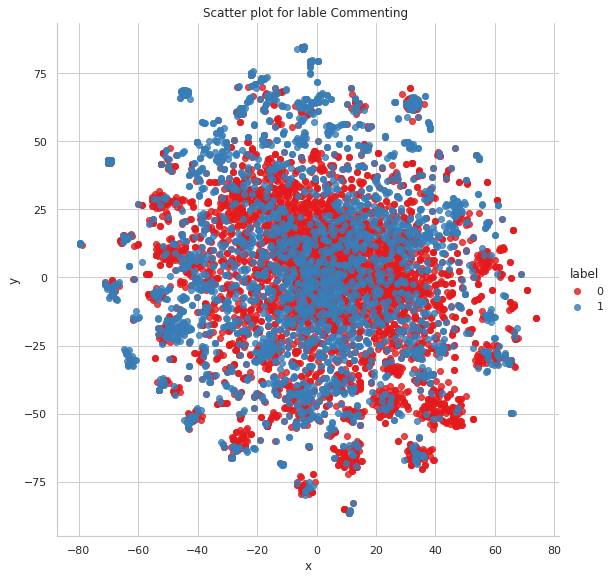

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


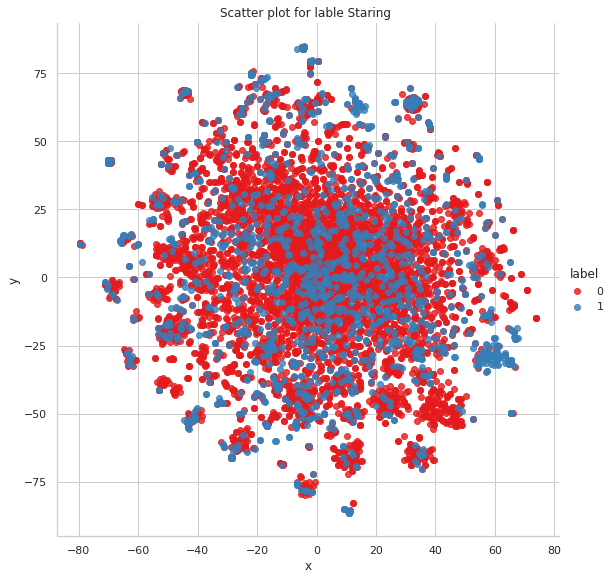

/usr/local/lib/python3.7/dist-packages/seaborn/regression.py:581: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


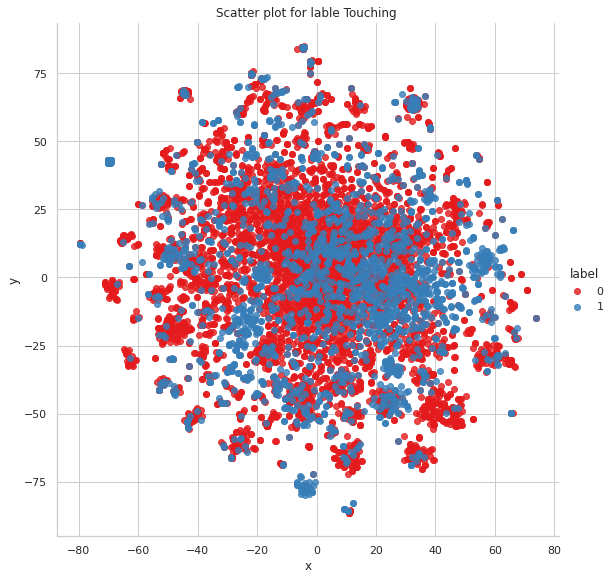

In [239]:
TSNE_plot(zero_bi_tri_tf_w2v)

In [240]:
tree_bi_tri_w2v = dession_tree(zero_bi_tri_tf_w2v,zero_bi_tri_tf_w2v_test)

Model metric for Dession tree model


Train accuracy for data_commenting


accuracy : 0.9788217747949292
macro f1 score : 0.9774688922052699
micro f1 score : 0.9788217747949292
hamming loss : 0.021178225205070844






Test accuracy for data_commenting

accuracy_test : 0.651219512195122
macro f1 score_test : 0.6309886458044862
micro f1 score_test : 0.651219512195122
hamming loss_test : 0.348780487804878






Train accuracy for data_touching

accuracy : 0.9859806114839672
macro f1 score : 0.9831130286492544
micro f1 score : 0.9859806114839672
hamming loss : 0.014019388516032811



Test accuracy for data_touching

accuracy_test : 0.6932926829268292
macro f1 score_test : 0.6293891876276765
micro f1 score_test : 0.6932926829268292
hamming loss_test : 0.3067073170731707



Train accuracy for data_staring

accuracy : 0.9797166293810589
macro f1 score : 0.9680017135372248
micro f1 score : 0.9797166293810589
hamming loss : 0.020283370618941088



Test accuracy for data_staring

accuracy_test 

In [241]:
sgd_bi_tri_w2v = SGD_model(zero_bi_tri_tf_w2v,zero_bi_tri_tf_w2v_test)

Model metric for SGD model


Train accuracy for data_commenting

accuracy : 0.7540641312453393
macro f1 score : 0.6885063406654788
micro f1 score : 0.7540641312453394
hamming loss : 0.2459358687546607



Test accuracy for data_commenting

accuracy_test : 0.7317073170731707
macro f1 score_test : 0.6573443043937426
micro f1 score_test : 0.7317073170731707
hamming loss_test : 0.2682926829268293



Train accuracy for data_touching

accuracy : 0.8435495898583147
macro f1 score : 0.7836514038760893
micro f1 score : 0.8435495898583147
hamming loss : 0.15645041014168531



Test accuracy for data_touching

accuracy_test : 0.8
macro f1 score_test : 0.726067578688351
micro f1 score_test : 0.8000000000000002
hamming loss_test : 0.2



Train accuracy for data_staring

accuracy : 0.8175988068605519
macro f1 score : 0.6678598556014028
micro f1 score : 0.8175988068605519
hamming loss : 0.18240119313944816



Test accuracy for data_staring

accuracy_test : 0.7774390243902439
macro f1 score_test : 0.596

In [242]:
naive_bi_tri_w2v = Naive_base_model(zero_bi_tri_tf_w2v,zero_bi_tri_tf_w2v_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.7173750932140194
macro f1 score : 0.6378502112349825
micro f1 score : 0.7173750932140194
hamming loss : 0.2826249067859806



Test accuracy for data_commenting

accuracy_test : 0.7042682926829268
macro f1 score_test : 0.6122268000325664
micro f1 score_test : 0.7042682926829268
hamming loss_test : 0.29573170731707316



Train accuracy for data_touching

accuracy : 0.48530947054436985
macro f1 score : 0.4815892118726989
micro f1 score : 0.48530947054436985
hamming loss : 0.5146905294556301



Test accuracy for data_touching

accuracy_test : 0.4713414634146341
macro f1 score_test : 0.46407228624121266
micro f1 score_test : 0.4713414634146341
hamming loss_test : 0.5286585365853659



Train accuracy for data_staring

accuracy : 0.33363161819537657
macro f1 score : 0.3310937574520297
micro f1 score : 0.33363161819537657
hamming loss : 0.6663683818046234



Test accuracy for data_staring

accuracy_test : 0.31

In [243]:
Random_forest_bi_tri_w2v = Random_forest(zero_bi_tri_tf_w2v,zero_bi_tri_tf_w2v_test)

Model metric for Naive Base model


Train accuracy for data_commenting

accuracy : 0.6422073079791201
macro f1 score : 0.4532095872612034
micro f1 score : 0.6422073079791201
hamming loss : 0.35779269202087993



Test accuracy for data_commenting

accuracy_test : 0.649390243902439
macro f1 score_test : 0.46252830560765934
micro f1 score_test : 0.649390243902439
hamming loss_test : 0.35060975609756095



Train accuracy for data_touching

accuracy : 0.7036539895600298
macro f1 score : 0.4258420559547829
micro f1 score : 0.7036539895600298
hamming loss : 0.29634601043997016



Test accuracy for data_touching

accuracy_test : 0.6920731707317073
macro f1 score_test : 0.42021924141267125
micro f1 score_test : 0.6920731707317073
hamming loss_test : 0.3079268292682927



Train accuracy for data_staring

accuracy : 0.7959731543624161
macro f1 score : 0.45447603187819674
micro f1 score : 0.7959731543624161
hamming loss : 0.2040268456375839



Test accuracy for data_staring

accuracy_test : 0.7829

In [244]:
from prettytable import PrettyTable

x = PrettyTable()
x.field_names = ["Methods","Accuracy", "F1_macro","F1_micro",'Hamming_loass','Accracy_test','F1_macro_test','F1_micro_test','Hamming_loss_test']

x.add_row(["Dession_tree_TF_IDF_w2v",tree_bert[0],tree_bert[1],tree_bert[2],tree_bert[3],tree_bert[4],tree_bert[5],tree_bert[6],tree_bert[7]])
x.add_row(["Dession_tree_BERT",tree_bi_tri[0],tree_bi_tri[1],tree_bi_tri[2],tree_bi_tri[3],tree_bi_tri[4],tree_bi_tri[5],tree_bi_tri[6],tree_bi_tri[7]])
x.add_row(["Dession_tree_Bi_Tri_gram",tree_bi_tri_bert[0],tree_bi_tri_bert[1],tree_bi_tri_bert[2],tree_bi_tri_bert[3],tree_bi_tri_bert[4],tree_bi_tri_bert[5],tree_bi_tri_bert[6],tree_bi_tri_bert[7]])
x.add_row(["Dession_tree_Bi_Tri_gram_BERT",tree_tf_w2v[0],tree_tf_w2v[1],tree_tf_w2v[2],tree_tf_w2v[3],tree_tf_w2v[4],tree_tf_w2v[5],tree_tf_w2v[6],tree_tf_w2v[7]])
x.add_row(["Dession_tree_Bi_Tri_gram_TF_IDF_w2v",tree_bi_tri_w2v[0],tree_bi_tri_w2v[1],tree_bi_tri_w2v[2],tree_bi_tri_w2v[3],tree_bi_tri_w2v[4],tree_bi_tri_w2v[5],tree_bi_tri_w2v[6],tree_bi_tri_w2v[7]])
x.add_row(["Dession_tree_Bi_Tri_gram_BERT_TF_IDF_w2v",tree_bi_tri_bert_w2v[0],tree_bi_tri_bert_w2v[1],tree_bi_tri_bert_w2v[2],tree_bi_tri_bert_w2v[3],tree_bi_tri_bert_w2v[4],tree_bi_tri_bert_w2v[5],tree_bi_tri_bert_w2v[6],tree_bi_tri[7]])

x.add_row(["SGD_TF_IDF_w2v",sgd_bert[0],sgd_bert[1],sgd_bert[2],sgd_bert[3],sgd_bert[4],sgd_bert[5],sgd_bert[6],sgd_bert[7]])
x.add_row(["SGD_BERT",sgd_bi_tri[0],sgd_bi_tri[1],sgd_bi_tri[2],sgd_bi_tri[3],sgd_bi_tri[4],sgd_bi_tri[5],sgd_bi_tri[6],sgd_bi_tri[7]])
x.add_row(["SGD_Bi_Tri_gram",sgd_bi_tri_bert[0],sgd_bi_tri_bert[1],sgd_bi_tri_bert[2],sgd_bi_tri_bert[3],sgd_bi_tri_bert[4],sgd_bi_tri_bert[5],sgd_bi_tri_bert[6],sgd_bi_tri_bert[7]])
x.add_row(["SGD_Bi_Tri_gram_BERT",sgd_tf_w2v[0],sgd_tf_w2v[1],sgd_tf_w2v[2],sgd_tf_w2v[3],sgd_tf_w2v[4],sgd_tf_w2v[5],sgd_tf_w2v[6],sgd_tf_w2v[7]])
x.add_row(["SGD_Bi_Tri_gram_TF_IDF_w2v",sgd_bi_tri_w2v[0],sgd_bi_tri_w2v[1],sgd_bi_tri_w2v[2],sgd_bi_tri_w2v[3],sgd_bi_tri_w2v[4],sgd_bi_tri_w2v[5],sgd_bi_tri_w2v[6],sgd_bi_tri_w2v[7]])
x.add_row(["SGD_Bi_Tri_gram_BERT_TF_IDF_w2v",sgd_bi_tri_bert_w2v[0],sgd_bi_tri_bert_w2v[1],sgd_bi_tri_bert_w2v[2],sgd_bi_tri_bert_w2v[3],sgd_bi_tri_bert_w2v[4],sgd_bi_tri_bert_w2v[5],sgd_bi_tri_bert_w2v[6],sgd_bi_tri_bert_w2v[7]])

x.add_row(["Naive_TF_IDF_w2v",naive_bert[0],naive_bert[1],naive_bert[2],naive_bert[3],naive_bert[4],naive_bert[5],naive_bert[6],naive_bert[7]])
x.add_row(["Naive_BERT",naive_bi_tri[0],naive_bi_tri[1],naive_bi_tri[2],naive_bi_tri[3],naive_bi_tri[4],naive_bi_tri[5],naive_bi_tri[6],naive_bi_tri[7]])
x.add_row(["Naive_Bi_Tri_gram",naive_bi_tri_bert[0],naive_bi_tri_bert[1],naive_bi_tri_bert[2],naive_bi_tri_bert[3],naive_bi_tri_bert[4],naive_bi_tri_bert[5],naive_bi_tri_bert[6],naive_bi_tri_bert[7]])
x.add_row(["Naive_Bi_Tri_gram_BERT",naive_tf_w2v[0],naive_tf_w2v[1],naive_tf_w2v[2],naive_tf_w2v[3],naive_tf_w2v[4],naive_tf_w2v[5],naive_tf_w2v[6],naive_tf_w2v[7]])
x.add_row(["Naive_Bi_Tri_gram_TF_IDF_w2v",naive_bi_tri_w2v[0],naive_bi_tri_w2v[1],naive_bi_tri_w2v[2],naive_bi_tri_w2v[3],naive_bi_tri_w2v[4],naive_bi_tri_w2v[5],naive_bi_tri_w2v[6],naive_bi_tri_w2v[7]])
x.add_row(["Naive_Bi_Tri_gram_BERT_TF_IDF_w2v",naive_bi_tri_bert_w2v[0],naive_bi_tri_bert_w2v[1],naive_bi_tri_bert_w2v[2],naive_bi_tri_bert_w2v[3],naive_bi_tri_bert_w2v[4],naive_bi_tri_bert_w2v[5],naive_bi_tri_bert_w2v[6],naive_bi_tri_bert_w2v[7]])

x.add_row(["Random_forest_TF_IDF_w2v",Random_forest_bert[0],Random_forest_bert[1],Random_forest_bert[2],Random_forest_bert[3],Random_forest_bert[4],Random_forest_bert[5],Random_forest_bert[6],Random_forest_bert[7]])
x.add_row(["Random_forest_BERT",Random_forest_bi_tri[0],Random_forest_bi_tri[1],Random_forest_bi_tri[2],Random_forest_bi_tri[3],Random_forest_bi_tri[4],Random_forest_bi_tri[5],Random_forest_bi_tri[6],Random_forest_bi_tri[7]])
x.add_row(["Random_forest_Bi_Tri_gram",Random_forest_bi_tri_bert[0],Random_forest_bi_tri_bert[1],Random_forest_bi_tri_bert[2],Random_forest_bi_tri_bert[3],Random_forest_bi_tri_bert[4],Random_forest_bi_tri_bert[5],Random_forest_bi_tri_bert[6],Random_forest_bi_tri_bert[7]])
x.add_row(["Random_forest_Bi_Tri_gram_BERT",Random_forest_tf_w2v[0],Random_forest_tf_w2v[1],Random_forest_tf_w2v[2],Random_forest_tf_w2v[3],Random_forest_tf_w2v[4],Random_forest_tf_w2v[5],Random_forest_tf_w2v[6],Random_forest_tf_w2v[7]])
x.add_row(["Random_forest_Bi_Tri_gram_TF_IDF_w2v",Random_forest_bi_tri_w2v[0],Random_forest_bi_tri_w2v[1],Random_forest_bi_tri_w2v[2],Random_forest_bi_tri_w2v[3],Random_forest_bi_tri_w2v[4],Random_forest_bi_tri_w2v[5],Random_forest_bi_tri_w2v[6],Random_forest_bi_tri_w2v[7]])
x.add_row(["Random_forest_Bi_Tri_gram_BERT_TF_IDF_w2v",Random_forest_bi_tri_bert_w2v[0],Random_forest_bi_tri_bert_w2v[1],Random_forest_bi_tri_bert_w2v[2],Random_forest_bi_tri_bert_w2v[3],Random_forest_bi_tri_bert_w2v[4],Random_forest_bi_tri_bert_w2v[5],Random_forest_bi_tri_bert_w2v[6],Random_forest_bi_tri_bert_w2v[7]])




print(x)

+-------------------------------------------+--------------------+---------------------+--------------------+----------------------+---------------------+---------------------+---------------------+---------------------+
|                  Methods                  |      Accuracy      |       F1_macro      |      F1_micro      |    Hamming_loass     |     Accracy_test    |    F1_macro_test    |    F1_micro_test    |  Hamming_loss_test  |
+-------------------------------------------+--------------------+---------------------+--------------------+----------------------+---------------------+---------------------+---------------------+---------------------+
|          Dession_tree_TF_IDF_w2v          | 0.987670892368879  |  0.9842530859382895 | 0.987670892368879  | 0.012329107631121055 |  0.6575203252032521 |  0.5782159848576093 |  0.6575203252032521 | 0.34247967479674796 |
|             Dession_tree_BERT             | 0.7917474521501368 |  0.6700921407877433 | 0.7917474521501368 | 0.2082

# Conclusion



1.    Here Compound feature showing variations in the box plot.
2.   Bi_gram and Tri_gram can play an important role in classification.
3. TF_IDF W2V and BERT vectors are converted into 2d by using the T-SNE algorithm, and plot scattered plots.
4. Bi_Tri_gram_BERT_TF_IDF_W2V performs the best(Bi_gram + Tri_gram + BERT_vector + TF_IDF_W2v) with Acuuracy 0.83, F1_macro 0.79, f1_micro 0.83 Hamming_loss 0.163 


In [246]:


# import pandas as pd
# import numpy as np
# import pickle
# import nltk
# import re
# from nltk.corpus import stopwords
# from nltk.stem.snowball import SnowballStemmer
# from sklearn.externals import joblib










# def decontractions(phrase):
#     """decontracted takes text and convert contractions into natural form.
#      ref: https://stackoverflow.com/questions/19790188/expanding-english-language-contractions-in-python/47091490#47091490"""
#     # specific
#     phrase = re.sub(r"won\'t", "will not", phrase)
#     phrase = re.sub(r"can\'t", "can not", phrase)
#     phrase = re.sub(r"won\’t", "will not", phrase)
#     phrase = re.sub(r"can\’t", "can not", phrase)

#     # general
#     phrase = re.sub(r"n\'t", " not", phrase)
#     phrase = re.sub(r"\'re", " are", phrase)
#     phrase = re.sub(r"\'s", " is", phrase)
#     phrase = re.sub(r"\'d", " would", phrase)
#     phrase = re.sub(r"\'ll", " will", phrase)
#     phrase = re.sub(r"\'t", " not", phrase)
#     phrase = re.sub(r"\'ve", " have", phrase)
#     phrase = re.sub(r"\'m", " am", phrase)

#     phrase = re.sub(r"n\’t", " not", phrase)
#     phrase = re.sub(r"\’re", " are", phrase)
#     phrase = re.sub(r"\’s", " is", phrase)
#     phrase = re.sub(r"\’d", " would", phrase)
#     phrase = re.sub(r"\’ll", " will", phrase)
#     phrase = re.sub(r"\’t", " not", phrase)
#     phrase = re.sub(r"\’ve", " have", phrase)
#     phrase = re.sub(r"\’m", " am", phrase)
   

#     return phrase

# def preprocess(text):
#     # convert all the text into lower letters
#     # use this function to remove the contractions: https://gist.github.com/anandborad/d410a49a493b56dace4f814ab5325bbd
#     # remove all the spacial characters: except space ' '
#     text = str(text).lower()
#     text = decontractions(text)
#     text = re.sub('[^A-Za-z ]+', ' ', text)
    
#     return text









# nltk.download('stopwords')


# stop = stopwords.words('english')





# # Use English stemmer.
# stemmer = SnowballStemmer("english")



# #!pip install autocorrect
# from autocorrect import Speller
# from nltk.util import ngrams
# import collections

# spell = Speller(lang='en')







# from nltk.stem import PorterStemmer
# ps = PorterStemmer()

# def preprocessing_flask(x):
#   x = spell(x)
#   x = preprocess(x)
  
 
#   x = x.split()
  
#   x = [item for item in x if item not in stop]
#   x = preprocess(x).split()
 
#   x = [ps.stem(y) for y in x] 
  
#   x = ' '.join(x)
#   x.replace('\d+', '')


#   # tfidf_w2v
#   #load TFIDF
#   tfidf_model_test=joblib.load('/home/lohit/Desktop/safescity/safe_city_api/models/tfidf_model.pkl')
#   # we are converting a dictionary with word as a key, and the idf as a value
#   dictionary = dict(zip(tfidf_model_test.get_feature_names(), list(tfidf_model_test.idf_)))
#   tfidf_words = set(tfidf_model_test.get_feature_names())



#   tfidf_w2v_vectors_tr_test = []; # the avg-w2v for each sentence/review is stored in this list
#   print(x)

#   # for each review/sentence
#   vector = np.zeros(300) # as word vectors are of zero length
#   tf_idf_weight =0; # num of words with a valid vector in the sentence/review

#   for word in x.split(): # for each word in a review/sentence
#       if (word in glove_words) and (word in tfidf_words):
#         vec = glove_model[word] # getting the vector for each word
#           # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
#         tf_idf = dictionary[word]*(x.count(word)/len(x.split())) # getting the tfidf value for each word
#         vector += (vec * tf_idf) # calculating tfidf weighted w2v
#         tf_idf_weight += tf_idf
#   if tf_idf_weight != 0:
#       vector /= tf_idf_weight
#   tfidf_w2v_vectors_tr_test.append(vector)

  









#   # Bigram
#   zero_bi_test=[]
#   count=0

  
#   n = 2
#   sentence = x
#   unigrams = ngrams(sentence.split(), n)
#   tri=[]
#   with open("/home/lohit/Desktop/safescity/safe_city_api/models/final_de_bi.txt", "rb") as fp:   # Unpickling
#    final_de = pickle.load(fp)


#   di = dict(zip(list(final_de),np.zeros(len(final_de))))

#   try:

#     for item in unigrams:
    
#       tri.append(item[0]+'_'+item[1])

#     common= set(tri) & final_de 
  
#     for k in common:
#       di[k]=1
      
#     zero_bi_test.append(di)
#   except:
#     zero_bi_test.append(di)   



#   print(zero_bi_test[0].values())    



#   # Tri gram
#   with open("/home/lohit/Desktop/safescity/safe_city_api/models/final_de_tri.txt", "rb") as fp:   # Unpickling
#    final_de_tri = pickle.load(fp)

#   zero_tri_test=[]
#   n = 3
#   sentence = x
#   unigrams = ngrams(sentence.split(), n)
#   tri=[]
  

  
#   di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))

#   try:
    
#     for item in unigrams:
#       tri.append(item[0]+'_'+item[1]+'_'+item[2])

#     common= set(tri) & final_de_tri 
   

#     di=dict(zip(list(final_de_tri),np.zeros(len(final_de_tri))))
#     for k in common:
#       di[k]=1
    
#     zero_tri_test.append(di)
  
#   except:

#     zero_tri_test.append(di)

  
#   # convert bigram into arrays
#   z_bi_value_test=[]
#   for i in zero_bi_test:
#     z_bi_value_test.append(list(i.values()))

#   z_bi_value_test=np.array(z_bi_value_test)




#   # convert tri gram into arrays
#   z_tri_value_test=[]
#   for i in zero_tri_test:
#     z_tri_value_test.append(list(i.values()))


#   z_tri_value_test=np.array(z_tri_value_test)




#   # concat all vectors for the given text
#   zero_bi_tri_test=pd.DataFrame(np.concatenate((z_bi_value_test,z_tri_value_test),axis=1))

#   zero_bi_tri_tf_w2v=np.concatenate((zero_bi_tri_test,tfidf_w2v_vectors_tr_test),axis=1)


#   # SGD model

#   commenting=joblib.load('/home/lohit/Desktop/safescity/safe_city_api/models/commenting.pkl')
#   staring=joblib.load('/home/lohit/Desktop/safescity/safe_city_api/models/staring.pkl')
#   touching=joblib.load('/home/lohit/Desktop/safescity/safe_city_api/models/touching.pkl')

#   pred_commenting = commenting.predict(zero_bi_tri_tf_w2v)
#   pred_staring = staring.predict(zero_bi_tri_tf_w2v)
#   pred_touching = touching.predict(zero_bi_tri_tf_w2v)





#   if pred_commenting[0]:
#         prediction = "Commenting"

#   elif pred_staring[0]:
#         prediction = "Staring"

#   elif pred_touching[0]:
#         prediction = "Touching"

#   else :
#         prediction="Not able to predict"
	

#   print('Predicted value : ',prediction)

#   return prediction



# # Testing the model
# test='was walking along crowded street  holding sums hand  when an elderly man grouped butt  i turned to look at h m and he looked away  and did it again after a while i was   yrs old then' 


# preprocessing_flask(test)



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


FileNotFoundError: ignored